# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
asdp_1 = adata.X.sum()

In [7]:
ratio_true=0.92

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [8]:
asdp_2 = adata.X.sum()

In [9]:
mask.sum()/adata.shape[1],  1-asdp_2/asdp_1

(0.9176, 0.909037359058857)

In [10]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [11]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [12]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: or32ftoi
Name: skilled-wave-126
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/or32ftoi
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_120416-or32ftoi/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2555,3341,9347
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2555,2568,1652,3474,1650,3344
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4496,10747
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 650,768,2392
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 650,634,456,816,399,855
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1088,2722
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:13<2:14:34, 13.48s/it]

Epoch 1/600:   0%|▎                                                                                                                                                              | 1/600 [00:13<2:14:34, 13.48s/it, v_num=oi_1, total_loss_train=547, kl_local_train=40]

Epoch 2/600:   0%|▎                                                                                                                                                              | 1/600 [00:13<2:14:34, 13.48s/it, v_num=oi_1, total_loss_train=547, kl_local_train=40]

Epoch 2/600:   0%|▌                                                                                                                                                              | 2/600 [00:26<2:10:12, 13.06s/it, v_num=oi_1, total_loss_train=547, kl_local_train=40]

Epoch 2/600:   0%|▌                                                                                                                                                            | 2/600 [00:26<2:10:12, 13.06s/it, v_num=oi_1, total_loss_train=310, kl_local_train=54.1]

Epoch 3/600:   0%|▌                                                                                                                                                            | 2/600 [00:26<2:10:12, 13.06s/it, v_num=oi_1, total_loss_train=310, kl_local_train=54.1]

Epoch 3/600:   0%|▊                                                                                                                                                            | 3/600 [00:39<2:09:52, 13.05s/it, v_num=oi_1, total_loss_train=310, kl_local_train=54.1]

Epoch 3/600:   0%|▊                                                                                                                                                            | 3/600 [00:39<2:09:52, 13.05s/it, v_num=oi_1, total_loss_train=289, kl_local_train=52.1]

Epoch 4/600:   0%|▊                                                                                                                                                            | 3/600 [00:39<2:09:52, 13.05s/it, v_num=oi_1, total_loss_train=289, kl_local_train=52.1]

Epoch 4/600:   1%|█                                                                                                                                                            | 4/600 [00:52<2:08:58, 12.98s/it, v_num=oi_1, total_loss_train=289, kl_local_train=52.1]

Epoch 4/600:   1%|█                                                                                                                                                            | 4/600 [00:52<2:08:58, 12.98s/it, v_num=oi_1, total_loss_train=284, kl_local_train=45.8]

Epoch 5/600:   1%|█                                                                                                                                                            | 4/600 [00:52<2:08:58, 12.98s/it, v_num=oi_1, total_loss_train=284, kl_local_train=45.8]

Epoch 5/600:   1%|█▎                                                                                                                                                           | 5/600 [01:04<2:07:24, 12.85s/it, v_num=oi_1, total_loss_train=284, kl_local_train=45.8]

Epoch 5/600:   1%|█▎                                                                                                                                                             | 5/600 [01:04<2:07:24, 12.85s/it, v_num=oi_1, total_loss_train=281, kl_local_train=37]

Epoch 6/600:   1%|█▎                                                                                                                                                             | 5/600 [01:06<2:07:24, 12.85s/it, v_num=oi_1, total_loss_train=281, kl_local_train=37]

Epoch 6/600:   1%|█▌                                                                                                                                                             | 6/600 [01:17<2:07:33, 12.88s/it, v_num=oi_1, total_loss_train=281, kl_local_train=37]

Epoch 6/600:   1%|▎                         | 6/600 [01:17<2:07:33, 12.88s/it, v_num=oi_1, total_loss_train=280, kl_local_train=27.3, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                         | 6/600 [01:17<2:07:33, 12.88s/it, v_num=oi_1, total_loss_train=280, kl_local_train=27.3, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                         | 7/600 [01:29<2:04:09, 12.56s/it, v_num=oi_1, total_loss_train=280, kl_local_train=27.3, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                         | 7/600 [01:29<2:04:09, 12.56s/it, v_num=oi_1, total_loss_train=279, kl_local_train=19.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                         | 7/600 [01:29<2:04:09, 12.56s/it, v_num=oi_1, total_loss_train=279, kl_local_train=19.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                         | 8/600 [01:41<2:01:21, 12.30s/it, v_num=oi_1, total_loss_train=279, kl_local_train=19.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                         | 8/600 [01:41<2:01:21, 12.30s/it, v_num=oi_1, total_loss_train=286, kl_local_train=14.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▎                         | 8/600 [01:41<2:01:21, 12.30s/it, v_num=oi_1, total_loss_train=286, kl_local_train=14.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▍                         | 9/600 [01:52<1:58:59, 12.08s/it, v_num=oi_1, total_loss_train=286, kl_local_train=14.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▍                         | 9/600 [01:52<1:58:59, 12.08s/it, v_num=oi_1, total_loss_train=292, kl_local_train=25.6, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▍                        | 9/600 [01:52<1:58:59, 12.08s/it, v_num=oi_1, total_loss_train=292, kl_local_train=25.6, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▍                       | 10/600 [02:04<1:57:37, 11.96s/it, v_num=oi_1, total_loss_train=292, kl_local_train=25.6, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▍                       | 10/600 [02:04<1:57:37, 11.96s/it, v_num=oi_1, total_loss_train=298, kl_local_train=71.2, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▍                       | 10/600 [02:05<1:57:37, 11.96s/it, v_num=oi_1, total_loss_train=298, kl_local_train=71.2, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▍                       | 11/600 [02:17<2:00:01, 12.23s/it, v_num=oi_1, total_loss_train=298, kl_local_train=71.2, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00739, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▍                          | 11/600 [02:17<2:00:01, 12.23s/it, v_num=oi_1, total_loss_train=301, kl_local_train=108, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 12/600:   2%|▍                          | 11/600 [02:17<2:00:01, 12.23s/it, v_num=oi_1, total_loss_train=301, kl_local_train=108, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 12/600:   2%|▌                          | 12/600 [02:29<1:57:50, 12.03s/it, v_num=oi_1, total_loss_train=301, kl_local_train=108, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 12/600:   2%|▌                          | 12/600 [02:29<1:57:50, 12.03s/it, v_num=oi_1, total_loss_train=304, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 13/600:   2%|▌                          | 12/600 [02:29<1:57:50, 12.03s/it, v_num=oi_1, total_loss_train=304, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 13/600:   2%|▌                          | 13/600 [02:40<1:56:16, 11.89s/it, v_num=oi_1, total_loss_train=304, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 13/600:   2%|▌                          | 13/600 [02:40<1:56:16, 11.89s/it, v_num=oi_1, total_loss_train=308, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 14/600:   2%|▌                          | 13/600 [02:40<1:56:16, 11.89s/it, v_num=oi_1, total_loss_train=308, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 14/600:   2%|▋                          | 14/600 [02:52<1:55:12, 11.80s/it, v_num=oi_1, total_loss_train=308, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 14/600:   2%|▋                          | 14/600 [02:52<1:55:12, 11.80s/it, v_num=oi_1, total_loss_train=312, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 15/600:   2%|▋                          | 14/600 [02:52<1:55:12, 11.80s/it, v_num=oi_1, total_loss_train=312, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 15/600:   2%|▋                          | 15/600 [03:03<1:54:33, 11.75s/it, v_num=oi_1, total_loss_train=312, kl_local_train=111, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 15/600:   2%|▋                          | 15/600 [03:03<1:54:33, 11.75s/it, v_num=oi_1, total_loss_train=315, kl_local_train=116, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 16/600:   2%|▋                          | 15/600 [03:05<1:54:33, 11.75s/it, v_num=oi_1, total_loss_train=315, kl_local_train=116, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 16/600:   3%|▋                          | 16/600 [03:16<1:56:57, 12.02s/it, v_num=oi_1, total_loss_train=315, kl_local_train=116, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0446]

Epoch 16/600:   3%|▊                            | 16/600 [03:16<1:56:57, 12.02s/it, v_num=oi_1, total_loss_train=319, kl_local_train=130, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 17/600:   3%|▊                            | 16/600 [03:16<1:56:57, 12.02s/it, v_num=oi_1, total_loss_train=319, kl_local_train=130, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 17/600:   3%|▊                            | 17/600 [03:27<1:54:58, 11.83s/it, v_num=oi_1, total_loss_train=319, kl_local_train=130, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 17/600:   3%|▊                            | 17/600 [03:27<1:54:58, 11.83s/it, v_num=oi_1, total_loss_train=322, kl_local_train=146, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 18/600:   3%|▊                            | 17/600 [03:27<1:54:58, 11.83s/it, v_num=oi_1, total_loss_train=322, kl_local_train=146, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 18/600:   3%|▊                            | 18/600 [03:39<1:53:34, 11.71s/it, v_num=oi_1, total_loss_train=322, kl_local_train=146, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 18/600:   3%|▊                            | 18/600 [03:39<1:53:34, 11.71s/it, v_num=oi_1, total_loss_train=326, kl_local_train=153, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 19/600:   3%|▊                            | 18/600 [03:39<1:53:34, 11.71s/it, v_num=oi_1, total_loss_train=326, kl_local_train=153, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 19/600:   3%|▉                            | 19/600 [03:50<1:52:33, 11.62s/it, v_num=oi_1, total_loss_train=326, kl_local_train=153, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 19/600:   3%|▉                            | 19/600 [03:50<1:52:33, 11.62s/it, v_num=oi_1, total_loss_train=329, kl_local_train=156, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 20/600:   3%|▉                            | 19/600 [03:50<1:52:33, 11.62s/it, v_num=oi_1, total_loss_train=329, kl_local_train=156, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 20/600:   3%|▉                            | 20/600 [04:02<1:51:59, 11.59s/it, v_num=oi_1, total_loss_train=329, kl_local_train=156, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 20/600:   3%|▉                            | 20/600 [04:02<1:51:59, 11.59s/it, v_num=oi_1, total_loss_train=333, kl_local_train=158, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 21/600:   3%|▉                            | 20/600 [04:03<1:51:59, 11.59s/it, v_num=oi_1, total_loss_train=333, kl_local_train=158, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 21/600:   4%|█                            | 21/600 [04:15<1:55:14, 11.94s/it, v_num=oi_1, total_loss_train=333, kl_local_train=158, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.098]

Epoch 21/600:   4%|█                            | 21/600 [04:15<1:55:14, 11.94s/it, v_num=oi_1, total_loss_train=337, kl_local_train=161, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 22/600:   4%|█                            | 21/600 [04:15<1:55:14, 11.94s/it, v_num=oi_1, total_loss_train=337, kl_local_train=161, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 22/600:   4%|█                            | 22/600 [04:26<1:53:47, 11.81s/it, v_num=oi_1, total_loss_train=337, kl_local_train=161, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 22/600:   4%|█                            | 22/600 [04:26<1:53:47, 11.81s/it, v_num=oi_1, total_loss_train=342, kl_local_train=166, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 23/600:   4%|█                            | 22/600 [04:26<1:53:47, 11.81s/it, v_num=oi_1, total_loss_train=342, kl_local_train=166, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 23/600:   4%|█                            | 23/600 [04:38<1:52:41, 11.72s/it, v_num=oi_1, total_loss_train=342, kl_local_train=166, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 23/600:   4%|█                            | 23/600 [04:38<1:52:41, 11.72s/it, v_num=oi_1, total_loss_train=345, kl_local_train=168, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 24/600:   4%|█                            | 23/600 [04:38<1:52:41, 11.72s/it, v_num=oi_1, total_loss_train=345, kl_local_train=168, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 24/600:   4%|█▏                           | 24/600 [04:49<1:51:59, 11.67s/it, v_num=oi_1, total_loss_train=345, kl_local_train=168, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 24/600:   4%|█▏                           | 24/600 [04:49<1:51:59, 11.67s/it, v_num=oi_1, total_loss_train=349, kl_local_train=169, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 25/600:   4%|█▏                           | 24/600 [04:49<1:51:59, 11.67s/it, v_num=oi_1, total_loss_train=349, kl_local_train=169, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 25/600:   4%|█▏                           | 25/600 [05:01<1:51:44, 11.66s/it, v_num=oi_1, total_loss_train=349, kl_local_train=169, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 25/600:   4%|█▏                           | 25/600 [05:01<1:51:44, 11.66s/it, v_num=oi_1, total_loss_train=354, kl_local_train=172, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 26/600:   4%|█▏                           | 25/600 [05:02<1:51:44, 11.66s/it, v_num=oi_1, total_loss_train=354, kl_local_train=172, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 26/600:   4%|█▎                           | 26/600 [05:14<1:55:41, 12.09s/it, v_num=oi_1, total_loss_train=354, kl_local_train=172, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 26/600:   4%|█▎                           | 26/600 [05:14<1:55:41, 12.09s/it, v_num=oi_1, total_loss_train=358, kl_local_train=175, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 27/600:   4%|█▎                           | 26/600 [05:14<1:55:41, 12.09s/it, v_num=oi_1, total_loss_train=358, kl_local_train=175, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 27/600:   4%|█▎                           | 27/600 [05:25<1:53:42, 11.91s/it, v_num=oi_1, total_loss_train=358, kl_local_train=175, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 27/600:   4%|█▎                           | 27/600 [05:25<1:53:42, 11.91s/it, v_num=oi_1, total_loss_train=362, kl_local_train=176, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 28/600:   4%|█▎                           | 27/600 [05:25<1:53:42, 11.91s/it, v_num=oi_1, total_loss_train=362, kl_local_train=176, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 28/600:   5%|█▎                           | 28/600 [05:37<1:52:14, 11.77s/it, v_num=oi_1, total_loss_train=362, kl_local_train=176, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 28/600:   5%|█▎                           | 28/600 [05:37<1:52:14, 11.77s/it, v_num=oi_1, total_loss_train=366, kl_local_train=178, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 29/600:   5%|█▎                           | 28/600 [05:37<1:52:14, 11.77s/it, v_num=oi_1, total_loss_train=366, kl_local_train=178, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 29/600:   5%|█▍                           | 29/600 [05:48<1:51:13, 11.69s/it, v_num=oi_1, total_loss_train=366, kl_local_train=178, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 29/600:   5%|█▍                           | 29/600 [05:48<1:51:13, 11.69s/it, v_num=oi_1, total_loss_train=370, kl_local_train=179, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 30/600:   5%|█▍                           | 29/600 [05:48<1:51:13, 11.69s/it, v_num=oi_1, total_loss_train=370, kl_local_train=179, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 30/600:   5%|█▍                           | 30/600 [06:00<1:50:31, 11.63s/it, v_num=oi_1, total_loss_train=370, kl_local_train=179, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 30/600:   5%|█▍                           | 30/600 [06:00<1:50:31, 11.63s/it, v_num=oi_1, total_loss_train=374, kl_local_train=180, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 31/600:   5%|█▍                           | 30/600 [06:01<1:50:31, 11.63s/it, v_num=oi_1, total_loss_train=374, kl_local_train=180, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 31/600:   5%|█▍                           | 31/600 [06:12<1:53:27, 11.96s/it, v_num=oi_1, total_loss_train=374, kl_local_train=180, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 31/600:   5%|█▍                           | 31/600 [06:12<1:53:27, 11.96s/it, v_num=oi_1, total_loss_train=378, kl_local_train=179, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 32/600:   5%|█▍                           | 31/600 [06:12<1:53:27, 11.96s/it, v_num=oi_1, total_loss_train=378, kl_local_train=179, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 32/600:   5%|█▌                           | 32/600 [06:24<1:51:50, 11.81s/it, v_num=oi_1, total_loss_train=378, kl_local_train=179, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 32/600:   5%|█▌                           | 32/600 [06:24<1:51:50, 11.81s/it, v_num=oi_1, total_loss_train=382, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 33/600:   5%|█▌                           | 32/600 [06:24<1:51:50, 11.81s/it, v_num=oi_1, total_loss_train=382, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 33/600:   6%|█▌                           | 33/600 [06:35<1:50:36, 11.70s/it, v_num=oi_1, total_loss_train=382, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 33/600:   6%|█▌                           | 33/600 [06:35<1:50:36, 11.70s/it, v_num=oi_1, total_loss_train=386, kl_local_train=180, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 34/600:   6%|█▌                           | 33/600 [06:35<1:50:36, 11.70s/it, v_num=oi_1, total_loss_train=386, kl_local_train=180, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 34/600:   6%|█▋                           | 34/600 [06:47<1:49:40, 11.63s/it, v_num=oi_1, total_loss_train=386, kl_local_train=180, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 34/600:   6%|█▋                           | 34/600 [06:47<1:49:40, 11.63s/it, v_num=oi_1, total_loss_train=391, kl_local_train=181, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 35/600:   6%|█▋                           | 34/600 [06:47<1:49:40, 11.63s/it, v_num=oi_1, total_loss_train=391, kl_local_train=181, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 35/600:   6%|█▋                           | 35/600 [06:58<1:49:17, 11.61s/it, v_num=oi_1, total_loss_train=391, kl_local_train=181, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 35/600:   6%|█▋                           | 35/600 [06:58<1:49:17, 11.61s/it, v_num=oi_1, total_loss_train=395, kl_local_train=183, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 36/600:   6%|█▋                           | 35/600 [07:00<1:49:17, 11.61s/it, v_num=oi_1, total_loss_train=395, kl_local_train=183, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 36/600:   6%|█▋                           | 36/600 [07:11<1:52:18, 11.95s/it, v_num=oi_1, total_loss_train=395, kl_local_train=183, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 36/600:   6%|█▋                           | 36/600 [07:11<1:52:18, 11.95s/it, v_num=oi_1, total_loss_train=399, kl_local_train=182, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 37/600:   6%|█▋                           | 36/600 [07:11<1:52:18, 11.95s/it, v_num=oi_1, total_loss_train=399, kl_local_train=182, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 37/600:   6%|█▊                           | 37/600 [07:23<1:50:50, 11.81s/it, v_num=oi_1, total_loss_train=399, kl_local_train=182, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 37/600:   6%|█▊                           | 37/600 [07:23<1:50:50, 11.81s/it, v_num=oi_1, total_loss_train=403, kl_local_train=182, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 38/600:   6%|█▊                           | 37/600 [07:23<1:50:50, 11.81s/it, v_num=oi_1, total_loss_train=403, kl_local_train=182, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 38/600:   6%|█▊                           | 38/600 [07:34<1:49:45, 11.72s/it, v_num=oi_1, total_loss_train=403, kl_local_train=182, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 38/600:   6%|█▊                           | 38/600 [07:34<1:49:45, 11.72s/it, v_num=oi_1, total_loss_train=407, kl_local_train=183, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 39/600:   6%|█▊                           | 38/600 [07:34<1:49:45, 11.72s/it, v_num=oi_1, total_loss_train=407, kl_local_train=183, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 39/600:   6%|█▉                           | 39/600 [07:46<1:48:56, 11.65s/it, v_num=oi_1, total_loss_train=407, kl_local_train=183, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 39/600:   6%|█▉                           | 39/600 [07:46<1:48:56, 11.65s/it, v_num=oi_1, total_loss_train=412, kl_local_train=178, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 40/600:   6%|█▉                           | 39/600 [07:46<1:48:56, 11.65s/it, v_num=oi_1, total_loss_train=412, kl_local_train=178, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 40/600:   7%|█▉                           | 40/600 [07:57<1:49:00, 11.68s/it, v_num=oi_1, total_loss_train=412, kl_local_train=178, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 40/600:   7%|█▉                           | 40/600 [07:57<1:49:00, 11.68s/it, v_num=oi_1, total_loss_train=416, kl_local_train=179, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 41/600:   7%|█▉                           | 40/600 [07:59<1:49:00, 11.68s/it, v_num=oi_1, total_loss_train=416, kl_local_train=179, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 41/600:   7%|█▉                           | 41/600 [08:11<1:53:20, 12.17s/it, v_num=oi_1, total_loss_train=416, kl_local_train=179, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 41/600:   7%|█▉                           | 41/600 [08:11<1:53:20, 12.17s/it, v_num=oi_1, total_loss_train=420, kl_local_train=177, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 42/600:   7%|█▉                           | 41/600 [08:11<1:53:20, 12.17s/it, v_num=oi_1, total_loss_train=420, kl_local_train=177, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 42/600:   7%|██                           | 42/600 [08:23<1:53:01, 12.15s/it, v_num=oi_1, total_loss_train=420, kl_local_train=177, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 42/600:   7%|██                           | 42/600 [08:23<1:53:01, 12.15s/it, v_num=oi_1, total_loss_train=424, kl_local_train=177, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 43/600:   7%|██                           | 42/600 [08:23<1:53:01, 12.15s/it, v_num=oi_1, total_loss_train=424, kl_local_train=177, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 43/600:   7%|██                           | 43/600 [08:35<1:52:33, 12.12s/it, v_num=oi_1, total_loss_train=424, kl_local_train=177, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 43/600:   7%|██                           | 43/600 [08:35<1:52:33, 12.12s/it, v_num=oi_1, total_loss_train=428, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 44/600:   7%|██                           | 43/600 [08:35<1:52:33, 12.12s/it, v_num=oi_1, total_loss_train=428, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 44/600:   7%|██▏                          | 44/600 [08:47<1:52:08, 12.10s/it, v_num=oi_1, total_loss_train=428, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 44/600:   7%|██▏                          | 44/600 [08:47<1:52:08, 12.10s/it, v_num=oi_1, total_loss_train=432, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 45/600:   7%|██▏                          | 44/600 [08:47<1:52:08, 12.10s/it, v_num=oi_1, total_loss_train=432, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 45/600:   8%|██▏                          | 45/600 [08:59<1:51:46, 12.08s/it, v_num=oi_1, total_loss_train=432, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 45/600:   8%|██▏                          | 45/600 [08:59<1:51:46, 12.08s/it, v_num=oi_1, total_loss_train=436, kl_local_train=175, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 46/600:   8%|██▏                          | 45/600 [09:00<1:51:46, 12.08s/it, v_num=oi_1, total_loss_train=436, kl_local_train=175, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 46/600:   8%|██▏                          | 46/600 [09:12<1:54:55, 12.45s/it, v_num=oi_1, total_loss_train=436, kl_local_train=175, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.185, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 46/600:   8%|██▏                          | 46/600 [09:12<1:54:55, 12.45s/it, v_num=oi_1, total_loss_train=440, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 47/600:   8%|██▏                          | 46/600 [09:12<1:54:55, 12.45s/it, v_num=oi_1, total_loss_train=440, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 47/600:   8%|██▎                          | 47/600 [09:24<1:53:38, 12.33s/it, v_num=oi_1, total_loss_train=440, kl_local_train=178, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 47/600:   8%|██▎                          | 47/600 [09:24<1:53:38, 12.33s/it, v_num=oi_1, total_loss_train=444, kl_local_train=183, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 48/600:   8%|██▎                          | 47/600 [09:24<1:53:38, 12.33s/it, v_num=oi_1, total_loss_train=444, kl_local_train=183, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 48/600:   8%|██▎                          | 48/600 [09:36<1:52:36, 12.24s/it, v_num=oi_1, total_loss_train=444, kl_local_train=183, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 48/600:   8%|██▎                          | 48/600 [09:36<1:52:36, 12.24s/it, v_num=oi_1, total_loss_train=449, kl_local_train=180, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 49/600:   8%|██▎                          | 48/600 [09:36<1:52:36, 12.24s/it, v_num=oi_1, total_loss_train=449, kl_local_train=180, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 49/600:   8%|██▎                          | 49/600 [09:48<1:51:56, 12.19s/it, v_num=oi_1, total_loss_train=449, kl_local_train=180, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 49/600:   8%|██▎                          | 49/600 [09:48<1:51:56, 12.19s/it, v_num=oi_1, total_loss_train=453, kl_local_train=182, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 50/600:   8%|██▎                          | 49/600 [09:48<1:51:56, 12.19s/it, v_num=oi_1, total_loss_train=453, kl_local_train=182, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 50/600:   8%|██▍                          | 50/600 [10:00<1:51:23, 12.15s/it, v_num=oi_1, total_loss_train=453, kl_local_train=182, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 50/600:   8%|██▍                          | 50/600 [10:00<1:51:23, 12.15s/it, v_num=oi_1, total_loss_train=457, kl_local_train=181, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 51/600:   8%|██▍                          | 50/600 [10:02<1:51:23, 12.15s/it, v_num=oi_1, total_loss_train=457, kl_local_train=181, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 51/600:   8%|██▍                          | 51/600 [10:14<1:54:53, 12.56s/it, v_num=oi_1, total_loss_train=457, kl_local_train=181, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.183, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 51/600:   8%|██▍                          | 51/600 [10:14<1:54:53, 12.56s/it, v_num=oi_1, total_loss_train=457, kl_local_train=177, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 52/600:   8%|██▍                          | 51/600 [10:14<1:54:53, 12.56s/it, v_num=oi_1, total_loss_train=457, kl_local_train=177, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 52/600:   9%|██▌                          | 52/600 [10:26<1:53:48, 12.46s/it, v_num=oi_1, total_loss_train=457, kl_local_train=177, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 52/600:   9%|██▌                          | 52/600 [10:26<1:53:48, 12.46s/it, v_num=oi_1, total_loss_train=457, kl_local_train=173, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 53/600:   9%|██▌                          | 52/600 [10:26<1:53:48, 12.46s/it, v_num=oi_1, total_loss_train=457, kl_local_train=173, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 53/600:   9%|██▌                          | 53/600 [10:38<1:52:44, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=173, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 53/600:   9%|██▌                          | 53/600 [10:38<1:52:44, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=173, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 54/600:   9%|██▌                          | 53/600 [10:38<1:52:44, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=173, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 54/600:   9%|██▌                          | 54/600 [10:50<1:51:56, 12.30s/it, v_num=oi_1, total_loss_train=457, kl_local_train=173, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 54/600:   9%|██▌                          | 54/600 [10:50<1:51:56, 12.30s/it, v_num=oi_1, total_loss_train=457, kl_local_train=169, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 55/600:   9%|██▌                          | 54/600 [10:51<1:51:56, 12.30s/it, v_num=oi_1, total_loss_train=457, kl_local_train=169, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 55/600:   9%|██▋                          | 55/600 [11:03<1:51:11, 12.24s/it, v_num=oi_1, total_loss_train=457, kl_local_train=169, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 55/600:   9%|██▋                          | 55/600 [11:03<1:51:11, 12.24s/it, v_num=oi_1, total_loss_train=457, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 56/600:   9%|██▋                          | 55/600 [11:04<1:51:11, 12.24s/it, v_num=oi_1, total_loss_train=457, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 56/600:   9%|██▋                          | 56/600 [11:16<1:54:04, 12.58s/it, v_num=oi_1, total_loss_train=457, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.184, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 56/600:   9%|██▉                             | 56/600 [11:16<1:54:04, 12.58s/it, v_num=oi_1, total_loss_train=456, kl_local_train=166, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 57/600:   9%|██▉                             | 56/600 [11:16<1:54:04, 12.58s/it, v_num=oi_1, total_loss_train=456, kl_local_train=166, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 57/600:  10%|███                             | 57/600 [11:28<1:52:34, 12.44s/it, v_num=oi_1, total_loss_train=456, kl_local_train=166, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 57/600:  10%|███                             | 57/600 [11:28<1:52:34, 12.44s/it, v_num=oi_1, total_loss_train=457, kl_local_train=167, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 58/600:  10%|███                             | 57/600 [11:28<1:52:34, 12.44s/it, v_num=oi_1, total_loss_train=457, kl_local_train=167, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 58/600:  10%|███                             | 58/600 [11:40<1:51:26, 12.34s/it, v_num=oi_1, total_loss_train=457, kl_local_train=167, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 58/600:  10%|███                             | 58/600 [11:40<1:51:26, 12.34s/it, v_num=oi_1, total_loss_train=456, kl_local_train=164, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 59/600:  10%|███                             | 58/600 [11:40<1:51:26, 12.34s/it, v_num=oi_1, total_loss_train=456, kl_local_train=164, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 59/600:  10%|███▏                            | 59/600 [11:52<1:50:39, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=164, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 59/600:  10%|███▏                            | 59/600 [11:52<1:50:39, 12.27s/it, v_num=oi_1, total_loss_train=457, kl_local_train=163, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 60/600:  10%|███▏                            | 59/600 [11:52<1:50:39, 12.27s/it, v_num=oi_1, total_loss_train=457, kl_local_train=163, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 60/600:  10%|███▏                            | 60/600 [12:04<1:49:54, 12.21s/it, v_num=oi_1, total_loss_train=457, kl_local_train=163, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 60/600:  10%|███▏                            | 60/600 [12:04<1:49:54, 12.21s/it, v_num=oi_1, total_loss_train=457, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 61/600:  10%|███▏                            | 60/600 [12:06<1:49:54, 12.21s/it, v_num=oi_1, total_loss_train=457, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 61/600:  10%|███▎                            | 61/600 [12:18<1:52:50, 12.56s/it, v_num=oi_1, total_loss_train=457, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 61/600:  10%|██▉                          | 61/600 [12:18<1:52:50, 12.56s/it, v_num=oi_1, total_loss_train=456, kl_local_train=157, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|██▉                          | 61/600 [12:18<1:52:50, 12.56s/it, v_num=oi_1, total_loss_train=456, kl_local_train=157, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|██▉                          | 62/600 [12:30<1:51:27, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=157, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|██▉                          | 62/600 [12:30<1:51:27, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=157, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|██▉                          | 62/600 [12:30<1:51:27, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=157, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|███                          | 63/600 [12:42<1:50:23, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=157, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|███                          | 63/600 [12:42<1:50:23, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=156, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 64/600:  10%|███                          | 63/600 [12:42<1:50:23, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=156, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 64/600:  11%|███                          | 64/600 [12:54<1:49:38, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=156, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 64/600:  11%|███                          | 64/600 [12:54<1:49:38, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=156, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|███                          | 64/600 [12:54<1:49:38, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=156, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|███▏                         | 65/600 [13:06<1:48:52, 12.21s/it, v_num=oi_1, total_loss_train=456, kl_local_train=156, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|███▏                         | 65/600 [13:06<1:48:52, 12.21s/it, v_num=oi_1, total_loss_train=456, kl_local_train=154, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|███▏                         | 65/600 [13:07<1:48:52, 12.21s/it, v_num=oi_1, total_loss_train=456, kl_local_train=154, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|███▏                         | 66/600 [13:20<1:51:38, 12.54s/it, v_num=oi_1, total_loss_train=456, kl_local_train=154, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|███▏                         | 66/600 [13:20<1:51:38, 12.54s/it, v_num=oi_1, total_loss_train=456, kl_local_train=152, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 67/600:  11%|███▏                         | 66/600 [13:20<1:51:38, 12.54s/it, v_num=oi_1, total_loss_train=456, kl_local_train=152, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 67/600:  11%|███▏                         | 67/600 [13:32<1:50:19, 12.42s/it, v_num=oi_1, total_loss_train=456, kl_local_train=152, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 67/600:  11%|███▏                         | 67/600 [13:32<1:50:19, 12.42s/it, v_num=oi_1, total_loss_train=456, kl_local_train=150, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 68/600:  11%|███▏                         | 67/600 [13:32<1:50:19, 12.42s/it, v_num=oi_1, total_loss_train=456, kl_local_train=150, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 68/600:  11%|███▎                         | 68/600 [13:44<1:49:24, 12.34s/it, v_num=oi_1, total_loss_train=456, kl_local_train=150, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 68/600:  11%|███▎                         | 68/600 [13:44<1:49:24, 12.34s/it, v_num=oi_1, total_loss_train=456, kl_local_train=150, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 69/600:  11%|███▎                         | 68/600 [13:44<1:49:24, 12.34s/it, v_num=oi_1, total_loss_train=456, kl_local_train=150, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 69/600:  12%|███▎                         | 69/600 [13:56<1:48:36, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=150, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 69/600:  12%|███▎                         | 69/600 [13:56<1:48:36, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 70/600:  12%|███▎                         | 69/600 [13:56<1:48:36, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 70/600:  12%|███▍                         | 70/600 [14:08<1:47:53, 12.21s/it, v_num=oi_1, total_loss_train=456, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 70/600:  12%|███▍                         | 70/600 [14:08<1:47:53, 12.21s/it, v_num=oi_1, total_loss_train=456, kl_local_train=145, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 71/600:  12%|███▍                         | 70/600 [14:09<1:47:53, 12.21s/it, v_num=oi_1, total_loss_train=456, kl_local_train=145, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 71/600:  12%|███▍                         | 71/600 [14:21<1:50:38, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=145, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 71/600:  12%|███▍                         | 71/600 [14:21<1:50:38, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=144, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|███▍                         | 71/600 [14:21<1:50:38, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=144, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|███▍                         | 72/600 [14:33<1:49:17, 12.42s/it, v_num=oi_1, total_loss_train=456, kl_local_train=144, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|███▍                         | 72/600 [14:33<1:49:17, 12.42s/it, v_num=oi_1, total_loss_train=456, kl_local_train=144, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|███▍                         | 72/600 [14:33<1:49:17, 12.42s/it, v_num=oi_1, total_loss_train=456, kl_local_train=144, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|███▌                         | 73/600 [14:46<1:48:27, 12.35s/it, v_num=oi_1, total_loss_train=456, kl_local_train=144, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|███▌                         | 73/600 [14:46<1:48:27, 12.35s/it, v_num=oi_1, total_loss_train=456, kl_local_train=142, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|███▌                         | 73/600 [14:46<1:48:27, 12.35s/it, v_num=oi_1, total_loss_train=456, kl_local_train=142, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|███▌                         | 74/600 [14:58<1:47:40, 12.28s/it, v_num=oi_1, total_loss_train=456, kl_local_train=142, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|███▌                         | 74/600 [14:58<1:47:40, 12.28s/it, v_num=oi_1, total_loss_train=456, kl_local_train=142, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|███▌                         | 74/600 [14:58<1:47:40, 12.28s/it, v_num=oi_1, total_loss_train=456, kl_local_train=142, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|███▋                         | 75/600 [15:10<1:47:17, 12.26s/it, v_num=oi_1, total_loss_train=456, kl_local_train=142, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|███▋                         | 75/600 [15:10<1:47:17, 12.26s/it, v_num=oi_1, total_loss_train=456, kl_local_train=139, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 76/600:  12%|███▋                         | 75/600 [15:11<1:47:17, 12.26s/it, v_num=oi_1, total_loss_train=456, kl_local_train=139, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 76/600:  13%|███▋                         | 76/600 [15:24<1:50:28, 12.65s/it, v_num=oi_1, total_loss_train=456, kl_local_train=139, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 76/600:  13%|███▋                         | 76/600 [15:24<1:50:28, 12.65s/it, v_num=oi_1, total_loss_train=456, kl_local_train=141, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 77/600:  13%|███▋                         | 76/600 [15:24<1:50:28, 12.65s/it, v_num=oi_1, total_loss_train=456, kl_local_train=141, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 77/600:  13%|███▋                         | 77/600 [15:36<1:48:49, 12.49s/it, v_num=oi_1, total_loss_train=456, kl_local_train=141, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 77/600:  13%|███▋                         | 77/600 [15:36<1:48:49, 12.49s/it, v_num=oi_1, total_loss_train=456, kl_local_train=137, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 78/600:  13%|███▋                         | 77/600 [15:36<1:48:49, 12.49s/it, v_num=oi_1, total_loss_train=456, kl_local_train=137, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 78/600:  13%|███▊                         | 78/600 [15:48<1:47:42, 12.38s/it, v_num=oi_1, total_loss_train=456, kl_local_train=137, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 78/600:  13%|███▊                         | 78/600 [15:48<1:47:42, 12.38s/it, v_num=oi_1, total_loss_train=456, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 79/600:  13%|███▊                         | 78/600 [15:48<1:47:42, 12.38s/it, v_num=oi_1, total_loss_train=456, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 79/600:  13%|███▊                         | 79/600 [16:00<1:46:55, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 79/600:  13%|███▊                         | 79/600 [16:00<1:46:55, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 80/600:  13%|███▊                         | 79/600 [16:00<1:46:55, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 80/600:  13%|███▊                         | 80/600 [16:12<1:46:07, 12.25s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 80/600:  13%|███▊                         | 80/600 [16:12<1:46:07, 12.25s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 81/600:  13%|███▊                         | 80/600 [16:13<1:46:07, 12.25s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 81/600:  14%|███▉                         | 81/600 [16:25<1:48:41, 12.57s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.205, metric_mi|mouse_train=0.152]

Epoch 81/600:  14%|████                          | 81/600 [16:25<1:48:41, 12.57s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 82/600:  14%|████                          | 81/600 [16:25<1:48:41, 12.57s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 82/600:  14%|████                          | 82/600 [16:37<1:47:18, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=134, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 82/600:  14%|████                          | 82/600 [16:37<1:47:18, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=133, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 83/600:  14%|████                          | 82/600 [16:37<1:47:18, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=133, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 83/600:  14%|████▏                         | 83/600 [16:50<1:46:17, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=133, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 83/600:  14%|████▏                         | 83/600 [16:50<1:46:17, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=130, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 84/600:  14%|████▏                         | 83/600 [16:50<1:46:17, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=130, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 84/600:  14%|████▏                         | 84/600 [17:02<1:45:30, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=130, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 84/600:  14%|████▏                         | 84/600 [17:02<1:45:30, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 85/600:  14%|████▏                         | 84/600 [17:02<1:45:30, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 85/600:  14%|████▎                         | 85/600 [17:14<1:44:45, 12.20s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 85/600:  14%|████▎                         | 85/600 [17:14<1:44:45, 12.20s/it, v_num=oi_1, total_loss_train=456, kl_local_train=129, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 86/600:  14%|████▎                         | 85/600 [17:15<1:44:45, 12.20s/it, v_num=oi_1, total_loss_train=456, kl_local_train=129, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 86/600:  14%|████▎                         | 86/600 [17:27<1:47:28, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=129, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 86/600:  14%|████▏                        | 86/600 [17:27<1:47:28, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 87/600:  14%|████▏                        | 86/600 [17:27<1:47:28, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 87/600:  14%|████▏                        | 87/600 [17:39<1:46:05, 12.41s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 87/600:  14%|████▏                        | 87/600 [17:39<1:46:05, 12.41s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 88/600:  14%|████▏                        | 87/600 [17:39<1:46:05, 12.41s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 88/600:  15%|████▎                        | 88/600 [17:51<1:45:03, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 88/600:  15%|████▎                        | 88/600 [17:51<1:45:03, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 89/600:  15%|████▎                        | 88/600 [17:51<1:45:03, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 89/600:  15%|████▎                        | 89/600 [18:03<1:44:16, 12.24s/it, v_num=oi_1, total_loss_train=456, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 89/600:  15%|████▎                        | 89/600 [18:03<1:44:16, 12.24s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 90/600:  15%|████▎                        | 89/600 [18:03<1:44:16, 12.24s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 90/600:  15%|████▎                        | 90/600 [18:15<1:43:34, 12.18s/it, v_num=oi_1, total_loss_train=456, kl_local_train=128, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 90/600:  15%|████▎                        | 90/600 [18:15<1:43:34, 12.18s/it, v_num=oi_1, total_loss_train=456, kl_local_train=127, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 91/600:  15%|████▎                        | 90/600 [18:17<1:43:34, 12.18s/it, v_num=oi_1, total_loss_train=456, kl_local_train=127, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 91/600:  15%|████▍                        | 91/600 [18:29<1:46:16, 12.53s/it, v_num=oi_1, total_loss_train=456, kl_local_train=127, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 91/600:  15%|████▍                        | 91/600 [18:29<1:46:16, 12.53s/it, v_num=oi_1, total_loss_train=456, kl_local_train=126, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 92/600:  15%|████▍                        | 91/600 [18:29<1:46:16, 12.53s/it, v_num=oi_1, total_loss_train=456, kl_local_train=126, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 92/600:  15%|████▍                        | 92/600 [18:41<1:45:00, 12.40s/it, v_num=oi_1, total_loss_train=456, kl_local_train=126, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 92/600:  15%|████▍                        | 92/600 [18:41<1:45:00, 12.40s/it, v_num=oi_1, total_loss_train=456, kl_local_train=125, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 93/600:  15%|████▍                        | 92/600 [18:41<1:45:00, 12.40s/it, v_num=oi_1, total_loss_train=456, kl_local_train=125, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 93/600:  16%|████▍                        | 93/600 [18:53<1:43:59, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=125, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 93/600:  16%|████▍                        | 93/600 [18:53<1:43:59, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=124, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 94/600:  16%|████▍                        | 93/600 [18:53<1:43:59, 12.31s/it, v_num=oi_1, total_loss_train=456, kl_local_train=124, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 94/600:  16%|████▌                        | 94/600 [19:05<1:43:10, 12.23s/it, v_num=oi_1, total_loss_train=456, kl_local_train=124, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 94/600:  16%|████▌                        | 94/600 [19:05<1:43:10, 12.23s/it, v_num=oi_1, total_loss_train=456, kl_local_train=123, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 95/600:  16%|████▌                        | 94/600 [19:05<1:43:10, 12.23s/it, v_num=oi_1, total_loss_train=456, kl_local_train=123, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 95/600:  16%|████▌                        | 95/600 [19:17<1:42:27, 12.17s/it, v_num=oi_1, total_loss_train=456, kl_local_train=123, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 95/600:  16%|████▌                        | 95/600 [19:17<1:42:27, 12.17s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 96/600:  16%|████▌                        | 95/600 [19:18<1:42:27, 12.17s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 96/600:  16%|████▋                        | 96/600 [19:30<1:45:09, 12.52s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 96/600:  16%|████▋                        | 96/600 [19:30<1:45:09, 12.52s/it, v_num=oi_1, total_loss_train=456, kl_local_train=124, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 97/600:  16%|████▋                        | 96/600 [19:30<1:45:09, 12.52s/it, v_num=oi_1, total_loss_train=456, kl_local_train=124, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 97/600:  16%|████▋                        | 97/600 [19:42<1:43:47, 12.38s/it, v_num=oi_1, total_loss_train=456, kl_local_train=124, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 97/600:  16%|████▋                        | 97/600 [19:42<1:43:47, 12.38s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 98/600:  16%|████▋                        | 97/600 [19:42<1:43:47, 12.38s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 98/600:  16%|████▋                        | 98/600 [19:54<1:42:55, 12.30s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 98/600:  16%|████▋                        | 98/600 [19:54<1:42:55, 12.30s/it, v_num=oi_1, total_loss_train=456, kl_local_train=123, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 99/600:  16%|████▋                        | 98/600 [19:54<1:42:55, 12.30s/it, v_num=oi_1, total_loss_train=456, kl_local_train=123, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 99/600:  16%|████▊                        | 99/600 [20:07<1:42:11, 12.24s/it, v_num=oi_1, total_loss_train=456, kl_local_train=123, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 99/600:  16%|████▊                        | 99/600 [20:07<1:42:11, 12.24s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 100/600:  16%|████▌                       | 99/600 [20:07<1:42:11, 12.24s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 100/600:  17%|████▌                      | 100/600 [20:19<1:41:35, 12.19s/it, v_num=oi_1, total_loss_train=456, kl_local_train=121, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 100/600:  17%|████▌                      | 100/600 [20:19<1:41:35, 12.19s/it, v_num=oi_1, total_loss_train=456, kl_local_train=120, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 101/600:  17%|████▌                      | 100/600 [20:20<1:41:35, 12.19s/it, v_num=oi_1, total_loss_train=456, kl_local_train=120, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 101/600:  17%|████▌                      | 101/600 [20:32<1:44:42, 12.59s/it, v_num=oi_1, total_loss_train=456, kl_local_train=120, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 101/600:  17%|████▋                       | 101/600 [20:32<1:44:42, 12.59s/it, v_num=oi_1, total_loss_train=456, kl_local_train=120, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 102/600:  17%|████▋                       | 101/600 [20:32<1:44:42, 12.59s/it, v_num=oi_1, total_loss_train=456, kl_local_train=120, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 102/600:  17%|████▊                       | 102/600 [20:44<1:43:23, 12.46s/it, v_num=oi_1, total_loss_train=456, kl_local_train=120, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 102/600:  17%|████▊                       | 102/600 [20:44<1:43:23, 12.46s/it, v_num=oi_1, total_loss_train=456, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 103/600:  17%|████▊                       | 102/600 [20:44<1:43:23, 12.46s/it, v_num=oi_1, total_loss_train=456, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 103/600:  17%|████▊                       | 103/600 [20:56<1:42:20, 12.36s/it, v_num=oi_1, total_loss_train=456, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 103/600:  17%|████▊                       | 103/600 [20:56<1:42:20, 12.36s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 104/600:  17%|████▊                       | 103/600 [20:56<1:42:20, 12.36s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 104/600:  17%|████▊                       | 104/600 [21:09<1:41:34, 12.29s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 104/600:  17%|████▊                       | 104/600 [21:09<1:41:34, 12.29s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 105/600:  17%|████▊                       | 104/600 [21:09<1:41:34, 12.29s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 105/600:  18%|████▉                       | 105/600 [21:21<1:40:53, 12.23s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 105/600:  18%|████▉                       | 105/600 [21:21<1:40:53, 12.23s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 106/600:  18%|████▉                       | 105/600 [21:22<1:40:53, 12.23s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 106/600:  18%|████▉                       | 106/600 [21:34<1:43:26, 12.56s/it, v_num=oi_1, total_loss_train=456, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 106/600:  18%|████▊                      | 106/600 [21:34<1:43:26, 12.56s/it, v_num=oi_1, total_loss_train=456, kl_local_train=116, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 107/600:  18%|████▊                      | 106/600 [21:34<1:43:26, 12.56s/it, v_num=oi_1, total_loss_train=456, kl_local_train=116, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 107/600:  18%|████▊                      | 107/600 [21:46<1:42:08, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=116, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 107/600:  18%|████▊                      | 107/600 [21:46<1:42:08, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 108/600:  18%|████▊                      | 107/600 [21:46<1:42:08, 12.43s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 108/600:  18%|████▊                      | 108/600 [21:58<1:41:08, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 108/600:  18%|████▊                      | 108/600 [21:58<1:41:08, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 109/600:  18%|████▊                      | 108/600 [21:58<1:41:08, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 109/600:  18%|████▉                      | 109/600 [22:10<1:40:24, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 109/600:  18%|████▉                      | 109/600 [22:10<1:40:24, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 110/600:  18%|████▉                      | 109/600 [22:10<1:40:24, 12.27s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 110/600:  18%|████▉                      | 110/600 [22:22<1:39:37, 12.20s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 110/600:  18%|████▉                      | 110/600 [22:22<1:39:37, 12.20s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 111/600:  18%|████▉                      | 110/600 [22:24<1:39:37, 12.20s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 111/600:  18%|████▉                      | 111/600 [22:36<1:42:16, 12.55s/it, v_num=oi_1, total_loss_train=456, kl_local_train=115, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 111/600:  18%|████▉                      | 111/600 [22:36<1:42:16, 12.55s/it, v_num=oi_1, total_loss_train=457, kl_local_train=115, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 112/600:  18%|████▉                      | 111/600 [22:36<1:42:16, 12.55s/it, v_num=oi_1, total_loss_train=457, kl_local_train=115, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 112/600:  19%|█████                      | 112/600 [22:48<1:41:02, 12.42s/it, v_num=oi_1, total_loss_train=457, kl_local_train=115, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 112/600:  19%|█████                      | 112/600 [22:48<1:41:02, 12.42s/it, v_num=oi_1, total_loss_train=457, kl_local_train=113, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 113/600:  19%|█████                      | 112/600 [22:48<1:41:02, 12.42s/it, v_num=oi_1, total_loss_train=457, kl_local_train=113, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 113/600:  19%|█████                      | 113/600 [23:00<1:40:03, 12.33s/it, v_num=oi_1, total_loss_train=457, kl_local_train=113, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 113/600:  19%|█████                      | 113/600 [23:00<1:40:03, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=112, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 114/600:  19%|█████                      | 113/600 [23:00<1:40:03, 12.33s/it, v_num=oi_1, total_loss_train=456, kl_local_train=112, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 114/600:  19%|█████▏                     | 114/600 [23:12<1:39:17, 12.26s/it, v_num=oi_1, total_loss_train=456, kl_local_train=112, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 114/600:  19%|█████▏                     | 114/600 [23:12<1:39:17, 12.26s/it, v_num=oi_1, total_loss_train=456, kl_local_train=111, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 115/600:  19%|█████▏                     | 114/600 [23:12<1:39:17, 12.26s/it, v_num=oi_1, total_loss_train=456, kl_local_train=111, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 115/600:  19%|█████▏                     | 115/600 [23:24<1:38:31, 12.19s/it, v_num=oi_1, total_loss_train=456, kl_local_train=111, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 115/600:  19%|█████▏                     | 115/600 [23:24<1:38:31, 12.19s/it, v_num=oi_1, total_loss_train=457, kl_local_train=111, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 116/600:  19%|█████▏                     | 115/600 [23:25<1:38:31, 12.19s/it, v_num=oi_1, total_loss_train=457, kl_local_train=111, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 116/600:  19%|█████▏                     | 116/600 [23:37<1:41:11, 12.54s/it, v_num=oi_1, total_loss_train=457, kl_local_train=111, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 116/600:  19%|█████▍                      | 116/600 [23:37<1:41:11, 12.54s/it, v_num=oi_1, total_loss_train=457, kl_local_train=111, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 117/600:  19%|█████▍                      | 116/600 [23:37<1:41:11, 12.54s/it, v_num=oi_1, total_loss_train=457, kl_local_train=111, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 117/600:  20%|█████▍                      | 117/600 [23:50<1:39:57, 12.42s/it, v_num=oi_1, total_loss_train=457, kl_local_train=111, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 117/600:  20%|█████▍                      | 117/600 [23:50<1:39:57, 12.42s/it, v_num=oi_1, total_loss_train=457, kl_local_train=110, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 118/600:  20%|█████▍                      | 117/600 [23:50<1:39:57, 12.42s/it, v_num=oi_1, total_loss_train=457, kl_local_train=110, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 118/600:  20%|█████▌                      | 118/600 [24:02<1:39:06, 12.34s/it, v_num=oi_1, total_loss_train=457, kl_local_train=110, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 118/600:  20%|█████▌                      | 118/600 [24:02<1:39:06, 12.34s/it, v_num=oi_1, total_loss_train=457, kl_local_train=110, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 119/600:  20%|█████▌                      | 118/600 [24:02<1:39:06, 12.34s/it, v_num=oi_1, total_loss_train=457, kl_local_train=110, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 119/600:  20%|█████▌                      | 119/600 [24:14<1:38:27, 12.28s/it, v_num=oi_1, total_loss_train=457, kl_local_train=110, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 119/600:  20%|█████▌                      | 119/600 [24:14<1:38:27, 12.28s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 120/600:  20%|█████▌                      | 119/600 [24:14<1:38:27, 12.28s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 120/600:  20%|█████▌                      | 120/600 [24:26<1:37:41, 12.21s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 120/600:  20%|█████▌                      | 120/600 [24:26<1:37:41, 12.21s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 121/600:  20%|█████▌                      | 120/600 [24:27<1:37:41, 12.21s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 121/600:  20%|█████▋                      | 121/600 [24:39<1:40:13, 12.55s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 121/600:  20%|█████▍                     | 121/600 [24:39<1:40:13, 12.55s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 122/600:  20%|█████▍                     | 121/600 [24:39<1:40:13, 12.55s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 122/600:  20%|█████▍                     | 122/600 [24:51<1:39:08, 12.44s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 122/600:  20%|█████▍                     | 122/600 [24:51<1:39:08, 12.44s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 123/600:  20%|█████▍                     | 122/600 [24:51<1:39:08, 12.44s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 123/600:  20%|█████▌                     | 123/600 [25:04<1:38:18, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=109, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 123/600:  20%|█████▌                     | 123/600 [25:04<1:38:18, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=108, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 124/600:  20%|█████▌                     | 123/600 [25:04<1:38:18, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=108, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 124/600:  21%|█████▌                     | 124/600 [25:16<1:37:37, 12.31s/it, v_num=oi_1, total_loss_train=457, kl_local_train=108, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 124/600:  21%|█████▌                     | 124/600 [25:16<1:37:37, 12.31s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 125/600:  21%|█████▌                     | 124/600 [25:16<1:37:37, 12.31s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 125/600:  21%|█████▋                     | 125/600 [25:28<1:37:16, 12.29s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 125/600:  21%|█████▋                     | 125/600 [25:28<1:37:16, 12.29s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 126/600:  21%|█████▋                     | 125/600 [25:29<1:37:16, 12.29s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 126/600:  21%|█████▋                     | 126/600 [25:42<1:39:49, 12.64s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 126/600:  21%|█████▋                     | 126/600 [25:42<1:39:49, 12.64s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 127/600:  21%|█████▋                     | 126/600 [25:42<1:39:49, 12.64s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 127/600:  21%|█████▋                     | 127/600 [25:54<1:38:31, 12.50s/it, v_num=oi_1, total_loss_train=457, kl_local_train=107, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 127/600:  21%|█████▋                     | 127/600 [25:54<1:38:31, 12.50s/it, v_num=oi_1, total_loss_train=457, kl_local_train=106, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 128/600:  21%|█████▋                     | 127/600 [25:54<1:38:31, 12.50s/it, v_num=oi_1, total_loss_train=457, kl_local_train=106, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 128/600:  21%|█████▊                     | 128/600 [26:06<1:37:34, 12.40s/it, v_num=oi_1, total_loss_train=457, kl_local_train=106, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 128/600:  21%|█████▊                     | 128/600 [26:06<1:37:34, 12.40s/it, v_num=oi_1, total_loss_train=457, kl_local_train=105, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 129/600:  21%|█████▊                     | 128/600 [26:06<1:37:34, 12.40s/it, v_num=oi_1, total_loss_train=457, kl_local_train=105, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 129/600:  22%|█████▊                     | 129/600 [26:18<1:37:04, 12.37s/it, v_num=oi_1, total_loss_train=457, kl_local_train=105, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 129/600:  22%|█████▊                     | 129/600 [26:18<1:37:04, 12.37s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 130/600:  22%|█████▊                     | 129/600 [26:18<1:37:04, 12.37s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 130/600:  22%|█████▊                     | 130/600 [26:30<1:36:15, 12.29s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 130/600:  22%|█████▊                     | 130/600 [26:30<1:36:15, 12.29s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 131/600:  22%|█████▊                     | 130/600 [26:32<1:36:15, 12.29s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 131/600:  22%|█████▉                     | 131/600 [26:44<1:38:43, 12.63s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 131/600:  22%|██████                      | 131/600 [26:44<1:38:43, 12.63s/it, v_num=oi_1, total_loss_train=458, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██████                      | 131/600 [26:44<1:38:43, 12.63s/it, v_num=oi_1, total_loss_train=458, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██████▏                     | 132/600 [26:56<1:37:31, 12.50s/it, v_num=oi_1, total_loss_train=458, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██████▏                     | 132/600 [26:56<1:37:31, 12.50s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██████▏                     | 132/600 [26:56<1:37:31, 12.50s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██████▏                     | 133/600 [27:08<1:36:47, 12.44s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██████▏                     | 133/600 [27:08<1:36:47, 12.44s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██████▏                     | 133/600 [27:08<1:36:47, 12.44s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██████▎                     | 134/600 [27:20<1:36:00, 12.36s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██████▎                     | 134/600 [27:20<1:36:00, 12.36s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██████▎                     | 134/600 [27:20<1:36:00, 12.36s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██████▎                     | 135/600 [27:32<1:35:15, 12.29s/it, v_num=oi_1, total_loss_train=458, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██████▎                     | 135/600 [27:32<1:35:15, 12.29s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 136/600:  22%|██████▎                     | 135/600 [27:34<1:35:15, 12.29s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 136/600:  23%|██████▎                     | 136/600 [27:46<1:37:38, 12.63s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 136/600:  23%|██████                     | 136/600 [27:46<1:37:38, 12.63s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 137/600:  23%|██████                     | 136/600 [27:46<1:37:38, 12.63s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 137/600:  23%|██████▏                    | 137/600 [27:58<1:36:24, 12.49s/it, v_num=oi_1, total_loss_train=458, kl_local_train=103, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 137/600:  23%|██████▏                    | 137/600 [27:58<1:36:24, 12.49s/it, v_num=oi_1, total_loss_train=458, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 138/600:  23%|██████▏                    | 137/600 [27:58<1:36:24, 12.49s/it, v_num=oi_1, total_loss_train=458, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 138/600:  23%|██████▏                    | 138/600 [28:10<1:35:29, 12.40s/it, v_num=oi_1, total_loss_train=458, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 138/600:  23%|██████▏                    | 138/600 [28:10<1:35:29, 12.40s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 139/600:  23%|██████▏                    | 138/600 [28:10<1:35:29, 12.40s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 139/600:  23%|██████▎                    | 139/600 [28:22<1:34:49, 12.34s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 139/600:  23%|██████▎                    | 139/600 [28:22<1:34:49, 12.34s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 140/600:  23%|██████▎                    | 139/600 [28:22<1:34:49, 12.34s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 140/600:  23%|██████▎                    | 140/600 [28:35<1:34:06, 12.27s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 140/600:  23%|██████▎                    | 140/600 [28:35<1:34:06, 12.27s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 141/600:  23%|██████▎                    | 140/600 [28:36<1:34:06, 12.27s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 141/600:  24%|██████▎                    | 141/600 [28:48<1:36:32, 12.62s/it, v_num=oi_1, total_loss_train=458, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 141/600:  24%|██████▎                    | 141/600 [28:48<1:36:32, 12.62s/it, v_num=oi_1, total_loss_train=458, kl_local_train=100, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 142/600:  24%|██████▎                    | 141/600 [28:48<1:36:32, 12.62s/it, v_num=oi_1, total_loss_train=458, kl_local_train=100, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 142/600:  24%|██████▍                    | 142/600 [29:00<1:35:21, 12.49s/it, v_num=oi_1, total_loss_train=458, kl_local_train=100, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 142/600:  24%|██████▏                   | 142/600 [29:00<1:35:21, 12.49s/it, v_num=oi_1, total_loss_train=458, kl_local_train=99.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 143/600:  24%|██████▏                   | 142/600 [29:00<1:35:21, 12.49s/it, v_num=oi_1, total_loss_train=458, kl_local_train=99.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 143/600:  24%|██████▏                   | 143/600 [29:12<1:34:27, 12.40s/it, v_num=oi_1, total_loss_train=458, kl_local_train=99.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 143/600:  24%|██████▍                    | 143/600 [29:12<1:34:27, 12.40s/it, v_num=oi_1, total_loss_train=459, kl_local_train=100, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 144/600:  24%|██████▍                    | 143/600 [29:12<1:34:27, 12.40s/it, v_num=oi_1, total_loss_train=459, kl_local_train=100, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 144/600:  24%|██████▍                    | 144/600 [29:25<1:33:43, 12.33s/it, v_num=oi_1, total_loss_train=459, kl_local_train=100, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 144/600:  24%|██████▏                   | 144/600 [29:25<1:33:43, 12.33s/it, v_num=oi_1, total_loss_train=459, kl_local_train=99.8, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 145/600:  24%|██████▏                   | 144/600 [29:25<1:33:43, 12.33s/it, v_num=oi_1, total_loss_train=459, kl_local_train=99.8, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 145/600:  24%|██████▎                   | 145/600 [29:37<1:33:03, 12.27s/it, v_num=oi_1, total_loss_train=459, kl_local_train=99.8, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 145/600:  24%|██████▎                   | 145/600 [29:37<1:33:03, 12.27s/it, v_num=oi_1, total_loss_train=459, kl_local_train=99.1, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 146/600:  24%|██████▎                   | 145/600 [29:38<1:33:03, 12.27s/it, v_num=oi_1, total_loss_train=459, kl_local_train=99.1, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 146/600:  24%|██████▎                   | 146/600 [29:50<1:35:28, 12.62s/it, v_num=oi_1, total_loss_train=459, kl_local_train=99.1, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 146/600:  24%|██████▊                     | 146/600 [29:50<1:35:28, 12.62s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██████▊                     | 146/600 [29:50<1:35:28, 12.62s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██████▊                     | 147/600 [30:02<1:34:24, 12.50s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██████▊                     | 147/600 [30:02<1:34:24, 12.50s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 148/600:  24%|██████▊                     | 147/600 [30:02<1:34:24, 12.50s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██████▉                     | 148/600 [30:15<1:33:30, 12.41s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|███████▍                      | 148/600 [30:15<1:33:30, 12.41s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|███████▍                      | 148/600 [30:15<1:33:30, 12.41s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|███████▍                      | 149/600 [30:27<1:32:53, 12.36s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██████▉                     | 149/600 [30:27<1:32:53, 12.36s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██████▉                     | 149/600 [30:27<1:32:53, 12.36s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|███████                     | 150/600 [30:39<1:32:40, 12.36s/it, v_num=oi_1, total_loss_train=459, kl_local_train=98.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|███████                     | 150/600 [30:39<1:32:40, 12.36s/it, v_num=oi_1, total_loss_train=459, kl_local_train=97.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|███████                     | 150/600 [30:40<1:32:40, 12.36s/it, v_num=oi_1, total_loss_train=459, kl_local_train=97.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|███████                     | 151/600 [30:55<1:39:51, 13.35s/it, v_num=oi_1, total_loss_train=459, kl_local_train=97.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|███████                     | 151/600 [30:55<1:39:51, 13.35s/it, v_num=oi_1, total_loss_train=459, kl_local_train=96.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 152/600:  25%|███████                     | 151/600 [30:55<1:39:51, 13.35s/it, v_num=oi_1, total_loss_train=459, kl_local_train=96.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 152/600:  25%|███████                     | 152/600 [31:07<1:37:12, 13.02s/it, v_num=oi_1, total_loss_train=459, kl_local_train=96.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 152/600:  25%|███████                     | 152/600 [31:07<1:37:12, 13.02s/it, v_num=oi_1, total_loss_train=459, kl_local_train=97.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 153/600:  25%|███████                     | 152/600 [31:07<1:37:12, 13.02s/it, v_num=oi_1, total_loss_train=459, kl_local_train=97.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 153/600:  26%|███████▏                    | 153/600 [31:19<1:35:17, 12.79s/it, v_num=oi_1, total_loss_train=459, kl_local_train=97.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 153/600:  26%|███████▏                    | 153/600 [31:19<1:35:17, 12.79s/it, v_num=oi_1, total_loss_train=459, kl_local_train=96.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 154/600:  26%|███████▏                    | 153/600 [31:19<1:35:17, 12.79s/it, v_num=oi_1, total_loss_train=459, kl_local_train=96.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 154/600:  26%|███████▏                    | 154/600 [31:32<1:33:52, 12.63s/it, v_num=oi_1, total_loss_train=459, kl_local_train=96.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 154/600:  26%|███████▏                    | 154/600 [31:32<1:33:52, 12.63s/it, v_num=oi_1, total_loss_train=460, kl_local_train=96.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 155/600:  26%|███████▏                    | 154/600 [31:32<1:33:52, 12.63s/it, v_num=oi_1, total_loss_train=460, kl_local_train=96.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 155/600:  26%|███████▏                    | 155/600 [31:44<1:32:36, 12.49s/it, v_num=oi_1, total_loss_train=460, kl_local_train=96.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 155/600:  26%|███████▏                    | 155/600 [31:44<1:32:36, 12.49s/it, v_num=oi_1, total_loss_train=460, kl_local_train=95.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 156/600:  26%|███████▏                    | 155/600 [31:45<1:32:36, 12.49s/it, v_num=oi_1, total_loss_train=460, kl_local_train=95.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 156/600:  26%|███████▎                    | 156/600 [31:57<1:34:33, 12.78s/it, v_num=oi_1, total_loss_train=460, kl_local_train=95.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 156/600:  26%|██████▊                   | 156/600 [31:57<1:34:33, 12.78s/it, v_num=oi_1, total_loss_train=460, kl_local_train=95.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 157/600:  26%|██████▊                   | 156/600 [31:57<1:34:33, 12.78s/it, v_num=oi_1, total_loss_train=460, kl_local_train=95.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 157/600:  26%|██████▊                   | 157/600 [32:09<1:33:08, 12.61s/it, v_num=oi_1, total_loss_train=460, kl_local_train=95.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 157/600:  26%|██████▊                   | 157/600 [32:09<1:33:08, 12.61s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 158/600:  26%|██████▊                   | 157/600 [32:09<1:33:08, 12.61s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 158/600:  26%|██████▊                   | 158/600 [32:22<1:32:02, 12.50s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 158/600:  26%|██████▊                   | 158/600 [32:22<1:32:02, 12.50s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 159/600:  26%|██████▊                   | 158/600 [32:22<1:32:02, 12.50s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 159/600:  26%|██████▉                   | 159/600 [32:34<1:31:13, 12.41s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 159/600:  26%|██████▉                   | 159/600 [32:34<1:31:13, 12.41s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 160/600:  26%|██████▉                   | 159/600 [32:34<1:31:13, 12.41s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 160/600:  27%|██████▉                   | 160/600 [32:46<1:30:24, 12.33s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 160/600:  27%|██████▉                   | 160/600 [32:46<1:30:24, 12.33s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 161/600:  27%|██████▉                   | 160/600 [32:47<1:30:24, 12.33s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 161/600:  27%|██████▉                   | 161/600 [32:59<1:32:34, 12.65s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 161/600:  27%|███████▏                   | 161/600 [32:59<1:32:34, 12.65s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 162/600:  27%|███████▏                   | 161/600 [32:59<1:32:34, 12.65s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 162/600:  27%|███████▎                   | 162/600 [33:12<1:31:20, 12.51s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 162/600:  27%|███████▎                   | 162/600 [33:12<1:31:20, 12.51s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 163/600:  27%|███████▎                   | 162/600 [33:12<1:31:20, 12.51s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 163/600:  27%|███████▎                   | 163/600 [33:24<1:30:26, 12.42s/it, v_num=oi_1, total_loss_train=460, kl_local_train=94.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 163/600:  27%|███████▎                   | 163/600 [33:24<1:30:26, 12.42s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 164/600:  27%|███████▎                   | 163/600 [33:24<1:30:26, 12.42s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 164/600:  27%|███████▍                   | 164/600 [33:36<1:29:44, 12.35s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 164/600:  27%|███████▉                     | 164/600 [33:36<1:29:44, 12.35s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 165/600:  27%|███████▉                     | 164/600 [33:36<1:29:44, 12.35s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 165/600:  28%|███████▉                     | 165/600 [33:48<1:28:57, 12.27s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 165/600:  28%|███████▍                   | 165/600 [33:48<1:28:57, 12.27s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 166/600:  28%|███████▍                   | 165/600 [33:49<1:28:57, 12.27s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 166/600:  28%|███████▍                   | 166/600 [34:01<1:31:13, 12.61s/it, v_num=oi_1, total_loss_train=460, kl_local_train=93.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 166/600:  28%|███████▏                  | 166/600 [34:01<1:31:13, 12.61s/it, v_num=oi_1, total_loss_train=461, kl_local_train=92.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|███████▏                  | 166/600 [34:01<1:31:13, 12.61s/it, v_num=oi_1, total_loss_train=461, kl_local_train=92.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|███████▏                  | 167/600 [34:14<1:30:08, 12.49s/it, v_num=oi_1, total_loss_train=461, kl_local_train=92.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|███████▏                  | 167/600 [34:14<1:30:08, 12.49s/it, v_num=oi_1, total_loss_train=460, kl_local_train=92.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|███████▏                  | 167/600 [34:14<1:30:08, 12.49s/it, v_num=oi_1, total_loss_train=460, kl_local_train=92.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|███████▎                  | 168/600 [34:26<1:29:19, 12.41s/it, v_num=oi_1, total_loss_train=460, kl_local_train=92.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|███████▎                  | 168/600 [34:26<1:29:19, 12.41s/it, v_num=oi_1, total_loss_train=461, kl_local_train=93.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|███████▎                  | 168/600 [34:26<1:29:19, 12.41s/it, v_num=oi_1, total_loss_train=461, kl_local_train=93.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|███████▎                  | 169/600 [34:38<1:28:41, 12.35s/it, v_num=oi_1, total_loss_train=461, kl_local_train=93.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|███████▎                  | 169/600 [34:38<1:28:41, 12.35s/it, v_num=oi_1, total_loss_train=461, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|███████▎                  | 169/600 [34:38<1:28:41, 12.35s/it, v_num=oi_1, total_loss_train=461, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|███████▎                  | 170/600 [34:50<1:28:01, 12.28s/it, v_num=oi_1, total_loss_train=461, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|███████▉                    | 170/600 [34:50<1:28:01, 12.28s/it, v_num=oi_1, total_loss_train=460, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|███████▉                    | 170/600 [34:51<1:28:01, 12.28s/it, v_num=oi_1, total_loss_train=460, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|███████▉                    | 171/600 [35:04<1:30:20, 12.63s/it, v_num=oi_1, total_loss_train=460, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|███████▍                  | 171/600 [35:04<1:30:20, 12.63s/it, v_num=oi_1, total_loss_train=461, kl_local_train=91.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 172/600:  28%|███████▍                  | 171/600 [35:04<1:30:20, 12.63s/it, v_num=oi_1, total_loss_train=461, kl_local_train=91.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 172/600:  29%|███████▍                  | 172/600 [35:16<1:29:13, 12.51s/it, v_num=oi_1, total_loss_train=461, kl_local_train=91.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 172/600:  29%|███████▍                  | 172/600 [35:16<1:29:13, 12.51s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.7, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 173/600:  29%|███████▍                  | 172/600 [35:16<1:29:13, 12.51s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.7, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 173/600:  29%|███████▍                  | 173/600 [35:28<1:28:22, 12.42s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.7, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 173/600:  29%|███████▍                  | 173/600 [35:28<1:28:22, 12.42s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 174/600:  29%|███████▍                  | 173/600 [35:28<1:28:22, 12.42s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 174/600:  29%|███████▌                  | 174/600 [35:40<1:28:08, 12.42s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 174/600:  29%|███████▌                  | 174/600 [35:40<1:28:08, 12.42s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 175/600:  29%|███████▌                  | 174/600 [35:41<1:28:08, 12.42s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 175/600:  29%|███████▌                  | 175/600 [35:53<1:27:28, 12.35s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 175/600:  29%|████████▏                   | 175/600 [35:53<1:27:28, 12.35s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 176/600:  29%|████████▏                   | 175/600 [35:54<1:27:28, 12.35s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 176/600:  29%|████████▏                   | 176/600 [36:06<1:29:35, 12.68s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 176/600:  29%|███████▋                  | 176/600 [36:06<1:29:35, 12.68s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.2, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 177/600:  29%|███████▋                  | 176/600 [36:06<1:29:35, 12.68s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.2, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 177/600:  30%|███████▋                  | 177/600 [36:18<1:28:20, 12.53s/it, v_num=oi_1, total_loss_train=461, kl_local_train=90.2, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 177/600:  30%|███████▋                  | 177/600 [36:18<1:28:20, 12.53s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.9, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 178/600:  30%|███████▋                  | 177/600 [36:18<1:28:20, 12.53s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.9, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 178/600:  30%|███████▋                  | 178/600 [36:31<1:27:23, 12.43s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.9, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 178/600:  30%|███████▋                  | 178/600 [36:31<1:27:23, 12.43s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.7, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 179/600:  30%|███████▋                  | 178/600 [36:31<1:27:23, 12.43s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.7, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 179/600:  30%|███████▊                  | 179/600 [36:43<1:26:43, 12.36s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.7, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 179/600:  30%|███████▊                  | 179/600 [36:43<1:26:43, 12.36s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.8, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 180/600:  30%|███████▊                  | 179/600 [36:43<1:26:43, 12.36s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.8, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 180/600:  30%|███████▊                  | 180/600 [36:55<1:26:07, 12.30s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.8, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 180/600:  30%|███████▊                  | 180/600 [36:55<1:26:07, 12.30s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.6, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 181/600:  30%|███████▊                  | 180/600 [36:56<1:26:07, 12.30s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.6, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 181/600:  30%|███████▊                  | 181/600 [37:08<1:28:03, 12.61s/it, v_num=oi_1, total_loss_train=461, kl_local_train=89.6, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 181/600:  30%|████████▏                  | 181/600 [37:08<1:28:03, 12.61s/it, v_num=oi_1, total_loss_train=461, kl_local_train=88.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 182/600:  30%|████████▏                  | 181/600 [37:08<1:28:03, 12.61s/it, v_num=oi_1, total_loss_train=461, kl_local_train=88.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 182/600:  30%|████████▏                  | 182/600 [37:20<1:26:47, 12.46s/it, v_num=oi_1, total_loss_train=461, kl_local_train=88.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 182/600:  30%|████████▏                  | 182/600 [37:20<1:26:47, 12.46s/it, v_num=oi_1, total_loss_train=461, kl_local_train=87.7, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 183/600:  30%|████████▏                  | 182/600 [37:20<1:26:47, 12.46s/it, v_num=oi_1, total_loss_train=461, kl_local_train=87.7, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 183/600:  30%|████████▏                  | 183/600 [37:32<1:25:52, 12.36s/it, v_num=oi_1, total_loss_train=461, kl_local_train=87.7, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 183/600:  30%|████████▏                  | 183/600 [37:32<1:25:52, 12.36s/it, v_num=oi_1, total_loss_train=461, kl_local_train=87.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 184/600:  30%|████████▏                  | 183/600 [37:32<1:25:52, 12.36s/it, v_num=oi_1, total_loss_train=461, kl_local_train=87.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 184/600:  31%|████████▎                  | 184/600 [37:45<1:25:17, 12.30s/it, v_num=oi_1, total_loss_train=461, kl_local_train=87.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 184/600:  31%|████████▎                  | 184/600 [37:45<1:25:17, 12.30s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.8, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 185/600:  31%|████████▎                  | 184/600 [37:45<1:25:17, 12.30s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.8, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 185/600:  31%|████████▎                  | 185/600 [37:57<1:24:44, 12.25s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.8, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 185/600:  31%|████████▎                  | 185/600 [37:57<1:24:44, 12.25s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.6, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 186/600:  31%|████████▎                  | 185/600 [37:58<1:24:44, 12.25s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.6, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 186/600:  31%|████████▎                  | 186/600 [38:10<1:26:54, 12.60s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.6, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 186/600:  31%|████████                  | 186/600 [38:10<1:26:54, 12.60s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 187/600:  31%|████████                  | 186/600 [38:10<1:26:54, 12.60s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 187/600:  31%|████████                  | 187/600 [38:22<1:25:51, 12.47s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 187/600:  31%|████████▋                   | 187/600 [38:22<1:25:51, 12.47s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 188/600:  31%|████████▋                   | 187/600 [38:22<1:25:51, 12.47s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 188/600:  31%|████████▊                   | 188/600 [38:35<1:25:02, 12.38s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 188/600:  31%|████████▏                 | 188/600 [38:35<1:25:02, 12.38s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 189/600:  31%|████████▏                 | 188/600 [38:35<1:25:02, 12.38s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 189/600:  32%|████████▏                 | 189/600 [38:47<1:24:24, 12.32s/it, v_num=oi_1, total_loss_train=462, kl_local_train=87.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 189/600:  32%|████████▏                 | 189/600 [38:47<1:24:24, 12.32s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 190/600:  32%|████████▏                 | 189/600 [38:47<1:24:24, 12.32s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 190/600:  32%|████████▏                 | 190/600 [38:59<1:23:39, 12.24s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 190/600:  32%|████████▏                 | 190/600 [38:59<1:23:39, 12.24s/it, v_num=oi_1, total_loss_train=462, kl_local_train=85.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 191/600:  32%|████████▏                 | 190/600 [39:00<1:23:39, 12.24s/it, v_num=oi_1, total_loss_train=462, kl_local_train=85.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 191/600:  32%|████████▎                 | 191/600 [39:12<1:25:49, 12.59s/it, v_num=oi_1, total_loss_train=462, kl_local_train=85.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 191/600:  32%|████████▌                  | 191/600 [39:12<1:25:49, 12.59s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 192/600:  32%|████████▌                  | 191/600 [39:12<1:25:49, 12.59s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 192/600:  32%|████████▋                  | 192/600 [39:24<1:24:49, 12.47s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 192/600:  32%|████████▋                  | 192/600 [39:24<1:24:49, 12.47s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.1, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 193/600:  32%|████████▋                  | 192/600 [39:24<1:24:49, 12.47s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.1, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 193/600:  32%|████████▋                  | 193/600 [39:37<1:24:02, 12.39s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.1, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 193/600:  32%|████████▋                  | 193/600 [39:37<1:24:02, 12.39s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.2, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 194/600:  32%|████████▋                  | 193/600 [39:37<1:24:02, 12.39s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.2, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 194/600:  32%|████████▋                  | 194/600 [39:49<1:23:30, 12.34s/it, v_num=oi_1, total_loss_train=462, kl_local_train=86.2, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 194/600:  32%|████████▋                  | 194/600 [39:49<1:23:30, 12.34s/it, v_num=oi_1, total_loss_train=462, kl_local_train=85.8, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 195/600:  32%|████████▋                  | 194/600 [39:49<1:23:30, 12.34s/it, v_num=oi_1, total_loss_train=462, kl_local_train=85.8, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 195/600:  32%|████████▊                  | 195/600 [40:01<1:22:50, 12.27s/it, v_num=oi_1, total_loss_train=462, kl_local_train=85.8, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 195/600:  32%|████████▊                  | 195/600 [40:01<1:22:50, 12.27s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 196/600:  32%|████████▊                  | 195/600 [40:02<1:22:50, 12.27s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 196/600:  33%|████████▊                  | 196/600 [40:14<1:25:00, 12.63s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.14]

Epoch 196/600:  33%|████████▍                 | 196/600 [40:14<1:25:00, 12.63s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.4, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 197/600:  33%|████████▍                 | 196/600 [40:14<1:25:00, 12.63s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.4, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 197/600:  33%|████████▌                 | 197/600 [40:27<1:23:56, 12.50s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.4, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 197/600:  33%|████████▌                 | 197/600 [40:27<1:23:56, 12.50s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.1, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 198/600:  33%|████████▌                 | 197/600 [40:27<1:23:56, 12.50s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.1, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 198/600:  33%|████████▌                 | 198/600 [40:39<1:23:28, 12.46s/it, v_num=oi_1, total_loss_train=462, kl_local_train=84.1, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 198/600:  33%|████████▌                 | 198/600 [40:39<1:23:28, 12.46s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84.2, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 199/600:  33%|████████▌                 | 198/600 [40:39<1:23:28, 12.46s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84.2, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 199/600:  33%|████████▌                 | 199/600 [40:51<1:22:50, 12.40s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84.2, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 199/600:  33%|████████▌                 | 199/600 [40:51<1:22:50, 12.40s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84.1, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 200/600:  33%|████████▌                 | 199/600 [40:51<1:22:50, 12.40s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84.1, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 200/600:  33%|████████▋                 | 200/600 [41:03<1:22:10, 12.33s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84.1, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 200/600:  33%|█████████▎                  | 200/600 [41:03<1:22:10, 12.33s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 201/600:  33%|█████████▎                  | 200/600 [41:05<1:22:10, 12.33s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 201/600:  34%|█████████▍                  | 201/600 [41:17<1:24:14, 12.67s/it, v_num=oi_1, total_loss_train=463, kl_local_train=84, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 201/600:  34%|████████▋                 | 201/600 [41:17<1:24:14, 12.67s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|████████▋                 | 201/600 [41:17<1:24:14, 12.67s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|████████▊                 | 202/600 [41:29<1:23:06, 12.53s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|████████▊                 | 202/600 [41:29<1:23:06, 12.53s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|████████▊                 | 202/600 [41:29<1:23:06, 12.53s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|████████▊                 | 203/600 [41:41<1:22:16, 12.43s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|████████▊                 | 203/600 [41:41<1:22:16, 12.43s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|████████▊                 | 203/600 [41:41<1:22:16, 12.43s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|████████▊                 | 204/600 [41:53<1:21:39, 12.37s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|████████▊                 | 204/600 [41:53<1:21:39, 12.37s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|████████▊                 | 204/600 [41:53<1:21:39, 12.37s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|████████▉                 | 205/600 [42:05<1:20:33, 12.24s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|████████▉                 | 205/600 [42:05<1:20:33, 12.24s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|████████▉                 | 205/600 [42:07<1:20:33, 12.24s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|████████▉                 | 206/600 [42:19<1:22:41, 12.59s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|████████▉                 | 206/600 [42:19<1:22:41, 12.59s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 207/600:  34%|████████▉                 | 206/600 [42:19<1:22:41, 12.59s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 207/600:  34%|████████▉                 | 207/600 [42:31<1:21:43, 12.48s/it, v_num=oi_1, total_loss_train=463, kl_local_train=83.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 207/600:  34%|████████▉                 | 207/600 [42:31<1:21:43, 12.48s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 208/600:  34%|████████▉                 | 207/600 [42:31<1:21:43, 12.48s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 208/600:  35%|█████████                 | 208/600 [42:43<1:21:00, 12.40s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 208/600:  35%|█████████                 | 208/600 [42:43<1:21:00, 12.40s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 209/600:  35%|█████████                 | 208/600 [42:43<1:21:00, 12.40s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 209/600:  35%|█████████                 | 209/600 [42:55<1:20:25, 12.34s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 209/600:  35%|█████████                 | 209/600 [42:55<1:20:25, 12.34s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 210/600:  35%|█████████                 | 209/600 [42:55<1:20:25, 12.34s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 210/600:  35%|█████████                 | 210/600 [43:08<1:19:50, 12.28s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 210/600:  35%|█████████▊                  | 210/600 [43:08<1:19:50, 12.28s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 211/600:  35%|█████████▊                  | 210/600 [43:09<1:19:50, 12.28s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 211/600:  35%|█████████▊                  | 211/600 [43:21<1:21:49, 12.62s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 211/600:  35%|█████████▊                  | 211/600 [43:21<1:21:49, 12.62s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|█████████▊                  | 211/600 [43:21<1:21:49, 12.62s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|█████████▉                  | 212/600 [43:33<1:20:53, 12.51s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|██████████▌                   | 212/600 [43:33<1:20:53, 12.51s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 213/600:  35%|██████████▌                   | 212/600 [43:33<1:20:53, 12.51s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 213/600:  36%|██████████▋                   | 213/600 [43:45<1:20:05, 12.42s/it, v_num=oi_1, total_loss_train=463, kl_local_train=82, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 213/600:  36%|█████████▉                  | 213/600 [43:45<1:20:05, 12.42s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|█████████▉                  | 213/600 [43:45<1:20:05, 12.42s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|█████████▉                  | 214/600 [43:58<1:19:28, 12.35s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|█████████▉                  | 214/600 [43:58<1:19:28, 12.35s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|█████████▉                  | 214/600 [43:58<1:19:28, 12.35s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|██████████                  | 215/600 [44:10<1:18:48, 12.28s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|██████████                  | 215/600 [44:10<1:18:48, 12.28s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|██████████                  | 215/600 [44:11<1:18:48, 12.28s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|██████████                  | 216/600 [44:23<1:20:39, 12.60s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|█████████▎                | 216/600 [44:23<1:20:39, 12.60s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 217/600:  36%|█████████▎                | 216/600 [44:23<1:20:39, 12.60s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 217/600:  36%|█████████▍                | 217/600 [44:35<1:19:38, 12.48s/it, v_num=oi_1, total_loss_train=464, kl_local_train=81.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 217/600:  36%|█████████▍                | 217/600 [44:35<1:19:38, 12.48s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 218/600:  36%|█████████▍                | 217/600 [44:35<1:19:38, 12.48s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 218/600:  36%|█████████▍                | 218/600 [44:47<1:18:55, 12.40s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 218/600:  36%|█████████▍                | 218/600 [44:47<1:18:55, 12.40s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 219/600:  36%|█████████▍                | 218/600 [44:47<1:18:55, 12.40s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 219/600:  36%|█████████▍                | 219/600 [45:00<1:18:22, 12.34s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 219/600:  36%|█████████▍                | 219/600 [45:00<1:18:22, 12.34s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 220/600:  36%|█████████▍                | 219/600 [45:00<1:18:22, 12.34s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 220/600:  37%|█████████▌                | 220/600 [45:12<1:17:45, 12.28s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 220/600:  37%|█████████▌                | 220/600 [45:12<1:17:45, 12.28s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 221/600:  37%|█████████▌                | 220/600 [45:13<1:17:45, 12.28s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 221/600:  37%|█████████▌                | 221/600 [45:25<1:19:42, 12.62s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 221/600:  37%|█████████▉                 | 221/600 [45:25<1:19:42, 12.62s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 222/600:  37%|█████████▉                 | 221/600 [45:25<1:19:42, 12.62s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 222/600:  37%|█████████▉                 | 222/600 [45:38<1:19:00, 12.54s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 222/600:  37%|█████████▉                 | 222/600 [45:38<1:19:00, 12.54s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 223/600:  37%|█████████▉                 | 222/600 [45:38<1:19:00, 12.54s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 223/600:  37%|██████████                 | 223/600 [45:50<1:18:13, 12.45s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 223/600:  37%|██████████                 | 223/600 [45:50<1:18:13, 12.45s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 224/600:  37%|██████████                 | 223/600 [45:50<1:18:13, 12.45s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 224/600:  37%|██████████                 | 224/600 [46:02<1:17:22, 12.35s/it, v_num=oi_1, total_loss_train=464, kl_local_train=80.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 224/600:  37%|██████████                 | 224/600 [46:02<1:17:22, 12.35s/it, v_num=oi_1, total_loss_train=464, kl_local_train=79.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 225/600:  37%|██████████                 | 224/600 [46:02<1:17:22, 12.35s/it, v_num=oi_1, total_loss_train=464, kl_local_train=79.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 225/600:  38%|██████████▏                | 225/600 [46:14<1:16:35, 12.26s/it, v_num=oi_1, total_loss_train=464, kl_local_train=79.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 225/600:  38%|██████████▏                | 225/600 [46:14<1:16:35, 12.26s/it, v_num=oi_1, total_loss_train=464, kl_local_train=78.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 226/600:  38%|██████████▏                | 225/600 [46:15<1:16:35, 12.26s/it, v_num=oi_1, total_loss_train=464, kl_local_train=78.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 226/600:  38%|██████████▏                | 226/600 [46:27<1:18:25, 12.58s/it, v_num=oi_1, total_loss_train=464, kl_local_train=78.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 226/600:  38%|██████████▏                | 226/600 [46:27<1:18:25, 12.58s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 227/600:  38%|██████████▏                | 226/600 [46:27<1:18:25, 12.58s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 227/600:  38%|██████████▏                | 227/600 [46:39<1:17:17, 12.43s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 227/600:  38%|██████████▏                | 227/600 [46:39<1:17:17, 12.43s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 228/600:  38%|██████████▏                | 227/600 [46:39<1:17:17, 12.43s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 228/600:  38%|██████████▎                | 228/600 [46:51<1:16:24, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 228/600:  38%|██████████▎                | 228/600 [46:51<1:16:24, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 229/600:  38%|██████████▎                | 228/600 [46:51<1:16:24, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 229/600:  38%|██████████▎                | 229/600 [47:04<1:15:43, 12.25s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 229/600:  38%|██████████▎                | 229/600 [47:04<1:15:43, 12.25s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 230/600:  38%|██████████▎                | 229/600 [47:04<1:15:43, 12.25s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 230/600:  38%|██████████▎                | 230/600 [47:16<1:15:11, 12.19s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 230/600:  38%|██████████▎                | 230/600 [47:16<1:15:11, 12.19s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 231/600:  38%|██████████▎                | 230/600 [47:17<1:15:11, 12.19s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 231/600:  38%|██████████▍                | 231/600 [47:29<1:17:05, 12.53s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.131]

Epoch 231/600:  38%|██████████                | 231/600 [47:29<1:17:05, 12.53s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 232/600:  38%|██████████                | 231/600 [47:29<1:17:05, 12.53s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 232/600:  39%|██████████                | 232/600 [47:41<1:16:05, 12.41s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 232/600:  39%|██████████                | 232/600 [47:41<1:16:05, 12.41s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 233/600:  39%|██████████                | 232/600 [47:41<1:16:05, 12.41s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 233/600:  39%|██████████                | 233/600 [47:53<1:15:20, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 233/600:  39%|██████████▊                 | 233/600 [47:53<1:15:20, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 234/600:  39%|██████████▊                 | 233/600 [47:53<1:15:20, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 234/600:  39%|██████████▉                 | 234/600 [48:05<1:14:41, 12.25s/it, v_num=oi_1, total_loss_train=465, kl_local_train=78, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 234/600:  39%|██████████▏               | 234/600 [48:05<1:14:41, 12.25s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 235/600:  39%|██████████▏               | 234/600 [48:05<1:14:41, 12.25s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 235/600:  39%|██████████▏               | 235/600 [48:17<1:14:06, 12.18s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 235/600:  39%|██████████▏               | 235/600 [48:17<1:14:06, 12.18s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 236/600:  39%|██████████▏               | 235/600 [48:18<1:14:06, 12.18s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 236/600:  39%|██████████▏               | 236/600 [48:31<1:16:07, 12.55s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 236/600:  39%|██████████▏               | 236/600 [48:31<1:16:07, 12.55s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 237/600:  39%|██████████▏               | 236/600 [48:31<1:16:07, 12.55s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 237/600:  40%|██████████▎               | 237/600 [48:43<1:15:16, 12.44s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 237/600:  40%|██████████▎               | 237/600 [48:43<1:15:16, 12.44s/it, v_num=oi_1, total_loss_train=466, kl_local_train=77.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 238/600:  40%|██████████▎               | 237/600 [48:43<1:15:16, 12.44s/it, v_num=oi_1, total_loss_train=466, kl_local_train=77.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 238/600:  40%|██████████▎               | 238/600 [48:55<1:14:37, 12.37s/it, v_num=oi_1, total_loss_train=466, kl_local_train=77.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 238/600:  40%|██████████▎               | 238/600 [48:55<1:14:37, 12.37s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 239/600:  40%|██████████▎               | 238/600 [48:55<1:14:37, 12.37s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 239/600:  40%|██████████▎               | 239/600 [49:07<1:14:07, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=77.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 239/600:  40%|██████████▎               | 239/600 [49:07<1:14:07, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=76.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 240/600:  40%|██████████▎               | 239/600 [49:07<1:14:07, 12.32s/it, v_num=oi_1, total_loss_train=465, kl_local_train=76.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 240/600:  40%|██████████▍               | 240/600 [49:19<1:13:36, 12.27s/it, v_num=oi_1, total_loss_train=465, kl_local_train=76.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 240/600:  40%|██████████▍               | 240/600 [49:19<1:13:36, 12.27s/it, v_num=oi_1, total_loss_train=465, kl_local_train=76.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 241/600:  40%|██████████▍               | 240/600 [49:21<1:13:36, 12.27s/it, v_num=oi_1, total_loss_train=465, kl_local_train=76.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 241/600:  40%|██████████▍               | 241/600 [49:33<1:15:35, 12.63s/it, v_num=oi_1, total_loss_train=465, kl_local_train=76.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 241/600:  40%|██████████▍               | 241/600 [49:33<1:15:35, 12.63s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 242/600:  40%|██████████▍               | 241/600 [49:33<1:15:35, 12.63s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 242/600:  40%|██████████▍               | 242/600 [49:45<1:14:40, 12.51s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 242/600:  40%|██████████▍               | 242/600 [49:45<1:14:40, 12.51s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 243/600:  40%|██████████▍               | 242/600 [49:45<1:14:40, 12.51s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 243/600:  40%|██████████▌               | 243/600 [49:57<1:13:58, 12.43s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 243/600:  40%|██████████▌               | 243/600 [49:57<1:13:58, 12.43s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 244/600:  40%|██████████▌               | 243/600 [49:57<1:13:58, 12.43s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 244/600:  41%|██████████▌               | 244/600 [50:10<1:13:26, 12.38s/it, v_num=oi_1, total_loss_train=466, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 244/600:  41%|██████████▌               | 244/600 [50:10<1:13:26, 12.38s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 245/600:  41%|██████████▌               | 244/600 [50:10<1:13:26, 12.38s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 245/600:  41%|██████████▌               | 245/600 [50:22<1:12:50, 12.31s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 245/600:  41%|██████████▌               | 245/600 [50:22<1:12:50, 12.31s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 246/600:  41%|██████████▌               | 245/600 [50:23<1:12:50, 12.31s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 246/600:  41%|██████████▋               | 246/600 [50:35<1:14:38, 12.65s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 246/600:  41%|██████████▋               | 246/600 [50:35<1:14:38, 12.65s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 247/600:  41%|██████████▋               | 246/600 [50:35<1:14:38, 12.65s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 247/600:  41%|██████████▋               | 247/600 [50:48<1:14:04, 12.59s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 247/600:  41%|██████████▋               | 247/600 [50:48<1:14:04, 12.59s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 248/600:  41%|██████████▋               | 247/600 [50:48<1:14:04, 12.59s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 248/600:  41%|██████████▋               | 248/600 [51:00<1:13:16, 12.49s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 248/600:  41%|██████████▋               | 248/600 [51:00<1:13:16, 12.49s/it, v_num=oi_1, total_loss_train=466, kl_local_train=74.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 249/600:  41%|██████████▋               | 248/600 [51:00<1:13:16, 12.49s/it, v_num=oi_1, total_loss_train=466, kl_local_train=74.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 249/600:  42%|██████████▊               | 249/600 [51:12<1:12:37, 12.41s/it, v_num=oi_1, total_loss_train=466, kl_local_train=74.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 249/600:  42%|███████████▌                | 249/600 [51:12<1:12:37, 12.41s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 250/600:  42%|███████████▌                | 249/600 [51:12<1:12:37, 12.41s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 250/600:  42%|███████████▋                | 250/600 [51:24<1:11:51, 12.32s/it, v_num=oi_1, total_loss_train=466, kl_local_train=75, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 250/600:  42%|██████████▊               | 250/600 [51:24<1:11:51, 12.32s/it, v_num=oi_1, total_loss_train=466, kl_local_train=74.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 251/600:  42%|██████████▊               | 250/600 [51:25<1:11:51, 12.32s/it, v_num=oi_1, total_loss_train=466, kl_local_train=74.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 251/600:  42%|██████████▉               | 251/600 [51:38<1:13:29, 12.63s/it, v_num=oi_1, total_loss_train=466, kl_local_train=74.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 251/600:  42%|███████████▎               | 251/600 [51:38<1:13:29, 12.63s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|███████████▎               | 251/600 [51:38<1:13:29, 12.63s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|███████████▎               | 252/600 [51:50<1:12:26, 12.49s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|███████████▎               | 252/600 [51:50<1:12:26, 12.49s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|███████████▎               | 252/600 [51:50<1:12:26, 12.49s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|███████████▍               | 253/600 [52:02<1:11:39, 12.39s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|███████████▍               | 253/600 [52:02<1:11:39, 12.39s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|███████████▍               | 253/600 [52:02<1:11:39, 12.39s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|███████████▍               | 254/600 [52:14<1:11:02, 12.32s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|███████████▍               | 254/600 [52:14<1:11:02, 12.32s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|███████████▍               | 254/600 [52:14<1:11:02, 12.32s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|███████████▍               | 255/600 [52:26<1:10:27, 12.25s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|███████████▍               | 255/600 [52:26<1:10:27, 12.25s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 256/600:  42%|███████████▍               | 255/600 [52:27<1:10:27, 12.25s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 256/600:  43%|███████████▌               | 256/600 [52:40<1:12:12, 12.59s/it, v_num=oi_1, total_loss_train=467, kl_local_train=74.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 256/600:  43%|███████████▌               | 256/600 [52:40<1:12:12, 12.59s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 257/600:  43%|███████████▌               | 256/600 [52:40<1:12:12, 12.59s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 257/600:  43%|███████████▌               | 257/600 [52:52<1:11:19, 12.48s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 257/600:  43%|███████████▌               | 257/600 [52:52<1:11:19, 12.48s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 258/600:  43%|███████████▌               | 257/600 [52:52<1:11:19, 12.48s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 258/600:  43%|███████████▌               | 258/600 [53:04<1:10:34, 12.38s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 258/600:  43%|███████████▌               | 258/600 [53:04<1:10:34, 12.38s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 259/600:  43%|███████████▌               | 258/600 [53:04<1:10:34, 12.38s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 259/600:  43%|███████████▋               | 259/600 [53:16<1:09:59, 12.32s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 259/600:  43%|███████████▋               | 259/600 [53:16<1:09:59, 12.32s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 260/600:  43%|███████████▋               | 259/600 [53:16<1:09:59, 12.32s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 260/600:  43%|███████████▋               | 260/600 [53:28<1:09:21, 12.24s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 260/600:  43%|███████████▋               | 260/600 [53:28<1:09:21, 12.24s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 261/600:  43%|███████████▋               | 260/600 [53:29<1:09:21, 12.24s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 261/600:  44%|███████████▋               | 261/600 [53:42<1:11:02, 12.57s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 261/600:  44%|███████████▋               | 261/600 [53:42<1:11:02, 12.57s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.2, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 262/600:  44%|███████████▋               | 261/600 [53:42<1:11:02, 12.57s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.2, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 262/600:  44%|███████████▊               | 262/600 [53:54<1:10:08, 12.45s/it, v_num=oi_1, total_loss_train=467, kl_local_train=73.2, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 262/600:  44%|███████████▊               | 262/600 [53:54<1:10:08, 12.45s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.5, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 263/600:  44%|███████████▊               | 262/600 [53:54<1:10:08, 12.45s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.5, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 263/600:  44%|███████████▊               | 263/600 [54:06<1:09:24, 12.36s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.5, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 263/600:  44%|███████████▊               | 263/600 [54:06<1:09:24, 12.36s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.3, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 264/600:  44%|███████████▊               | 263/600 [54:06<1:09:24, 12.36s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.3, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 264/600:  44%|███████████▉               | 264/600 [54:18<1:08:52, 12.30s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.3, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 264/600:  44%|███████████▉               | 264/600 [54:18<1:08:52, 12.30s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.6, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 265/600:  44%|███████████▉               | 264/600 [54:18<1:08:52, 12.30s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.6, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 265/600:  44%|███████████▉               | 265/600 [54:30<1:08:16, 12.23s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.6, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 265/600:  44%|███████████▉               | 265/600 [54:30<1:08:16, 12.23s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.4, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 266/600:  44%|███████████▉               | 265/600 [54:31<1:08:16, 12.23s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.4, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 266/600:  44%|███████████▉               | 266/600 [54:43<1:09:55, 12.56s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.4, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 266/600:  44%|███████████▉               | 266/600 [54:43<1:09:55, 12.56s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 267/600:  44%|███████████▉               | 266/600 [54:43<1:09:55, 12.56s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 267/600:  44%|████████████               | 267/600 [54:56<1:09:08, 12.46s/it, v_num=oi_1, total_loss_train=467, kl_local_train=72.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 267/600:  44%|████████████               | 267/600 [54:56<1:09:08, 12.46s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 268/600:  44%|████████████               | 267/600 [54:56<1:09:08, 12.46s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 268/600:  45%|████████████               | 268/600 [55:08<1:08:27, 12.37s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 268/600:  45%|████████████               | 268/600 [55:08<1:08:27, 12.37s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 269/600:  45%|████████████               | 268/600 [55:08<1:08:27, 12.37s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 269/600:  45%|████████████               | 269/600 [55:20<1:07:53, 12.31s/it, v_num=oi_1, total_loss_train=468, kl_local_train=72.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 269/600:  45%|████████████               | 269/600 [55:20<1:07:53, 12.31s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 270/600:  45%|████████████               | 269/600 [55:20<1:07:53, 12.31s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 270/600:  45%|████████████▏              | 270/600 [55:32<1:07:16, 12.23s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 270/600:  45%|████████████▏              | 270/600 [55:32<1:07:16, 12.23s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 271/600:  45%|████████████▏              | 270/600 [55:33<1:07:16, 12.23s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 271/600:  45%|████████████▏              | 271/600 [55:45<1:09:10, 12.61s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 271/600:  45%|███████████▋              | 271/600 [55:45<1:09:10, 12.61s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 272/600:  45%|███████████▋              | 271/600 [55:46<1:09:10, 12.61s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 272/600:  45%|███████████▊              | 272/600 [55:58<1:08:26, 12.52s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 272/600:  45%|███████████▊              | 272/600 [55:58<1:08:26, 12.52s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 273/600:  45%|███████████▊              | 272/600 [55:58<1:08:26, 12.52s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 273/600:  46%|███████████▊              | 273/600 [56:10<1:07:46, 12.44s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 273/600:  46%|███████████▊              | 273/600 [56:10<1:07:46, 12.44s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 274/600:  46%|███████████▊              | 273/600 [56:10<1:07:46, 12.44s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 274/600:  46%|███████████▊              | 274/600 [56:22<1:07:17, 12.38s/it, v_num=oi_1, total_loss_train=468, kl_local_train=71.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 274/600:  46%|███████████▊              | 274/600 [56:22<1:07:17, 12.38s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 275/600:  46%|███████████▊              | 274/600 [56:22<1:07:17, 12.38s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 275/600:  46%|███████████▉              | 275/600 [56:34<1:06:44, 12.32s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 275/600:  46%|███████████▉              | 275/600 [56:34<1:06:44, 12.32s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 276/600:  46%|███████████▉              | 275/600 [56:36<1:06:44, 12.32s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 276/600:  46%|███████████▉              | 276/600 [56:48<1:08:23, 12.67s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 276/600:  46%|███████████▉              | 276/600 [56:48<1:08:23, 12.67s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 277/600:  46%|███████████▉              | 276/600 [56:48<1:08:23, 12.67s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 277/600:  46%|████████████              | 277/600 [57:00<1:07:28, 12.53s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 277/600:  46%|████████████              | 277/600 [57:00<1:07:28, 12.53s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 278/600:  46%|████████████              | 277/600 [57:00<1:07:28, 12.53s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 278/600:  46%|████████████              | 278/600 [57:12<1:06:43, 12.43s/it, v_num=oi_1, total_loss_train=468, kl_local_train=70.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 278/600:  46%|████████████              | 278/600 [57:12<1:06:43, 12.43s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 279/600:  46%|████████████              | 278/600 [57:12<1:06:43, 12.43s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 279/600:  46%|████████████              | 279/600 [57:25<1:06:11, 12.37s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 279/600:  46%|████████████              | 279/600 [57:25<1:06:11, 12.37s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 280/600:  46%|████████████              | 279/600 [57:25<1:06:11, 12.37s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 280/600:  47%|████████████▏             | 280/600 [57:37<1:05:38, 12.31s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 280/600:  47%|████████████▏             | 280/600 [57:37<1:05:38, 12.31s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 281/600:  47%|████████████▏             | 280/600 [57:38<1:05:38, 12.31s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 281/600:  47%|████████████▏             | 281/600 [57:50<1:07:05, 12.62s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 281/600:  47%|█████████████▌               | 281/600 [57:50<1:07:05, 12.62s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 282/600:  47%|█████████████▌               | 281/600 [57:50<1:07:05, 12.62s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 282/600:  47%|█████████████▋               | 282/600 [58:02<1:06:08, 12.48s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 282/600:  47%|████████████▋              | 282/600 [58:02<1:06:08, 12.48s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 283/600:  47%|████████████▋              | 282/600 [58:02<1:06:08, 12.48s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 283/600:  47%|████████████▋              | 283/600 [58:14<1:05:21, 12.37s/it, v_num=oi_1, total_loss_train=469, kl_local_train=70.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 283/600:  47%|████████████▋              | 283/600 [58:14<1:05:21, 12.37s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 284/600:  47%|████████████▋              | 283/600 [58:14<1:05:21, 12.37s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 284/600:  47%|████████████▊              | 284/600 [58:26<1:04:46, 12.30s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 284/600:  47%|████████████▊              | 284/600 [58:26<1:04:46, 12.30s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 285/600:  47%|████████████▊              | 284/600 [58:27<1:04:46, 12.30s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 285/600:  48%|████████████▊              | 285/600 [58:39<1:04:09, 12.22s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 285/600:  48%|████████████▊              | 285/600 [58:39<1:04:09, 12.22s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 286/600:  48%|████████████▊              | 285/600 [58:40<1:04:09, 12.22s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 286/600:  48%|████████████▊              | 286/600 [58:52<1:05:43, 12.56s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 286/600:  48%|████████████▊              | 286/600 [58:52<1:05:43, 12.56s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 287/600:  48%|████████████▊              | 286/600 [58:52<1:05:43, 12.56s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 287/600:  48%|████████████▉              | 287/600 [59:04<1:04:48, 12.42s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 287/600:  48%|████████████▉              | 287/600 [59:04<1:04:48, 12.42s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 288/600:  48%|████████████▉              | 287/600 [59:04<1:04:48, 12.42s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 288/600:  48%|████████████▉              | 288/600 [59:16<1:04:04, 12.32s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 288/600:  48%|████████████▉              | 288/600 [59:16<1:04:04, 12.32s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 289/600:  48%|████████████▉              | 288/600 [59:16<1:04:04, 12.32s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 289/600:  48%|█████████████              | 289/600 [59:28<1:03:29, 12.25s/it, v_num=oi_1, total_loss_train=469, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 289/600:  48%|█████████████              | 289/600 [59:28<1:03:29, 12.25s/it, v_num=oi_1, total_loss_train=469, kl_local_train=68.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 290/600:  48%|█████████████              | 289/600 [59:28<1:03:29, 12.25s/it, v_num=oi_1, total_loss_train=469, kl_local_train=68.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 290/600:  48%|█████████████              | 290/600 [59:40<1:02:55, 12.18s/it, v_num=oi_1, total_loss_train=469, kl_local_train=68.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 290/600:  48%|█████████████              | 290/600 [59:40<1:02:55, 12.18s/it, v_num=oi_1, total_loss_train=470, kl_local_train=69.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 291/600:  48%|█████████████              | 290/600 [59:41<1:02:55, 12.18s/it, v_num=oi_1, total_loss_train=470, kl_local_train=69.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 291/600:  48%|█████████████              | 291/600 [59:53<1:04:29, 12.52s/it, v_num=oi_1, total_loss_train=470, kl_local_train=69.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 291/600:  48%|████████████▌             | 291/600 [59:53<1:04:29, 12.52s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 292/600:  48%|████████████▌             | 291/600 [59:53<1:04:29, 12.52s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 292/600:  49%|███████████▋            | 292/600 [1:00:06<1:03:41, 12.41s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 292/600:  49%|███████████▋            | 292/600 [1:00:06<1:03:41, 12.41s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|███████████▋            | 292/600 [1:00:06<1:03:41, 12.41s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|███████████▋            | 293/600 [1:00:18<1:03:06, 12.33s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|███████████▋            | 293/600 [1:00:18<1:03:06, 12.33s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|███████████▋            | 293/600 [1:00:18<1:03:06, 12.33s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|███████████▊            | 294/600 [1:00:30<1:02:36, 12.27s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|███████████▊            | 294/600 [1:00:30<1:02:36, 12.27s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|███████████▊            | 294/600 [1:00:30<1:02:36, 12.27s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|███████████▊            | 295/600 [1:00:42<1:02:03, 12.21s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|███████████▊            | 295/600 [1:00:42<1:02:03, 12.21s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|███████████▊            | 295/600 [1:00:43<1:02:03, 12.21s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|███████████▊            | 296/600 [1:00:56<1:03:54, 12.61s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|███████████▊            | 296/600 [1:00:56<1:03:54, 12.61s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 297/600:  49%|███████████▊            | 296/600 [1:00:56<1:03:54, 12.61s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 297/600:  50%|███████████▉            | 297/600 [1:01:08<1:03:04, 12.49s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 297/600:  50%|███████████▉            | 297/600 [1:01:08<1:03:04, 12.49s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 298/600:  50%|███████████▉            | 297/600 [1:01:08<1:03:04, 12.49s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 298/600:  50%|███████████▉            | 298/600 [1:01:20<1:02:21, 12.39s/it, v_num=oi_1, total_loss_train=470, kl_local_train=68.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 298/600:  50%|███████████▉            | 298/600 [1:01:20<1:02:21, 12.39s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 299/600:  50%|███████████▉            | 298/600 [1:01:20<1:02:21, 12.39s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 299/600:  50%|███████████▉            | 299/600 [1:01:32<1:01:49, 12.32s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 299/600:  50%|███████████▉            | 299/600 [1:01:32<1:01:49, 12.32s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 300/600:  50%|███████████▉            | 299/600 [1:01:32<1:01:49, 12.32s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 300/600:  50%|████████████            | 300/600 [1:01:44<1:01:16, 12.26s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 300/600:  50%|████████████            | 300/600 [1:01:44<1:01:16, 12.26s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 301/600:  50%|████████████            | 300/600 [1:01:45<1:01:16, 12.26s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 301/600:  50%|████████████            | 301/600 [1:01:58<1:02:44, 12.59s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 301/600:  50%|████████████            | 301/600 [1:01:58<1:02:44, 12.59s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 302/600:  50%|████████████            | 301/600 [1:01:58<1:02:44, 12.59s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 302/600:  50%|████████████            | 302/600 [1:02:10<1:01:54, 12.46s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 302/600:  50%|████████████            | 302/600 [1:02:10<1:01:54, 12.46s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 303/600:  50%|████████████            | 302/600 [1:02:10<1:01:54, 12.46s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 303/600:  50%|████████████            | 303/600 [1:02:22<1:01:13, 12.37s/it, v_num=oi_1, total_loss_train=470, kl_local_train=67.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 303/600:  50%|████████████            | 303/600 [1:02:22<1:01:13, 12.37s/it, v_num=oi_1, total_loss_train=470, kl_local_train=66.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 304/600:  50%|████████████            | 303/600 [1:02:22<1:01:13, 12.37s/it, v_num=oi_1, total_loss_train=470, kl_local_train=66.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 304/600:  51%|████████████▏           | 304/600 [1:02:34<1:00:41, 12.30s/it, v_num=oi_1, total_loss_train=470, kl_local_train=66.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 304/600:  51%|████████████▏           | 304/600 [1:02:34<1:00:41, 12.30s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 305/600:  51%|████████████▏           | 304/600 [1:02:34<1:00:41, 12.30s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 305/600:  51%|████████████▏           | 305/600 [1:02:46<1:00:11, 12.24s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 305/600:  51%|████████████▏           | 305/600 [1:02:46<1:00:11, 12.24s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 306/600:  51%|████████████▏           | 305/600 [1:02:47<1:00:11, 12.24s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 306/600:  51%|████████████▏           | 306/600 [1:02:59<1:01:36, 12.57s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 306/600:  51%|████████████▏           | 306/600 [1:02:59<1:01:36, 12.57s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 307/600:  51%|████████████▏           | 306/600 [1:02:59<1:01:36, 12.57s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 307/600:  51%|████████████▎           | 307/600 [1:03:12<1:00:45, 12.44s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 307/600:  51%|████████████▎           | 307/600 [1:03:12<1:00:45, 12.44s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 308/600:  51%|████████████▎           | 307/600 [1:03:12<1:00:45, 12.44s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 308/600:  51%|████████████▎           | 308/600 [1:03:24<1:00:05, 12.35s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 308/600:  51%|████████████▎           | 308/600 [1:03:24<1:00:05, 12.35s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 309/600:  51%|████████████▎           | 308/600 [1:03:24<1:00:05, 12.35s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 309/600:  52%|█████████████▍            | 309/600 [1:03:36<59:34, 12.29s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 309/600:  52%|█████████████▍            | 309/600 [1:03:36<59:34, 12.29s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 310/600:  52%|█████████████▍            | 309/600 [1:03:36<59:34, 12.29s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 310/600:  52%|█████████████▍            | 310/600 [1:03:48<59:01, 12.21s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 310/600:  52%|█████████████▍            | 310/600 [1:03:48<59:01, 12.21s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 311/600:  52%|█████████████▍            | 310/600 [1:03:49<59:01, 12.21s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 311/600:  52%|████████████▍           | 311/600 [1:04:01<1:00:23, 12.54s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 311/600:  52%|█████████████▍            | 311/600 [1:04:01<1:00:23, 12.54s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 312/600:  52%|█████████████▍            | 311/600 [1:04:01<1:00:23, 12.54s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 312/600:  52%|██████████████▌             | 312/600 [1:04:13<59:38, 12.42s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 312/600:  52%|██████████████▌             | 312/600 [1:04:13<59:38, 12.42s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 313/600:  52%|██████████████▌             | 312/600 [1:04:13<59:38, 12.42s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 313/600:  52%|██████████████▌             | 313/600 [1:04:25<59:00, 12.33s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 313/600:  52%|███████████████▋              | 313/600 [1:04:25<59:00, 12.33s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 314/600:  52%|███████████████▋              | 313/600 [1:04:25<59:00, 12.33s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 314/600:  52%|███████████████▋              | 314/600 [1:04:38<58:30, 12.27s/it, v_num=oi_1, total_loss_train=471, kl_local_train=66, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 314/600:  52%|██████████████▋             | 314/600 [1:04:38<58:30, 12.27s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 315/600:  52%|██████████████▋             | 314/600 [1:04:38<58:30, 12.27s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 315/600:  52%|██████████████▋             | 315/600 [1:04:50<58:02, 12.22s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 315/600:  52%|██████████████▋             | 315/600 [1:04:50<58:02, 12.22s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 316/600:  52%|██████████████▋             | 315/600 [1:04:51<58:02, 12.22s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 316/600:  53%|██████████████▋             | 316/600 [1:05:03<59:26, 12.56s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 316/600:  53%|██████████████▏            | 316/600 [1:05:03<59:26, 12.56s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 317/600:  53%|██████████████▏            | 316/600 [1:05:03<59:26, 12.56s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 317/600:  53%|██████████████▎            | 317/600 [1:05:15<58:46, 12.46s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 317/600:  53%|██████████████▎            | 317/600 [1:05:15<58:46, 12.46s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 318/600:  53%|██████████████▎            | 317/600 [1:05:15<58:46, 12.46s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 318/600:  53%|██████████████▎            | 318/600 [1:05:27<58:10, 12.38s/it, v_num=oi_1, total_loss_train=471, kl_local_train=65.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 318/600:  53%|███████████████▎             | 318/600 [1:05:27<58:10, 12.38s/it, v_num=oi_1, total_loss_train=472, kl_local_train=65, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 319/600:  53%|███████████████▎             | 318/600 [1:05:27<58:10, 12.38s/it, v_num=oi_1, total_loss_train=472, kl_local_train=65, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 319/600:  53%|███████████████▍             | 319/600 [1:05:40<57:38, 12.31s/it, v_num=oi_1, total_loss_train=472, kl_local_train=65, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 319/600:  53%|██████████████▎            | 319/600 [1:05:40<57:38, 12.31s/it, v_num=oi_1, total_loss_train=471, kl_local_train=64.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 320/600:  53%|██████████████▎            | 319/600 [1:05:40<57:38, 12.31s/it, v_num=oi_1, total_loss_train=471, kl_local_train=64.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 320/600:  53%|██████████████▍            | 320/600 [1:05:52<57:06, 12.24s/it, v_num=oi_1, total_loss_train=471, kl_local_train=64.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 320/600:  53%|██████████████▍            | 320/600 [1:05:52<57:06, 12.24s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 321/600:  53%|██████████████▍            | 320/600 [1:05:53<57:06, 12.24s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 321/600:  54%|██████████████▍            | 321/600 [1:06:05<58:48, 12.65s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 321/600:  54%|█████████████▉            | 321/600 [1:06:05<58:48, 12.65s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 322/600:  54%|█████████████▉            | 321/600 [1:06:05<58:48, 12.65s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 322/600:  54%|█████████████▉            | 322/600 [1:06:17<57:56, 12.50s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 322/600:  54%|█████████████▉            | 322/600 [1:06:17<57:56, 12.50s/it, v_num=oi_1, total_loss_train=471, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 323/600:  54%|█████████████▉            | 322/600 [1:06:17<57:56, 12.50s/it, v_num=oi_1, total_loss_train=471, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 323/600:  54%|█████████████▉            | 323/600 [1:06:30<57:16, 12.41s/it, v_num=oi_1, total_loss_train=471, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 323/600:  54%|█████████████▉            | 323/600 [1:06:30<57:16, 12.41s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 324/600:  54%|█████████████▉            | 323/600 [1:06:30<57:16, 12.41s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 324/600:  54%|██████████████            | 324/600 [1:06:42<56:46, 12.34s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 324/600:  54%|██████████████            | 324/600 [1:06:42<56:46, 12.34s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 325/600:  54%|██████████████            | 324/600 [1:06:42<56:46, 12.34s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 325/600:  54%|██████████████            | 325/600 [1:06:54<56:14, 12.27s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 325/600:  54%|██████████████            | 325/600 [1:06:54<56:14, 12.27s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 326/600:  54%|██████████████            | 325/600 [1:06:55<56:14, 12.27s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 326/600:  54%|██████████████▏           | 326/600 [1:07:07<57:35, 12.61s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 326/600:  54%|███████████████▏            | 326/600 [1:07:07<57:35, 12.61s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 327/600:  54%|███████████████▏            | 326/600 [1:07:07<57:35, 12.61s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 327/600:  55%|███████████████▎            | 327/600 [1:07:20<56:48, 12.49s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 327/600:  55%|██████████████▏           | 327/600 [1:07:20<56:48, 12.49s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 328/600:  55%|██████████████▏           | 327/600 [1:07:20<56:48, 12.49s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 328/600:  55%|██████████████▏           | 328/600 [1:07:32<56:12, 12.40s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 328/600:  55%|██████████████▏           | 328/600 [1:07:32<56:12, 12.40s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 329/600:  55%|██████████████▏           | 328/600 [1:07:32<56:12, 12.40s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 329/600:  55%|██████████████▎           | 329/600 [1:07:44<55:42, 12.33s/it, v_num=oi_1, total_loss_train=472, kl_local_train=64.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 329/600:  55%|██████████████▎           | 329/600 [1:07:44<55:42, 12.33s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 330/600:  55%|██████████████▎           | 329/600 [1:07:44<55:42, 12.33s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 330/600:  55%|██████████████▎           | 330/600 [1:07:56<55:13, 12.27s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 330/600:  55%|██████████████▎           | 330/600 [1:07:56<55:13, 12.27s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 331/600:  55%|██████████████▎           | 330/600 [1:07:57<55:13, 12.27s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 331/600:  55%|██████████████▎           | 331/600 [1:08:09<55:49, 12.45s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 331/600:  55%|██████████████▎           | 331/600 [1:08:09<55:49, 12.45s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|██████████████▎           | 331/600 [1:08:09<55:49, 12.45s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|██████████████▍           | 332/600 [1:08:21<54:30, 12.20s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|██████████████▍           | 332/600 [1:08:21<54:30, 12.20s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 333/600:  55%|██████████████▍           | 332/600 [1:08:21<54:30, 12.20s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|██████████████▍           | 333/600 [1:08:32<53:32, 12.03s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|██████████████▍           | 333/600 [1:08:32<53:32, 12.03s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|██████████████▍           | 333/600 [1:08:32<53:32, 12.03s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|██████████████▍           | 334/600 [1:08:44<52:46, 11.91s/it, v_num=oi_1, total_loss_train=472, kl_local_train=63.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|██████████████▍           | 334/600 [1:08:44<52:46, 11.91s/it, v_num=oi_1, total_loss_train=473, kl_local_train=63.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|██████████████▍           | 334/600 [1:08:44<52:46, 11.91s/it, v_num=oi_1, total_loss_train=473, kl_local_train=63.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|██████████████▌           | 335/600 [1:08:56<52:22, 11.86s/it, v_num=oi_1, total_loss_train=473, kl_local_train=63.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|██████████████▌           | 335/600 [1:08:56<52:22, 11.86s/it, v_num=oi_1, total_loss_train=473, kl_local_train=63.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|██████████████▌           | 335/600 [1:08:57<52:22, 11.86s/it, v_num=oi_1, total_loss_train=473, kl_local_train=63.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|██████████████▌           | 336/600 [1:09:08<53:27, 12.15s/it, v_num=oi_1, total_loss_train=473, kl_local_train=63.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|██████████████▌           | 336/600 [1:09:08<53:27, 12.15s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 337/600:  56%|██████████████▌           | 336/600 [1:09:08<53:27, 12.15s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 337/600:  56%|██████████████▌           | 337/600 [1:09:20<52:33, 11.99s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 337/600:  56%|██████████████▌           | 337/600 [1:09:20<52:33, 11.99s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 338/600:  56%|██████████████▌           | 337/600 [1:09:20<52:33, 11.99s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 338/600:  56%|██████████████▋           | 338/600 [1:09:32<51:51, 11.88s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 338/600:  56%|██████████████▋           | 338/600 [1:09:32<51:51, 11.88s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 339/600:  56%|██████████████▋           | 338/600 [1:09:32<51:51, 11.88s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 339/600:  56%|██████████████▋           | 339/600 [1:09:43<51:18, 11.79s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 339/600:  56%|██████████████▋           | 339/600 [1:09:43<51:18, 11.79s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 340/600:  56%|██████████████▋           | 339/600 [1:09:43<51:18, 11.79s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 340/600:  57%|██████████████▋           | 340/600 [1:09:55<51:02, 11.78s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 340/600:  57%|██████████████▋           | 340/600 [1:09:55<51:02, 11.78s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 341/600:  57%|██████████████▋           | 340/600 [1:09:56<51:02, 11.78s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 341/600:  57%|██████████████▊           | 341/600 [1:10:08<52:13, 12.10s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 341/600:  57%|██████████████▊           | 341/600 [1:10:08<52:13, 12.10s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 342/600:  57%|██████████████▊           | 341/600 [1:10:08<52:13, 12.10s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 342/600:  57%|██████████████▊           | 342/600 [1:10:19<51:24, 11.96s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 342/600:  57%|██████████████▊           | 342/600 [1:10:19<51:24, 11.96s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 343/600:  57%|██████████████▊           | 342/600 [1:10:19<51:24, 11.96s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 343/600:  57%|██████████████▊           | 343/600 [1:10:31<50:48, 11.86s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 343/600:  57%|██████████████▊           | 343/600 [1:10:31<50:48, 11.86s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 344/600:  57%|██████████████▊           | 343/600 [1:10:31<50:48, 11.86s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 344/600:  57%|██████████████▉           | 344/600 [1:10:43<50:17, 11.79s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 344/600:  57%|████████████████            | 344/600 [1:10:43<50:17, 11.79s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 345/600:  57%|████████████████            | 344/600 [1:10:43<50:17, 11.79s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 345/600:  57%|████████████████            | 345/600 [1:10:55<50:14, 11.82s/it, v_num=oi_1, total_loss_train=473, kl_local_train=62, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 345/600:  57%|██████████████▉           | 345/600 [1:10:55<50:14, 11.82s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 346/600:  57%|██████████████▉           | 345/600 [1:10:56<50:14, 11.82s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 346/600:  58%|██████████████▉           | 346/600 [1:11:07<51:27, 12.15s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 346/600:  58%|██████████████▉           | 346/600 [1:11:07<51:27, 12.15s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 347/600:  58%|██████████████▉           | 346/600 [1:11:07<51:27, 12.15s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 347/600:  58%|███████████████           | 347/600 [1:11:19<50:41, 12.02s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 347/600:  58%|███████████████           | 347/600 [1:11:19<50:41, 12.02s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 348/600:  58%|███████████████           | 347/600 [1:11:19<50:41, 12.02s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 348/600:  58%|███████████████           | 348/600 [1:11:31<50:03, 11.92s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 348/600:  58%|███████████████           | 348/600 [1:11:31<50:03, 11.92s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 349/600:  58%|███████████████           | 348/600 [1:11:31<50:03, 11.92s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 349/600:  58%|███████████████           | 349/600 [1:11:43<49:33, 11.85s/it, v_num=oi_1, total_loss_train=473, kl_local_train=61.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 349/600:  58%|███████████████           | 349/600 [1:11:43<49:33, 11.85s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 350/600:  58%|███████████████           | 349/600 [1:11:43<49:33, 11.85s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 350/600:  58%|███████████████▏          | 350/600 [1:11:55<49:36, 11.91s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 350/600:  58%|███████████████▏          | 350/600 [1:11:55<49:36, 11.91s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 351/600:  58%|███████████████▏          | 350/600 [1:11:56<49:36, 11.91s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 351/600:  58%|███████████████▏          | 351/600 [1:12:07<50:34, 12.19s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 351/600:  58%|███████████████▏          | 351/600 [1:12:07<50:34, 12.19s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 352/600:  58%|███████████████▏          | 351/600 [1:12:07<50:34, 12.19s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 352/600:  59%|███████████████▎          | 352/600 [1:12:19<49:41, 12.02s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 352/600:  59%|████████████████▍           | 352/600 [1:12:19<49:41, 12.02s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 353/600:  59%|████████████████▍           | 352/600 [1:12:19<49:41, 12.02s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 353/600:  59%|████████████████▍           | 353/600 [1:12:31<49:00, 11.91s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 353/600:  59%|███████████████▎          | 353/600 [1:12:31<49:00, 11.91s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 354/600:  59%|███████████████▎          | 353/600 [1:12:31<49:00, 11.91s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 354/600:  59%|███████████████▎          | 354/600 [1:12:42<48:28, 11.83s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 354/600:  59%|████████████████▌           | 354/600 [1:12:42<48:28, 11.83s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 355/600:  59%|████████████████▌           | 354/600 [1:12:42<48:28, 11.83s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 355/600:  59%|████████████████▌           | 355/600 [1:12:54<48:20, 11.84s/it, v_num=oi_1, total_loss_train=474, kl_local_train=61, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 355/600:  59%|███████████████▍          | 355/600 [1:12:54<48:20, 11.84s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 356/600:  59%|███████████████▍          | 355/600 [1:12:55<48:20, 11.84s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 356/600:  59%|███████████████▍          | 356/600 [1:13:07<49:27, 12.16s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 356/600:  59%|████████████████           | 356/600 [1:13:07<49:27, 12.16s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 357/600:  59%|████████████████           | 356/600 [1:13:07<49:27, 12.16s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 357/600:  60%|████████████████           | 357/600 [1:13:19<48:37, 12.01s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 357/600:  60%|████████████████           | 357/600 [1:13:19<48:37, 12.01s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 358/600:  60%|████████████████           | 357/600 [1:13:19<48:37, 12.01s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 358/600:  60%|████████████████           | 358/600 [1:13:30<47:58, 11.89s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 358/600:  60%|████████████████           | 358/600 [1:13:30<47:58, 11.89s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 359/600:  60%|████████████████           | 358/600 [1:13:30<47:58, 11.89s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 359/600:  60%|████████████████▏          | 359/600 [1:13:42<47:28, 11.82s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 359/600:  60%|████████████████▏          | 359/600 [1:13:42<47:28, 11.82s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 360/600:  60%|████████████████▏          | 359/600 [1:13:42<47:28, 11.82s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 360/600:  60%|████████████████▏          | 360/600 [1:13:54<47:16, 11.82s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 360/600:  60%|████████████████▏          | 360/600 [1:13:54<47:16, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 361/600:  60%|████████████████▏          | 360/600 [1:13:55<47:16, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 361/600:  60%|████████████████▏          | 361/600 [1:14:07<48:18, 12.13s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 361/600:  60%|████████████████▏          | 361/600 [1:14:07<48:18, 12.13s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 362/600:  60%|████████████████▏          | 361/600 [1:14:07<48:18, 12.13s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 362/600:  60%|████████████████▎          | 362/600 [1:14:18<47:33, 11.99s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 362/600:  60%|████████████████▎          | 362/600 [1:14:18<47:33, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 363/600:  60%|████████████████▎          | 362/600 [1:14:18<47:33, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 363/600:  60%|████████████████▎          | 363/600 [1:14:30<46:55, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 363/600:  60%|████████████████▎          | 363/600 [1:14:30<46:55, 11.88s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 364/600:  60%|████████████████▎          | 363/600 [1:14:30<46:55, 11.88s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 364/600:  61%|████████████████▍          | 364/600 [1:14:42<46:26, 11.81s/it, v_num=oi_1, total_loss_train=474, kl_local_train=60.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 364/600:  61%|████████████████▍          | 364/600 [1:14:42<46:26, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 365/600:  61%|████████████████▍          | 364/600 [1:14:42<46:26, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 365/600:  61%|████████████████▍          | 365/600 [1:14:53<46:14, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 365/600:  61%|████████████████▍          | 365/600 [1:14:53<46:14, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 366/600:  61%|████████████████▍          | 365/600 [1:14:55<46:14, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 366/600:  61%|████████████████▍          | 366/600 [1:15:06<47:27, 12.17s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.127]

Epoch 366/600:  61%|███████████████▊          | 366/600 [1:15:06<47:27, 12.17s/it, v_num=oi_1, total_loss_train=474, kl_local_train=59.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 367/600:  61%|███████████████▊          | 366/600 [1:15:06<47:27, 12.17s/it, v_num=oi_1, total_loss_train=474, kl_local_train=59.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 367/600:  61%|███████████████▉          | 367/600 [1:15:18<47:06, 12.13s/it, v_num=oi_1, total_loss_train=474, kl_local_train=59.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 367/600:  61%|███████████████▉          | 367/600 [1:15:18<47:06, 12.13s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 368/600:  61%|███████████████▉          | 367/600 [1:15:19<47:06, 12.13s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 368/600:  61%|███████████████▉          | 368/600 [1:15:30<46:21, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 368/600:  61%|███████████████▉          | 368/600 [1:15:30<46:21, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 369/600:  61%|███████████████▉          | 368/600 [1:15:30<46:21, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 369/600:  62%|███████████████▉          | 369/600 [1:15:42<45:44, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 369/600:  62%|███████████████▉          | 369/600 [1:15:42<45:44, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 370/600:  62%|███████████████▉          | 369/600 [1:15:42<45:44, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 370/600:  62%|████████████████          | 370/600 [1:15:54<45:25, 11.85s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 370/600:  62%|████████████████          | 370/600 [1:15:54<45:25, 11.85s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 371/600:  62%|████████████████          | 370/600 [1:15:55<45:25, 11.85s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 371/600:  62%|████████████████          | 371/600 [1:16:06<46:21, 12.15s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.129]

Epoch 371/600:  62%|█████████████████▎          | 371/600 [1:16:06<46:21, 12.15s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 372/600:  62%|█████████████████▎          | 371/600 [1:16:06<46:21, 12.15s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 372/600:  62%|█████████████████▎          | 372/600 [1:16:18<45:36, 12.00s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 372/600:  62%|█████████████████▎          | 372/600 [1:16:18<45:36, 12.00s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 373/600:  62%|█████████████████▎          | 372/600 [1:16:18<45:36, 12.00s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 373/600:  62%|█████████████████▍          | 373/600 [1:16:30<45:01, 11.90s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 373/600:  62%|█████████████████▍          | 373/600 [1:16:30<45:01, 11.90s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 374/600:  62%|█████████████████▍          | 373/600 [1:16:30<45:01, 11.90s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 374/600:  62%|█████████████████▍          | 374/600 [1:16:41<44:31, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=59.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 374/600:  62%|█████████████████▍          | 374/600 [1:16:41<44:31, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 375/600:  62%|█████████████████▍          | 374/600 [1:16:41<44:31, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 375/600:  62%|█████████████████▌          | 375/600 [1:16:53<44:20, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 375/600:  62%|█████████████████▌          | 375/600 [1:16:53<44:20, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 376/600:  62%|█████████████████▌          | 375/600 [1:16:54<44:20, 11.82s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 376/600:  63%|█████████████████▌          | 376/600 [1:17:06<45:18, 12.14s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 376/600:  63%|████████████████▎         | 376/600 [1:17:06<45:18, 12.14s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 377/600:  63%|████████████████▎         | 376/600 [1:17:06<45:18, 12.14s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 377/600:  63%|████████████████▎         | 377/600 [1:17:18<44:34, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 377/600:  63%|████████████████▎         | 377/600 [1:17:18<44:34, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 378/600:  63%|████████████████▎         | 377/600 [1:17:18<44:34, 11.99s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 378/600:  63%|████████████████▍         | 378/600 [1:17:29<43:58, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 378/600:  63%|████████████████▍         | 378/600 [1:17:29<43:58, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 379/600:  63%|████████████████▍         | 378/600 [1:17:29<43:58, 11.88s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 379/600:  63%|████████████████▍         | 379/600 [1:17:41<43:29, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 379/600:  63%|████████████████▍         | 379/600 [1:17:41<43:29, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 380/600:  63%|████████████████▍         | 379/600 [1:17:41<43:29, 11.81s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 380/600:  63%|████████████████▍         | 380/600 [1:17:53<43:25, 11.85s/it, v_num=oi_1, total_loss_train=475, kl_local_train=58.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 380/600:  63%|████████████████▍         | 380/600 [1:17:53<43:25, 11.85s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 381/600:  63%|████████████████▍         | 380/600 [1:17:54<43:25, 11.85s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 381/600:  64%|████████████████▌         | 381/600 [1:18:06<44:17, 12.13s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 381/600:  64%|████████████████▌         | 381/600 [1:18:06<44:17, 12.13s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|████████████████▌         | 381/600 [1:18:06<44:17, 12.13s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|████████████████▌         | 382/600 [1:18:17<43:31, 11.98s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|████████████████▌         | 382/600 [1:18:17<43:31, 11.98s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|████████████████▌         | 382/600 [1:18:17<43:31, 11.98s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|████████████████▌         | 383/600 [1:18:29<42:53, 11.86s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|█████████████████▊          | 383/600 [1:18:29<42:53, 11.86s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|█████████████████▊          | 383/600 [1:18:29<42:53, 11.86s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|█████████████████▉          | 384/600 [1:18:40<42:23, 11.77s/it, v_num=oi_1, total_loss_train=476, kl_local_train=58, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|████████████████▋         | 384/600 [1:18:40<42:23, 11.77s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|████████████████▋         | 384/600 [1:18:41<42:23, 11.77s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|████████████████▋         | 385/600 [1:18:52<42:08, 11.76s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|████████████████▋         | 385/600 [1:18:52<42:08, 11.76s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|████████████████▋         | 385/600 [1:18:53<42:08, 11.76s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|████████████████▋         | 386/600 [1:19:05<43:02, 12.07s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|████████████████▋         | 386/600 [1:19:05<43:02, 12.07s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 387/600:  64%|████████████████▋         | 386/600 [1:19:05<43:02, 12.07s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 387/600:  64%|████████████████▊         | 387/600 [1:19:17<42:18, 11.92s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 387/600:  64%|████████████████▊         | 387/600 [1:19:17<42:18, 11.92s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 388/600:  64%|████████████████▊         | 387/600 [1:19:17<42:18, 11.92s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 388/600:  65%|████████████████▊         | 388/600 [1:19:28<41:44, 11.81s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 388/600:  65%|████████████████▊         | 388/600 [1:19:28<41:44, 11.81s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 389/600:  65%|████████████████▊         | 388/600 [1:19:28<41:44, 11.81s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 389/600:  65%|████████████████▊         | 389/600 [1:19:40<41:18, 11.74s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 389/600:  65%|████████████████▊         | 389/600 [1:19:40<41:18, 11.74s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 390/600:  65%|████████████████▊         | 389/600 [1:19:40<41:18, 11.74s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 390/600:  65%|████████████████▉         | 390/600 [1:19:51<40:53, 11.68s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 390/600:  65%|████████████████▉         | 390/600 [1:19:51<40:53, 11.68s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 391/600:  65%|████████████████▉         | 390/600 [1:19:53<40:53, 11.68s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 391/600:  65%|████████████████▉         | 391/600 [1:20:04<41:50, 12.01s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 391/600:  65%|████████████████▉         | 391/600 [1:20:04<41:50, 12.01s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|████████████████▉         | 391/600 [1:20:04<41:50, 12.01s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|████████████████▉         | 392/600 [1:20:16<41:15, 11.90s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|████████████████▉         | 392/600 [1:20:16<41:15, 11.90s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 393/600:  65%|████████████████▉         | 392/600 [1:20:16<41:15, 11.90s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 393/600:  66%|█████████████████         | 393/600 [1:20:28<41:01, 11.89s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 393/600:  66%|█████████████████         | 393/600 [1:20:28<41:01, 11.89s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|█████████████████         | 393/600 [1:20:28<41:01, 11.89s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|█████████████████         | 394/600 [1:20:39<40:34, 11.82s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|█████████████████         | 394/600 [1:20:39<40:34, 11.82s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|█████████████████         | 394/600 [1:20:39<40:34, 11.82s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|█████████████████         | 395/600 [1:20:51<40:20, 11.80s/it, v_num=oi_1, total_loss_train=476, kl_local_train=57.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|█████████████████         | 395/600 [1:20:51<40:20, 11.80s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|█████████████████         | 395/600 [1:20:52<40:20, 11.80s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|█████████████████▏        | 396/600 [1:21:04<41:10, 12.11s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|█████████████████▏        | 396/600 [1:21:04<41:10, 12.11s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|█████████████████▏        | 396/600 [1:21:04<41:10, 12.11s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|█████████████████▏        | 397/600 [1:21:15<40:29, 11.97s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████████████████▌         | 397/600 [1:21:15<40:29, 11.97s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████████████████▌         | 397/600 [1:21:15<40:29, 11.97s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████████████████▌         | 398/600 [1:21:27<39:56, 11.86s/it, v_num=oi_1, total_loss_train=477, kl_local_train=57, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|█████████████████▏        | 398/600 [1:21:27<39:56, 11.86s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|█████████████████▏        | 398/600 [1:21:27<39:56, 11.86s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|█████████████████▎        | 399/600 [1:21:39<39:29, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|█████████████████▎        | 399/600 [1:21:39<39:29, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 400/600:  66%|█████████████████▎        | 399/600 [1:21:39<39:29, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|█████████████████▎        | 400/600 [1:21:50<39:18, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|█████████████████▎        | 400/600 [1:21:50<39:18, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|█████████████████▎        | 400/600 [1:21:52<39:18, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|█████████████████▍        | 401/600 [1:22:03<40:09, 12.11s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|█████████████████▍        | 401/600 [1:22:03<40:09, 12.11s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|█████████████████▍        | 401/600 [1:22:03<40:09, 12.11s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|█████████████████▍        | 402/600 [1:22:15<39:28, 11.96s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|█████████████████▍        | 402/600 [1:22:15<39:28, 11.96s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|█████████████████▍        | 402/600 [1:22:15<39:28, 11.96s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|█████████████████▍        | 403/600 [1:22:27<38:55, 11.85s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|█████████████████▍        | 403/600 [1:22:27<38:55, 11.85s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|█████████████████▍        | 403/600 [1:22:27<38:55, 11.85s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|█████████████████▌        | 404/600 [1:22:38<38:29, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|█████████████████▌        | 404/600 [1:22:38<38:29, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 405/600:  67%|█████████████████▌        | 404/600 [1:22:38<38:29, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|█████████████████▌        | 405/600 [1:22:50<38:18, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|█████████████████▌        | 405/600 [1:22:50<38:18, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|█████████████████▌        | 405/600 [1:22:51<38:18, 11.79s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|█████████████████▌        | 406/600 [1:23:03<39:07, 12.10s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████████████████▎        | 406/600 [1:23:03<39:07, 12.10s/it, v_num=oi_1, total_loss_train=478, kl_local_train=56.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 407/600:  68%|██████████████████▎        | 406/600 [1:23:03<39:07, 12.10s/it, v_num=oi_1, total_loss_train=478, kl_local_train=56.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 407/600:  68%|██████████████████▎        | 407/600 [1:23:14<38:27, 11.96s/it, v_num=oi_1, total_loss_train=478, kl_local_train=56.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 407/600:  68%|██████████████████▎        | 407/600 [1:23:14<38:27, 11.96s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 408/600:  68%|██████████████████▎        | 407/600 [1:23:14<38:27, 11.96s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 408/600:  68%|██████████████████▎        | 408/600 [1:23:26<37:55, 11.85s/it, v_num=oi_1, total_loss_train=477, kl_local_train=56.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 408/600:  68%|██████████████████▎        | 408/600 [1:23:26<37:55, 11.85s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 409/600:  68%|██████████████████▎        | 408/600 [1:23:26<37:55, 11.85s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 409/600:  68%|██████████████████▍        | 409/600 [1:23:38<37:29, 11.78s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 409/600:  68%|██████████████████▍        | 409/600 [1:23:38<37:29, 11.78s/it, v_num=oi_1, total_loss_train=477, kl_local_train=55.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 410/600:  68%|██████████████████▍        | 409/600 [1:23:38<37:29, 11.78s/it, v_num=oi_1, total_loss_train=477, kl_local_train=55.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 410/600:  68%|██████████████████▍        | 410/600 [1:23:49<37:16, 11.77s/it, v_num=oi_1, total_loss_train=477, kl_local_train=55.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 410/600:  68%|██████████████████▍        | 410/600 [1:23:49<37:16, 11.77s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 411/600:  68%|██████████████████▍        | 410/600 [1:23:51<37:16, 11.77s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 411/600:  68%|██████████████████▍        | 411/600 [1:24:02<38:03, 12.08s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 411/600:  68%|█████████████████▊        | 411/600 [1:24:02<38:03, 12.08s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 412/600:  68%|█████████████████▊        | 411/600 [1:24:02<38:03, 12.08s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 412/600:  69%|█████████████████▊        | 412/600 [1:24:14<37:24, 11.94s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 412/600:  69%|█████████████████▊        | 412/600 [1:24:14<37:24, 11.94s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 413/600:  69%|█████████████████▊        | 412/600 [1:24:14<37:24, 11.94s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 413/600:  69%|█████████████████▉        | 413/600 [1:24:25<36:52, 11.83s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 413/600:  69%|█████████████████▉        | 413/600 [1:24:25<36:52, 11.83s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 414/600:  69%|█████████████████▉        | 413/600 [1:24:25<36:52, 11.83s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 414/600:  69%|█████████████████▉        | 414/600 [1:24:37<36:28, 11.76s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 414/600:  69%|█████████████████▉        | 414/600 [1:24:37<36:28, 11.76s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 415/600:  69%|█████████████████▉        | 414/600 [1:24:37<36:28, 11.76s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 415/600:  69%|█████████████████▉        | 415/600 [1:24:49<36:08, 11.72s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 415/600:  69%|█████████████████▉        | 415/600 [1:24:49<36:08, 11.72s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 416/600:  69%|█████████████████▉        | 415/600 [1:24:50<36:08, 11.72s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 416/600:  69%|██████████████████        | 416/600 [1:25:02<37:24, 12.20s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 416/600:  69%|██████████████████        | 416/600 [1:25:02<37:24, 12.20s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 417/600:  69%|██████████████████        | 416/600 [1:25:02<37:24, 12.20s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 417/600:  70%|██████████████████        | 417/600 [1:25:14<37:11, 12.19s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 417/600:  70%|██████████████████        | 417/600 [1:25:14<37:11, 12.19s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 418/600:  70%|██████████████████        | 417/600 [1:25:14<37:11, 12.19s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 418/600:  70%|██████████████████        | 418/600 [1:25:26<36:42, 12.10s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 418/600:  70%|██████████████████        | 418/600 [1:25:26<36:42, 12.10s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 419/600:  70%|██████████████████        | 418/600 [1:25:26<36:42, 12.10s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 419/600:  70%|██████████████████▏       | 419/600 [1:25:38<36:02, 11.95s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 419/600:  70%|███████████████████▌        | 419/600 [1:25:38<36:02, 11.95s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 420/600:  70%|███████████████████▌        | 419/600 [1:25:38<36:02, 11.95s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 420/600:  70%|███████████████████▌        | 420/600 [1:25:49<35:41, 11.90s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 420/600:  70%|███████████████████▌        | 420/600 [1:25:49<35:41, 11.90s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 421/600:  70%|███████████████████▌        | 420/600 [1:25:51<35:41, 11.90s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 421/600:  70%|███████████████████▋        | 421/600 [1:26:02<36:16, 12.16s/it, v_num=oi_1, total_loss_train=478, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 421/600:  70%|██████████████████▏       | 421/600 [1:26:02<36:16, 12.16s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 422/600:  70%|██████████████████▏       | 421/600 [1:26:02<36:16, 12.16s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 422/600:  70%|██████████████████▎       | 422/600 [1:26:14<35:31, 11.97s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 422/600:  70%|██████████████████▎       | 422/600 [1:26:14<35:31, 11.97s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 423/600:  70%|██████████████████▎       | 422/600 [1:26:14<35:31, 11.97s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 423/600:  70%|██████████████████▎       | 423/600 [1:26:25<34:57, 11.85s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 423/600:  70%|██████████████████▎       | 423/600 [1:26:25<34:57, 11.85s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 424/600:  70%|██████████████████▎       | 423/600 [1:26:25<34:57, 11.85s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 424/600:  71%|██████████████████▎       | 424/600 [1:26:37<34:32, 11.77s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 424/600:  71%|██████████████████▎       | 424/600 [1:26:37<34:32, 11.77s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 425/600:  71%|██████████████████▎       | 424/600 [1:26:37<34:32, 11.77s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 425/600:  71%|██████████████████▍       | 425/600 [1:26:49<34:20, 11.77s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 425/600:  71%|██████████████████▍       | 425/600 [1:26:49<34:20, 11.77s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 426/600:  71%|██████████████████▍       | 425/600 [1:26:50<34:20, 11.77s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 426/600:  71%|██████████████████▍       | 426/600 [1:27:01<35:00, 12.07s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 426/600:  71%|██████████████████▍       | 426/600 [1:27:01<35:00, 12.07s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 427/600:  71%|██████████████████▍       | 426/600 [1:27:01<35:00, 12.07s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 427/600:  71%|██████████████████▌       | 427/600 [1:27:13<34:22, 11.92s/it, v_num=oi_1, total_loss_train=478, kl_local_train=54.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 427/600:  71%|██████████████████▌       | 427/600 [1:27:13<34:22, 11.92s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 428/600:  71%|██████████████████▌       | 427/600 [1:27:13<34:22, 11.92s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 428/600:  71%|██████████████████▌       | 428/600 [1:27:24<33:51, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 428/600:  71%|██████████████████▌       | 428/600 [1:27:24<33:51, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 429/600:  71%|██████████████████▌       | 428/600 [1:27:24<33:51, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 429/600:  72%|██████████████████▌       | 429/600 [1:27:36<33:25, 11.73s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 429/600:  72%|██████████████████▌       | 429/600 [1:27:36<33:25, 11.73s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 430/600:  72%|██████████████████▌       | 429/600 [1:27:36<33:25, 11.73s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 430/600:  72%|██████████████████▋       | 430/600 [1:27:48<33:12, 11.72s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 430/600:  72%|████████████████████        | 430/600 [1:27:48<33:12, 11.72s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 431/600:  72%|████████████████████        | 430/600 [1:27:49<33:12, 11.72s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 431/600:  72%|████████████████████        | 431/600 [1:28:01<33:55, 12.04s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 431/600:  72%|██████████████████▋       | 431/600 [1:28:01<33:55, 12.04s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 432/600:  72%|██████████████████▋       | 431/600 [1:28:01<33:55, 12.04s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 432/600:  72%|██████████████████▋       | 432/600 [1:28:12<33:19, 11.90s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 432/600:  72%|██████████████████▋       | 432/600 [1:28:12<33:19, 11.90s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 433/600:  72%|██████████████████▋       | 432/600 [1:28:12<33:19, 11.90s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 433/600:  72%|██████████████████▊       | 433/600 [1:28:24<32:52, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 433/600:  72%|██████████████████▊       | 433/600 [1:28:24<32:52, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 434/600:  72%|██████████████████▊       | 433/600 [1:28:24<32:52, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 434/600:  72%|██████████████████▊       | 434/600 [1:28:35<32:29, 11.75s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 434/600:  72%|████████████████████▎       | 434/600 [1:28:35<32:29, 11.75s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 435/600:  72%|████████████████████▎       | 434/600 [1:28:35<32:29, 11.75s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 435/600:  72%|████████████████████▎       | 435/600 [1:28:47<32:18, 11.75s/it, v_num=oi_1, total_loss_train=479, kl_local_train=54, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 435/600:  72%|██████████████████▊       | 435/600 [1:28:47<32:18, 11.75s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 436/600:  72%|██████████████████▊       | 435/600 [1:28:48<32:18, 11.75s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 436/600:  73%|██████████████████▉       | 436/600 [1:29:00<32:56, 12.05s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 436/600:  73%|██████████████████▉       | 436/600 [1:29:00<32:56, 12.05s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 437/600:  73%|██████████████████▉       | 436/600 [1:29:00<32:56, 12.05s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 437/600:  73%|██████████████████▉       | 437/600 [1:29:11<32:20, 11.91s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 437/600:  73%|██████████████████▉       | 437/600 [1:29:11<32:20, 11.91s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 438/600:  73%|██████████████████▉       | 437/600 [1:29:11<32:20, 11.91s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 438/600:  73%|██████████████████▉       | 438/600 [1:29:23<31:52, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 438/600:  73%|██████████████████▉       | 438/600 [1:29:23<31:52, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 439/600:  73%|██████████████████▉       | 438/600 [1:29:23<31:52, 11.81s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 439/600:  73%|███████████████████       | 439/600 [1:29:34<31:28, 11.73s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 439/600:  73%|███████████████████       | 439/600 [1:29:34<31:28, 11.73s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 440/600:  73%|███████████████████       | 439/600 [1:29:35<31:28, 11.73s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 440/600:  73%|███████████████████       | 440/600 [1:29:46<31:07, 11.67s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 440/600:  73%|███████████████████       | 440/600 [1:29:46<31:07, 11.67s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 441/600:  73%|███████████████████       | 440/600 [1:29:47<31:07, 11.67s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 441/600:  74%|███████████████████       | 441/600 [1:29:59<31:48, 12.00s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 441/600:  74%|███████████████████       | 441/600 [1:29:59<31:48, 12.00s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 442/600:  74%|███████████████████       | 441/600 [1:29:59<31:48, 12.00s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 442/600:  74%|███████████████████▏      | 442/600 [1:30:10<31:15, 11.87s/it, v_num=oi_1, total_loss_train=479, kl_local_train=53.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 442/600:  74%|███████████████████▏      | 442/600 [1:30:10<31:15, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 443/600:  74%|███████████████████▏      | 442/600 [1:30:10<31:15, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 443/600:  74%|███████████████████▏      | 443/600 [1:30:22<30:49, 11.78s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 443/600:  74%|███████████████████▏      | 443/600 [1:30:22<30:49, 11.78s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 444/600:  74%|███████████████████▏      | 443/600 [1:30:22<30:49, 11.78s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 444/600:  74%|███████████████████▏      | 444/600 [1:30:34<30:37, 11.78s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 444/600:  74%|███████████████████▏      | 444/600 [1:30:34<30:37, 11.78s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 445/600:  74%|███████████████████▏      | 444/600 [1:30:34<30:37, 11.78s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 445/600:  74%|███████████████████▎      | 445/600 [1:30:46<30:28, 11.80s/it, v_num=oi_1, total_loss_train=480, kl_local_train=53.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 445/600:  74%|███████████████████▎      | 445/600 [1:30:46<30:28, 11.80s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 446/600:  74%|███████████████████▎      | 445/600 [1:30:47<30:28, 11.80s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 446/600:  74%|███████████████████▎      | 446/600 [1:30:58<31:05, 12.11s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.128]

Epoch 446/600:  74%|████████████████████       | 446/600 [1:30:58<31:05, 12.11s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 447/600:  74%|████████████████████       | 446/600 [1:30:58<31:05, 12.11s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 447/600:  74%|████████████████████       | 447/600 [1:31:10<30:31, 11.97s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 447/600:  74%|████████████████████       | 447/600 [1:31:10<30:31, 11.97s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 448/600:  74%|████████████████████       | 447/600 [1:31:10<30:31, 11.97s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 448/600:  75%|████████████████████▏      | 448/600 [1:31:22<30:04, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 448/600:  75%|████████████████████▏      | 448/600 [1:31:22<30:04, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 449/600:  75%|████████████████████▏      | 448/600 [1:31:22<30:04, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 449/600:  75%|████████████████████▏      | 449/600 [1:31:33<29:42, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 449/600:  75%|████████████████████▏      | 449/600 [1:31:33<29:42, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 450/600:  75%|████████████████████▏      | 449/600 [1:31:33<29:42, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 450/600:  75%|████████████████████▎      | 450/600 [1:31:45<29:31, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 450/600:  75%|████████████████████▎      | 450/600 [1:31:45<29:31, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 451/600:  75%|████████████████████▎      | 450/600 [1:31:46<29:31, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 451/600:  75%|████████████████████▎      | 451/600 [1:31:58<30:05, 12.12s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 451/600:  75%|███████████████████▌      | 451/600 [1:31:58<30:05, 12.12s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 452/600:  75%|███████████████████▌      | 451/600 [1:31:58<30:05, 12.12s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 452/600:  75%|███████████████████▌      | 452/600 [1:32:10<29:31, 11.97s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 452/600:  75%|███████████████████▌      | 452/600 [1:32:10<29:31, 11.97s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 453/600:  75%|███████████████████▌      | 452/600 [1:32:10<29:31, 11.97s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 453/600:  76%|███████████████████▋      | 453/600 [1:32:21<29:04, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 453/600:  76%|███████████████████▋      | 453/600 [1:32:21<29:04, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 454/600:  76%|███████████████████▋      | 453/600 [1:32:21<29:04, 11.87s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 454/600:  76%|███████████████████▋      | 454/600 [1:32:33<28:44, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 454/600:  76%|███████████████████▋      | 454/600 [1:32:33<28:44, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 455/600:  76%|███████████████████▋      | 454/600 [1:32:33<28:44, 11.81s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 455/600:  76%|███████████████████▋      | 455/600 [1:32:45<28:33, 11.82s/it, v_num=oi_1, total_loss_train=480, kl_local_train=52.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 455/600:  76%|███████████████████▋      | 455/600 [1:32:45<28:33, 11.82s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 456/600:  76%|███████████████████▋      | 455/600 [1:32:46<28:33, 11.82s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 456/600:  76%|███████████████████▊      | 456/600 [1:32:58<29:06, 12.13s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 456/600:  76%|████████████████████▌      | 456/600 [1:32:58<29:06, 12.13s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 457/600:  76%|████████████████████▌      | 456/600 [1:32:58<29:06, 12.13s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 457/600:  76%|████████████████████▌      | 457/600 [1:33:09<28:32, 11.98s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 457/600:  76%|████████████████████▌      | 457/600 [1:33:09<28:32, 11.98s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 458/600:  76%|████████████████████▌      | 457/600 [1:33:09<28:32, 11.98s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 458/600:  76%|████████████████████▌      | 458/600 [1:33:21<28:06, 11.87s/it, v_num=oi_1, total_loss_train=481, kl_local_train=52.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 458/600:  76%|████████████████████▌      | 458/600 [1:33:21<28:06, 11.87s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 459/600:  76%|████████████████████▌      | 458/600 [1:33:21<28:06, 11.87s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 459/600:  76%|████████████████████▋      | 459/600 [1:33:32<27:44, 11.80s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 459/600:  76%|████████████████████▋      | 459/600 [1:33:32<27:44, 11.80s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 460/600:  76%|████████████████████▋      | 459/600 [1:33:33<27:44, 11.80s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 460/600:  77%|████████████████████▋      | 460/600 [1:33:44<27:33, 11.81s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 460/600:  77%|████████████████████▋      | 460/600 [1:33:44<27:33, 11.81s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 461/600:  77%|████████████████████▋      | 460/600 [1:33:46<27:33, 11.81s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 461/600:  77%|████████████████████▋      | 461/600 [1:33:57<28:05, 12.13s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 461/600:  77%|███████████████████▉      | 461/600 [1:33:57<28:05, 12.13s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 462/600:  77%|███████████████████▉      | 461/600 [1:33:57<28:05, 12.13s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 462/600:  77%|████████████████████      | 462/600 [1:34:09<27:31, 11.97s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 462/600:  77%|████████████████████      | 462/600 [1:34:09<27:31, 11.97s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 463/600:  77%|████████████████████      | 462/600 [1:34:09<27:31, 11.97s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 463/600:  77%|████████████████████      | 463/600 [1:34:20<27:05, 11.87s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 463/600:  77%|████████████████████      | 463/600 [1:34:20<27:05, 11.87s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 464/600:  77%|████████████████████      | 463/600 [1:34:20<27:05, 11.87s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 464/600:  77%|████████████████████      | 464/600 [1:34:32<26:43, 11.79s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 464/600:  77%|████████████████████      | 464/600 [1:34:32<26:43, 11.79s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 465/600:  77%|████████████████████      | 464/600 [1:34:32<26:43, 11.79s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 465/600:  78%|████████████████████▏     | 465/600 [1:34:44<26:31, 11.79s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 465/600:  78%|████████████████████▏     | 465/600 [1:34:44<26:31, 11.79s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 466/600:  78%|████████████████████▏     | 465/600 [1:34:45<26:31, 11.79s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 466/600:  78%|████████████████████▏     | 466/600 [1:34:57<27:00, 12.09s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 466/600:  78%|████████████████████▏     | 466/600 [1:34:57<27:00, 12.09s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|████████████████████▏     | 466/600 [1:34:57<27:00, 12.09s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|████████████████████▏     | 467/600 [1:35:08<26:28, 11.95s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|████████████████████▏     | 467/600 [1:35:08<26:28, 11.95s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|████████████████████▏     | 467/600 [1:35:08<26:28, 11.95s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|████████████████████▎     | 468/600 [1:35:20<26:03, 11.85s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|████████████████████▎     | 468/600 [1:35:20<26:03, 11.85s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|████████████████████▎     | 468/600 [1:35:20<26:03, 11.85s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|████████████████████▎     | 469/600 [1:35:32<25:51, 11.85s/it, v_num=oi_1, total_loss_train=481, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|████████████████████▎     | 469/600 [1:35:32<25:51, 11.85s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|████████████████████▎     | 469/600 [1:35:32<25:51, 11.85s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|████████████████████▎     | 470/600 [1:35:44<25:41, 11.86s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|████████████████████▎     | 470/600 [1:35:44<25:41, 11.86s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|████████████████████▎     | 470/600 [1:35:45<25:41, 11.86s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|████████████████████▍     | 471/600 [1:35:56<26:09, 12.16s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|████████████████████▍     | 471/600 [1:35:56<26:09, 12.16s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 472/600:  78%|████████████████████▍     | 471/600 [1:35:56<26:09, 12.16s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 472/600:  79%|████████████████████▍     | 472/600 [1:36:08<25:37, 12.01s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 472/600:  79%|████████████████████▍     | 472/600 [1:36:08<25:37, 12.01s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 473/600:  79%|████████████████████▍     | 472/600 [1:36:08<25:37, 12.01s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 473/600:  79%|████████████████████▍     | 473/600 [1:36:20<25:12, 11.91s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 473/600:  79%|████████████████████▍     | 473/600 [1:36:20<25:12, 11.91s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 474/600:  79%|████████████████████▍     | 473/600 [1:36:20<25:12, 11.91s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 474/600:  79%|████████████████████▌     | 474/600 [1:36:31<24:50, 11.83s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 474/600:  79%|██████████████████████      | 474/600 [1:36:31<24:50, 11.83s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 475/600:  79%|██████████████████████      | 474/600 [1:36:31<24:50, 11.83s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 475/600:  79%|██████████████████████▏     | 475/600 [1:36:43<24:36, 11.81s/it, v_num=oi_1, total_loss_train=482, kl_local_train=51, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 475/600:  79%|████████████████████▌     | 475/600 [1:36:43<24:36, 11.81s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 476/600:  79%|████████████████████▌     | 475/600 [1:36:44<24:36, 11.81s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 476/600:  79%|████████████████████▋     | 476/600 [1:36:56<25:01, 12.11s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 476/600:  79%|████████████████████▋     | 476/600 [1:36:56<25:01, 12.11s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 477/600:  79%|████████████████████▋     | 476/600 [1:36:56<25:01, 12.11s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|████████████████████▋     | 477/600 [1:37:08<24:30, 11.95s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|████████████████████▋     | 477/600 [1:37:08<24:30, 11.95s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|████████████████████▋     | 477/600 [1:37:08<24:30, 11.95s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|████████████████████▋     | 478/600 [1:37:19<24:04, 11.84s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|████████████████████▋     | 478/600 [1:37:19<24:04, 11.84s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|████████████████████▋     | 478/600 [1:37:19<24:04, 11.84s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|████████████████████▊     | 479/600 [1:37:31<23:44, 11.77s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|████████████████████▊     | 479/600 [1:37:31<23:44, 11.77s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████████████████▊     | 479/600 [1:37:31<23:44, 11.77s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████████████████▊     | 480/600 [1:37:42<23:29, 11.75s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████████████████▊     | 480/600 [1:37:42<23:29, 11.75s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████████████████▊     | 480/600 [1:37:44<23:29, 11.75s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████████████████▊     | 481/600 [1:37:55<23:53, 12.04s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████████████████▊     | 481/600 [1:37:55<23:53, 12.04s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 482/600:  80%|████████████████████▊     | 481/600 [1:37:55<23:53, 12.04s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 482/600:  80%|████████████████████▉     | 482/600 [1:38:07<23:21, 11.88s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 482/600:  80%|████████████████████▉     | 482/600 [1:38:07<23:21, 11.88s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 483/600:  80%|████████████████████▉     | 482/600 [1:38:07<23:21, 11.88s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 483/600:  80%|████████████████████▉     | 483/600 [1:38:18<22:56, 11.77s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 483/600:  80%|████████████████████▉     | 483/600 [1:38:18<22:56, 11.77s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 484/600:  80%|████████████████████▉     | 483/600 [1:38:18<22:56, 11.77s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 484/600:  81%|████████████████████▉     | 484/600 [1:38:30<22:35, 11.69s/it, v_num=oi_1, total_loss_train=482, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 484/600:  81%|████████████████████▉     | 484/600 [1:38:30<22:35, 11.69s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 485/600:  81%|████████████████████▉     | 484/600 [1:38:30<22:35, 11.69s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 485/600:  81%|█████████████████████     | 485/600 [1:38:41<22:24, 11.69s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 485/600:  81%|█████████████████████     | 485/600 [1:38:41<22:24, 11.69s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 486/600:  81%|█████████████████████     | 485/600 [1:38:43<22:24, 11.69s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 486/600:  81%|█████████████████████     | 486/600 [1:38:54<22:48, 12.00s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 486/600:  81%|█████████████████████     | 486/600 [1:38:54<22:48, 12.00s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 487/600:  81%|█████████████████████     | 486/600 [1:38:54<22:48, 12.00s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 487/600:  81%|█████████████████████     | 487/600 [1:39:06<22:19, 11.85s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 487/600:  81%|██████████████████████▋     | 487/600 [1:39:06<22:19, 11.85s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 488/600:  81%|██████████████████████▋     | 487/600 [1:39:06<22:19, 11.85s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 488/600:  81%|██████████████████████▊     | 488/600 [1:39:17<21:56, 11.75s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 488/600:  81%|██████████████████████▊     | 488/600 [1:39:17<21:56, 11.75s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 489/600:  81%|██████████████████████▊     | 488/600 [1:39:17<21:56, 11.75s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 489/600:  82%|██████████████████████▊     | 489/600 [1:39:29<21:36, 11.68s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 489/600:  82%|█████████████████████▏    | 489/600 [1:39:29<21:36, 11.68s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 490/600:  82%|█████████████████████▏    | 489/600 [1:39:29<21:36, 11.68s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 490/600:  82%|█████████████████████▏    | 490/600 [1:39:40<21:22, 11.66s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 490/600:  82%|██████████████████████▊     | 490/600 [1:39:40<21:22, 11.66s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 491/600:  82%|██████████████████████▊     | 490/600 [1:39:42<21:22, 11.66s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 491/600:  82%|██████████████████████▉     | 491/600 [1:39:53<21:45, 11.97s/it, v_num=oi_1, total_loss_train=483, kl_local_train=50, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 491/600:  82%|█████████████████████▎    | 491/600 [1:39:53<21:45, 11.97s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 492/600:  82%|█████████████████████▎    | 491/600 [1:39:53<21:45, 11.97s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 492/600:  82%|█████████████████████▎    | 492/600 [1:40:04<21:17, 11.83s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 492/600:  82%|█████████████████████▎    | 492/600 [1:40:04<21:17, 11.83s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 493/600:  82%|█████████████████████▎    | 492/600 [1:40:04<21:17, 11.83s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 493/600:  82%|█████████████████████▎    | 493/600 [1:40:16<20:55, 11.73s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 493/600:  82%|█████████████████████▎    | 493/600 [1:40:16<20:55, 11.73s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 494/600:  82%|█████████████████████▎    | 493/600 [1:40:16<20:55, 11.73s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 494/600:  82%|█████████████████████▍    | 494/600 [1:40:28<20:40, 11.71s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 494/600:  82%|█████████████████████▍    | 494/600 [1:40:28<20:40, 11.71s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 495/600:  82%|█████████████████████▍    | 494/600 [1:40:28<20:40, 11.71s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 495/600:  82%|█████████████████████▍    | 495/600 [1:40:39<20:28, 11.70s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 495/600:  82%|█████████████████████▍    | 495/600 [1:40:39<20:28, 11.70s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 496/600:  82%|█████████████████████▍    | 495/600 [1:40:41<20:28, 11.70s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 496/600:  83%|█████████████████████▍    | 496/600 [1:40:52<20:48, 12.01s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 496/600:  83%|█████████████████████▍    | 496/600 [1:40:52<20:48, 12.01s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|█████████████████████▍    | 496/600 [1:40:52<20:48, 12.01s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|█████████████████████▌    | 497/600 [1:41:04<20:21, 11.86s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|█████████████████████▌    | 497/600 [1:41:04<20:21, 11.86s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|█████████████████████▌    | 497/600 [1:41:04<20:21, 11.86s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|█████████████████████▌    | 498/600 [1:41:15<19:58, 11.75s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|█████████████████████▌    | 498/600 [1:41:15<19:58, 11.75s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|█████████████████████▌    | 498/600 [1:41:15<19:58, 11.75s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|█████████████████████▌    | 499/600 [1:41:27<19:39, 11.67s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|█████████████████████▌    | 499/600 [1:41:27<19:39, 11.67s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|█████████████████████▌    | 499/600 [1:41:27<19:39, 11.67s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|█████████████████████▋    | 500/600 [1:41:38<19:25, 11.66s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|█████████████████████▋    | 500/600 [1:41:38<19:25, 11.66s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 501/600:  83%|█████████████████████▋    | 500/600 [1:41:39<19:25, 11.66s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 501/600:  84%|█████████████████████▋    | 501/600 [1:41:51<19:45, 11.98s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.123]

Epoch 501/600:  84%|█████████████████████▋    | 501/600 [1:41:51<19:45, 11.98s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 502/600:  84%|█████████████████████▋    | 501/600 [1:41:51<19:45, 11.98s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 502/600:  84%|█████████████████████▊    | 502/600 [1:42:02<19:19, 11.83s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 502/600:  84%|█████████████████████▊    | 502/600 [1:42:02<19:19, 11.83s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 503/600:  84%|█████████████████████▊    | 502/600 [1:42:02<19:19, 11.83s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 503/600:  84%|█████████████████████▊    | 503/600 [1:42:14<18:56, 11.72s/it, v_num=oi_1, total_loss_train=483, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 503/600:  84%|█████████████████████▊    | 503/600 [1:42:14<18:56, 11.72s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 504/600:  84%|█████████████████████▊    | 503/600 [1:42:14<18:56, 11.72s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 504/600:  84%|█████████████████████▊    | 504/600 [1:42:25<18:37, 11.64s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 504/600:  84%|█████████████████████▊    | 504/600 [1:42:25<18:37, 11.64s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 505/600:  84%|█████████████████████▊    | 504/600 [1:42:25<18:37, 11.64s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 505/600:  84%|█████████████████████▉    | 505/600 [1:42:37<18:29, 11.68s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 505/600:  84%|███████████████████████▌    | 505/600 [1:42:37<18:29, 11.68s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 506/600:  84%|███████████████████████▌    | 505/600 [1:42:38<18:29, 11.68s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 506/600:  84%|███████████████████████▌    | 506/600 [1:42:50<18:46, 11.98s/it, v_num=oi_1, total_loss_train=484, kl_local_train=49, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 506/600:  84%|███████████████████████▌    | 506/600 [1:42:50<18:46, 11.98s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|███████████████████████▌    | 506/600 [1:42:50<18:46, 11.98s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|███████████████████████▋    | 507/600 [1:43:01<18:19, 11.82s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|███████████████████████▋    | 507/600 [1:43:01<18:19, 11.82s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 508/600:  84%|███████████████████████▋    | 507/600 [1:43:01<18:19, 11.82s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 508/600:  85%|███████████████████████▋    | 508/600 [1:43:13<17:57, 11.71s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 508/600:  85%|███████████████████████▋    | 508/600 [1:43:13<17:57, 11.71s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|███████████████████████▋    | 508/600 [1:43:13<17:57, 11.71s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|███████████████████████▊    | 509/600 [1:43:24<17:38, 11.63s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|███████████████████████▊    | 509/600 [1:43:24<17:38, 11.63s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|███████████████████████▊    | 509/600 [1:43:24<17:38, 11.63s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|███████████████████████▊    | 510/600 [1:43:36<17:25, 11.62s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|███████████████████████▊    | 510/600 [1:43:36<17:25, 11.62s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|███████████████████████▊    | 510/600 [1:43:37<17:25, 11.62s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|███████████████████████▊    | 511/600 [1:43:48<17:41, 11.93s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|██████████████████████▏   | 511/600 [1:43:48<17:41, 11.93s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 512/600:  85%|██████████████████████▏   | 511/600 [1:43:48<17:41, 11.93s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 512/600:  85%|██████████████████████▏   | 512/600 [1:44:00<17:16, 11.78s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 512/600:  85%|██████████████████████▏   | 512/600 [1:44:00<17:16, 11.78s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 513/600:  85%|██████████████████████▏   | 512/600 [1:44:00<17:16, 11.78s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 513/600:  86%|██████████████████████▏   | 513/600 [1:44:11<16:57, 11.69s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 513/600:  86%|██████████████████████▏   | 513/600 [1:44:11<16:57, 11.69s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 514/600:  86%|██████████████████████▏   | 513/600 [1:44:11<16:57, 11.69s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 514/600:  86%|██████████████████████▎   | 514/600 [1:44:23<16:38, 11.61s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 514/600:  86%|██████████████████████▎   | 514/600 [1:44:23<16:38, 11.61s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 515/600:  86%|██████████████████████▎   | 514/600 [1:44:23<16:38, 11.61s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 515/600:  86%|██████████████████████▎   | 515/600 [1:44:34<16:26, 11.60s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 515/600:  86%|██████████████████████▎   | 515/600 [1:44:34<16:26, 11.60s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 516/600:  86%|██████████████████████▎   | 515/600 [1:44:36<16:26, 11.60s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 516/600:  86%|██████████████████████▎   | 516/600 [1:44:47<16:40, 11.92s/it, v_num=oi_1, total_loss_train=484, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 516/600:  86%|██████████████████████▎   | 516/600 [1:44:47<16:40, 11.92s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 517/600:  86%|██████████████████████▎   | 516/600 [1:44:47<16:40, 11.92s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 517/600:  86%|██████████████████████▍   | 517/600 [1:44:58<16:17, 11.78s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 517/600:  86%|██████████████████████▍   | 517/600 [1:44:58<16:17, 11.78s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 518/600:  86%|██████████████████████▍   | 517/600 [1:44:58<16:17, 11.78s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 518/600:  86%|██████████████████████▍   | 518/600 [1:45:10<15:57, 11.68s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 518/600:  86%|██████████████████████▍   | 518/600 [1:45:10<15:57, 11.68s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 519/600:  86%|██████████████████████▍   | 518/600 [1:45:10<15:57, 11.68s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 519/600:  86%|██████████████████████▍   | 519/600 [1:45:21<15:40, 11.61s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 519/600:  86%|██████████████████████▍   | 519/600 [1:45:21<15:40, 11.61s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 520/600:  86%|██████████████████████▍   | 519/600 [1:45:21<15:40, 11.61s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 520/600:  87%|██████████████████████▌   | 520/600 [1:45:33<15:30, 11.64s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 520/600:  87%|██████████████████████▌   | 520/600 [1:45:33<15:30, 11.64s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 521/600:  87%|██████████████████████▌   | 520/600 [1:45:34<15:30, 11.64s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 521/600:  87%|██████████████████████▌   | 521/600 [1:45:46<15:43, 11.95s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 521/600:  87%|██████████████████████▌   | 521/600 [1:45:46<15:43, 11.95s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 522/600:  87%|██████████████████████▌   | 521/600 [1:45:46<15:43, 11.95s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 522/600:  87%|██████████████████████▌   | 522/600 [1:45:57<15:20, 11.80s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 522/600:  87%|██████████████████████▌   | 522/600 [1:45:57<15:20, 11.80s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 523/600:  87%|██████████████████████▌   | 522/600 [1:45:57<15:20, 11.80s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 523/600:  87%|██████████████████████▋   | 523/600 [1:46:09<15:00, 11.69s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 523/600:  87%|████████████████████████▍   | 523/600 [1:46:09<15:00, 11.69s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 524/600:  87%|████████████████████████▍   | 523/600 [1:46:09<15:00, 11.69s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 524/600:  87%|████████████████████████▍   | 524/600 [1:46:20<14:43, 11.63s/it, v_num=oi_1, total_loss_train=485, kl_local_train=48, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 524/600:  87%|██████████████████████▋   | 524/600 [1:46:20<14:43, 11.63s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 525/600:  87%|██████████████████████▋   | 524/600 [1:46:20<14:43, 11.63s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 525/600:  88%|██████████████████████▊   | 525/600 [1:46:32<14:31, 11.62s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 525/600:  88%|██████████████████████▊   | 525/600 [1:46:32<14:31, 11.62s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 526/600:  88%|██████████████████████▊   | 525/600 [1:46:33<14:31, 11.62s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 526/600:  88%|██████████████████████▊   | 526/600 [1:46:44<14:43, 11.93s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 526/600:  88%|██████████████████████▊   | 526/600 [1:46:44<14:43, 11.93s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 527/600:  88%|██████████████████████▊   | 526/600 [1:46:44<14:43, 11.93s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 527/600:  88%|██████████████████████▊   | 527/600 [1:46:56<14:20, 11.79s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 527/600:  88%|██████████████████████▊   | 527/600 [1:46:56<14:20, 11.79s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 528/600:  88%|██████████████████████▊   | 527/600 [1:46:56<14:20, 11.79s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 528/600:  88%|██████████████████████▉   | 528/600 [1:47:07<14:01, 11.68s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 528/600:  88%|██████████████████████▉   | 528/600 [1:47:07<14:01, 11.68s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 529/600:  88%|██████████████████████▉   | 528/600 [1:47:07<14:01, 11.68s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 529/600:  88%|██████████████████████▉   | 529/600 [1:47:19<13:43, 11.61s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 529/600:  88%|██████████████████████▉   | 529/600 [1:47:19<13:43, 11.61s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 530/600:  88%|██████████████████████▉   | 529/600 [1:47:19<13:43, 11.61s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 530/600:  88%|██████████████████████▉   | 530/600 [1:47:30<13:32, 11.61s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 530/600:  88%|██████████████████████▉   | 530/600 [1:47:30<13:32, 11.61s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 531/600:  88%|██████████████████████▉   | 530/600 [1:47:31<13:32, 11.61s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 531/600:  88%|███████████████████████   | 531/600 [1:47:43<13:43, 11.94s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 531/600:  88%|███████████████████████   | 531/600 [1:47:43<13:43, 11.94s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 532/600:  88%|███████████████████████   | 531/600 [1:47:43<13:43, 11.94s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 532/600:  89%|███████████████████████   | 532/600 [1:47:54<13:22, 11.80s/it, v_num=oi_1, total_loss_train=485, kl_local_train=47.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 532/600:  89%|███████████████████████   | 532/600 [1:47:54<13:22, 11.80s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 533/600:  89%|███████████████████████   | 532/600 [1:47:54<13:22, 11.80s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 533/600:  89%|███████████████████████   | 533/600 [1:48:06<13:03, 11.70s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 533/600:  89%|███████████████████████   | 533/600 [1:48:06<13:03, 11.70s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 534/600:  89%|███████████████████████   | 533/600 [1:48:06<13:03, 11.70s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 534/600:  89%|███████████████████████▏  | 534/600 [1:48:17<12:47, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 534/600:  89%|███████████████████████▏  | 534/600 [1:48:17<12:47, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 535/600:  89%|███████████████████████▏  | 534/600 [1:48:17<12:47, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 535/600:  89%|███████████████████████▏  | 535/600 [1:48:29<12:35, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 535/600:  89%|███████████████████████▏  | 535/600 [1:48:29<12:35, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 536/600:  89%|███████████████████████▏  | 535/600 [1:48:30<12:35, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 536/600:  89%|███████████████████████▏  | 536/600 [1:48:42<12:44, 11.95s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 536/600:  89%|███████████████████████▏  | 536/600 [1:48:42<12:44, 11.95s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 537/600:  89%|███████████████████████▏  | 536/600 [1:48:42<12:44, 11.95s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 537/600:  90%|███████████████████████▎  | 537/600 [1:48:53<12:23, 11.80s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 537/600:  90%|███████████████████████▎  | 537/600 [1:48:53<12:23, 11.80s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 538/600:  90%|███████████████████████▎  | 537/600 [1:48:53<12:23, 11.80s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 538/600:  90%|███████████████████████▎  | 538/600 [1:49:05<12:05, 11.70s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 538/600:  90%|███████████████████████▎  | 538/600 [1:49:05<12:05, 11.70s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 539/600:  90%|███████████████████████▎  | 538/600 [1:49:05<12:05, 11.70s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 539/600:  90%|███████████████████████▎  | 539/600 [1:49:16<11:49, 11.64s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 539/600:  90%|███████████████████████▎  | 539/600 [1:49:16<11:49, 11.64s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 540/600:  90%|███████████████████████▎  | 539/600 [1:49:16<11:49, 11.64s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 540/600:  90%|███████████████████████▍  | 540/600 [1:49:28<11:37, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 540/600:  90%|███████████████████████▍  | 540/600 [1:49:28<11:37, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 541/600:  90%|███████████████████████▍  | 540/600 [1:49:29<11:37, 11.63s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 541/600:  90%|███████████████████████▍  | 541/600 [1:49:40<11:44, 11.95s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 541/600:  90%|███████████████████████▍  | 541/600 [1:49:40<11:44, 11.95s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 542/600:  90%|███████████████████████▍  | 541/600 [1:49:40<11:44, 11.95s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 542/600:  90%|███████████████████████▍  | 542/600 [1:49:52<11:25, 11.82s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 542/600:  90%|███████████████████████▍  | 542/600 [1:49:52<11:25, 11.82s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 543/600:  90%|███████████████████████▍  | 542/600 [1:49:52<11:25, 11.82s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 543/600:  90%|███████████████████████▌  | 543/600 [1:50:03<11:08, 11.73s/it, v_num=oi_1, total_loss_train=486, kl_local_train=47.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 543/600:  90%|███████████████████████▌  | 543/600 [1:50:03<11:08, 11.73s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 544/600:  90%|███████████████████████▌  | 543/600 [1:50:03<11:08, 11.73s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 544/600:  91%|███████████████████████▌  | 544/600 [1:50:15<10:52, 11.65s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 544/600:  91%|███████████████████████▌  | 544/600 [1:50:15<10:52, 11.65s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 545/600:  91%|███████████████████████▌  | 544/600 [1:50:15<10:52, 11.65s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 545/600:  91%|███████████████████████▌  | 545/600 [1:50:26<10:40, 11.65s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 545/600:  91%|███████████████████████▌  | 545/600 [1:50:27<10:40, 11.65s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 546/600:  91%|███████████████████████▌  | 545/600 [1:50:28<10:40, 11.65s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 546/600:  91%|███████████████████████▋  | 546/600 [1:50:39<10:48, 12.02s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 546/600:  91%|███████████████████████▋  | 546/600 [1:50:39<10:48, 12.02s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 547/600:  91%|███████████████████████▋  | 546/600 [1:50:39<10:48, 12.02s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 547/600:  91%|███████████████████████▋  | 547/600 [1:50:51<10:29, 11.87s/it, v_num=oi_1, total_loss_train=486, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 547/600:  91%|███████████████████████▋  | 547/600 [1:50:51<10:29, 11.87s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 548/600:  91%|███████████████████████▋  | 547/600 [1:50:51<10:29, 11.87s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 548/600:  91%|███████████████████████▋  | 548/600 [1:51:02<10:10, 11.75s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 548/600:  91%|███████████████████████▋  | 548/600 [1:51:02<10:10, 11.75s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 549/600:  91%|███████████████████████▋  | 548/600 [1:51:02<10:10, 11.75s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 549/600:  92%|███████████████████████▊  | 549/600 [1:51:14<09:54, 11.66s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 549/600:  92%|███████████████████████▊  | 549/600 [1:51:14<09:54, 11.66s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 550/600:  92%|███████████████████████▊  | 549/600 [1:51:14<09:54, 11.66s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 550/600:  92%|███████████████████████▊  | 550/600 [1:51:25<09:42, 11.66s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 550/600:  92%|███████████████████████▊  | 550/600 [1:51:25<09:42, 11.66s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 551/600:  92%|███████████████████████▊  | 550/600 [1:51:27<09:42, 11.66s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 551/600:  92%|███████████████████████▉  | 551/600 [1:51:38<09:46, 11.96s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 551/600:  92%|███████████████████████▉  | 551/600 [1:51:38<09:46, 11.96s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 552/600:  92%|███████████████████████▉  | 551/600 [1:51:38<09:46, 11.96s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 552/600:  92%|███████████████████████▉  | 552/600 [1:51:50<09:27, 11.82s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 552/600:  92%|███████████████████████▉  | 552/600 [1:51:50<09:27, 11.82s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 553/600:  92%|███████████████████████▉  | 552/600 [1:51:50<09:27, 11.82s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 553/600:  92%|███████████████████████▉  | 553/600 [1:52:01<09:10, 11.71s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 553/600:  92%|███████████████████████▉  | 553/600 [1:52:01<09:10, 11.71s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 554/600:  92%|███████████████████████▉  | 553/600 [1:52:01<09:10, 11.71s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 554/600:  92%|████████████████████████  | 554/600 [1:52:13<08:54, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 554/600:  92%|████████████████████████  | 554/600 [1:52:13<08:54, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 555/600:  92%|████████████████████████  | 554/600 [1:52:13<08:54, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 555/600:  92%|████████████████████████  | 555/600 [1:52:24<08:42, 11.62s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 555/600:  92%|████████████████████████  | 555/600 [1:52:24<08:42, 11.62s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 556/600:  92%|████████████████████████  | 555/600 [1:52:25<08:42, 11.62s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 556/600:  93%|████████████████████████  | 556/600 [1:52:37<08:45, 11.93s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 556/600:  93%|████████████████████████  | 556/600 [1:52:37<08:45, 11.93s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|████████████████████████  | 556/600 [1:52:37<08:45, 11.93s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|████████████████████████▏ | 557/600 [1:52:48<08:27, 11.80s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|████████████████████████▏ | 557/600 [1:52:48<08:27, 11.80s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|████████████████████████▏ | 557/600 [1:52:48<08:27, 11.80s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|████████████████████████▏ | 558/600 [1:53:00<08:11, 11.70s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|████████████████████████▏ | 558/600 [1:53:00<08:11, 11.70s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|████████████████████████▏ | 558/600 [1:53:00<08:11, 11.70s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|████████████████████████▏ | 559/600 [1:53:11<07:56, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|████████████████████████▏ | 559/600 [1:53:11<07:56, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|████████████████████████▏ | 559/600 [1:53:11<07:56, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|████████████████████████▎ | 560/600 [1:53:23<07:45, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|████████████████████████▎ | 560/600 [1:53:23<07:45, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 561/600:  93%|████████████████████████▎ | 560/600 [1:53:24<07:45, 11.63s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 561/600:  94%|████████████████████████▎ | 561/600 [1:53:36<07:46, 11.95s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 561/600:  94%|██████████████████████████▏ | 561/600 [1:53:36<07:46, 11.95s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 562/600:  94%|██████████████████████████▏ | 561/600 [1:53:36<07:46, 11.95s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 562/600:  94%|██████████████████████████▏ | 562/600 [1:53:47<07:28, 11.80s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 562/600:  94%|██████████████████████████▏ | 562/600 [1:53:47<07:28, 11.80s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 563/600:  94%|██████████████████████████▏ | 562/600 [1:53:47<07:28, 11.80s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 563/600:  94%|██████████████████████████▎ | 563/600 [1:53:58<07:12, 11.70s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 563/600:  94%|██████████████████████████▎ | 563/600 [1:53:58<07:12, 11.70s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 564/600:  94%|██████████████████████████▎ | 563/600 [1:53:58<07:12, 11.70s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 564/600:  94%|██████████████████████████▎ | 564/600 [1:54:10<06:58, 11.63s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 564/600:  94%|██████████████████████████▎ | 564/600 [1:54:10<06:58, 11.63s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 565/600:  94%|██████████████████████████▎ | 564/600 [1:54:10<06:58, 11.63s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 565/600:  94%|██████████████████████████▎ | 565/600 [1:54:22<06:47, 11.65s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 565/600:  94%|██████████████████████████▎ | 565/600 [1:54:22<06:47, 11.65s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 566/600:  94%|██████████████████████████▎ | 565/600 [1:54:23<06:47, 11.65s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 566/600:  94%|██████████████████████████▍ | 566/600 [1:54:34<06:46, 11.96s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 566/600:  94%|████████████████████████▌ | 566/600 [1:54:34<06:46, 11.96s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 567/600:  94%|████████████████████████▌ | 566/600 [1:54:34<06:46, 11.96s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 567/600:  94%|████████████████████████▌ | 567/600 [1:54:46<06:29, 11.82s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 567/600:  94%|████████████████████████▌ | 567/600 [1:54:46<06:29, 11.82s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 568/600:  94%|████████████████████████▌ | 567/600 [1:54:46<06:29, 11.82s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 568/600:  95%|████████████████████████▌ | 568/600 [1:54:57<06:14, 11.72s/it, v_num=oi_1, total_loss_train=487, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 568/600:  95%|████████████████████████▌ | 568/600 [1:54:57<06:14, 11.72s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 569/600:  95%|████████████████████████▌ | 568/600 [1:54:57<06:14, 11.72s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 569/600:  95%|████████████████████████▋ | 569/600 [1:55:09<06:00, 11.64s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 569/600:  95%|████████████████████████▋ | 569/600 [1:55:09<06:00, 11.64s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 570/600:  95%|████████████████████████▋ | 569/600 [1:55:09<06:00, 11.64s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 570/600:  95%|████████████████████████▋ | 570/600 [1:55:20<05:49, 11.66s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 570/600:  95%|████████████████████████▋ | 570/600 [1:55:20<05:49, 11.66s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 571/600:  95%|████████████████████████▋ | 570/600 [1:55:22<05:49, 11.66s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 571/600:  95%|████████████████████████▋ | 571/600 [1:55:33<05:46, 11.96s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 571/600:  95%|████████████████████████▋ | 571/600 [1:55:33<05:46, 11.96s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 572/600:  95%|████████████████████████▋ | 571/600 [1:55:33<05:46, 11.96s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 572/600:  95%|████████████████████████▊ | 572/600 [1:55:45<05:30, 11.81s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 572/600:  95%|████████████████████████▊ | 572/600 [1:55:45<05:30, 11.81s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 573/600:  95%|████████████████████████▊ | 572/600 [1:55:45<05:30, 11.81s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 573/600:  96%|████████████████████████▊ | 573/600 [1:55:56<05:15, 11.70s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 573/600:  96%|████████████████████████▊ | 573/600 [1:55:56<05:15, 11.70s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 574/600:  96%|████████████████████████▊ | 573/600 [1:55:56<05:15, 11.70s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 574/600:  96%|████████████████████████▊ | 574/600 [1:56:07<05:02, 11.62s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 574/600:  96%|████████████████████████▊ | 574/600 [1:56:07<05:02, 11.62s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 575/600:  96%|████████████████████████▊ | 574/600 [1:56:07<05:02, 11.62s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 575/600:  96%|████████████████████████▉ | 575/600 [1:56:19<04:50, 11.61s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 575/600:  96%|████████████████████████▉ | 575/600 [1:56:19<04:50, 11.61s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 576/600:  96%|████████████████████████▉ | 575/600 [1:56:20<04:50, 11.61s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 576/600:  96%|████████████████████████▉ | 576/600 [1:56:32<04:46, 11.92s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 576/600:  96%|████████████████████████▉ | 576/600 [1:56:32<04:46, 11.92s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 577/600:  96%|████████████████████████▉ | 576/600 [1:56:32<04:46, 11.92s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 577/600:  96%|█████████████████████████ | 577/600 [1:56:43<04:31, 11.78s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 577/600:  96%|█████████████████████████ | 577/600 [1:56:43<04:31, 11.78s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 578/600:  96%|█████████████████████████ | 577/600 [1:56:43<04:31, 11.78s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 578/600:  96%|█████████████████████████ | 578/600 [1:56:55<04:17, 11.69s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 578/600:  96%|██████████████████████████▉ | 578/600 [1:56:55<04:17, 11.69s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 579/600:  96%|██████████████████████████▉ | 578/600 [1:56:55<04:17, 11.69s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 579/600:  96%|███████████████████████████ | 579/600 [1:57:06<04:03, 11.62s/it, v_num=oi_1, total_loss_train=488, kl_local_train=45, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 579/600:  96%|█████████████████████████ | 579/600 [1:57:06<04:03, 11.62s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 580/600:  96%|█████████████████████████ | 579/600 [1:57:06<04:03, 11.62s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 580/600:  97%|█████████████████████████▏| 580/600 [1:57:18<03:52, 11.61s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 580/600:  97%|█████████████████████████▏| 580/600 [1:57:18<03:52, 11.61s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 581/600:  97%|█████████████████████████▏| 580/600 [1:57:19<03:52, 11.61s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 581/600:  97%|█████████████████████████▏| 581/600 [1:57:30<03:46, 11.91s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 581/600:  97%|██████████████████████████▏| 581/600 [1:57:30<03:46, 11.91s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|██████████████████████████▏| 581/600 [1:57:30<03:46, 11.91s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|██████████████████████████▏| 582/600 [1:57:42<03:31, 11.77s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|██████████████████████████▏| 582/600 [1:57:42<03:31, 11.77s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|██████████████████████████▏| 582/600 [1:57:42<03:31, 11.77s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|██████████████████████████▏| 583/600 [1:57:53<03:18, 11.68s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|██████████████████████████▏| 583/600 [1:57:53<03:18, 11.68s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|██████████████████████████▏| 583/600 [1:57:53<03:18, 11.68s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|██████████████████████████▎| 584/600 [1:58:05<03:05, 11.61s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|██████████████████████████▎| 584/600 [1:58:05<03:05, 11.61s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 585/600:  97%|██████████████████████████▎| 584/600 [1:58:05<03:05, 11.61s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|██████████████████████████▎| 585/600 [1:58:16<02:53, 11.60s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|██████████████████████████▎| 585/600 [1:58:16<02:53, 11.60s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|██████████████████████████▎| 585/600 [1:58:17<02:53, 11.60s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|██████████████████████████▎| 586/600 [1:58:29<02:49, 12.08s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████████████████████▍| 586/600 [1:58:29<02:49, 12.08s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 587/600:  98%|█████████████████████████▍| 586/600 [1:58:29<02:49, 12.08s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 587/600:  98%|█████████████████████████▍| 587/600 [1:58:41<02:34, 11.88s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 587/600:  98%|█████████████████████████▍| 587/600 [1:58:41<02:34, 11.88s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 588/600:  98%|█████████████████████████▍| 587/600 [1:58:41<02:34, 11.88s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 588/600:  98%|█████████████████████████▍| 588/600 [1:58:52<02:20, 11.73s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 588/600:  98%|█████████████████████████▍| 588/600 [1:58:52<02:20, 11.73s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 589/600:  98%|█████████████████████████▍| 588/600 [1:58:52<02:20, 11.73s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 589/600:  98%|█████████████████████████▌| 589/600 [1:59:04<02:07, 11.63s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 589/600:  98%|█████████████████████████▌| 589/600 [1:59:04<02:07, 11.63s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 590/600:  98%|█████████████████████████▌| 589/600 [1:59:04<02:07, 11.63s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 590/600:  98%|█████████████████████████▌| 590/600 [1:59:15<01:56, 11.60s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 590/600:  98%|█████████████████████████▌| 590/600 [1:59:15<01:56, 11.60s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 591/600:  98%|█████████████████████████▌| 590/600 [1:59:16<01:56, 11.60s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 591/600:  98%|█████████████████████████▌| 591/600 [1:59:28<01:47, 11.90s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 591/600:  98%|█████████████████████████▌| 591/600 [1:59:28<01:47, 11.90s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 592/600:  98%|█████████████████████████▌| 591/600 [1:59:28<01:47, 11.90s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 592/600:  99%|█████████████████████████▋| 592/600 [1:59:39<01:33, 11.75s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 592/600:  99%|█████████████████████████▋| 592/600 [1:59:39<01:33, 11.75s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████████████████████▋| 592/600 [1:59:39<01:33, 11.75s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████████████████████▋| 593/600 [1:59:50<01:21, 11.64s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████████████████████▋| 593/600 [1:59:50<01:21, 11.64s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████████████████████▋| 593/600 [1:59:50<01:21, 11.64s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████████████████████▋| 594/600 [2:00:02<01:09, 11.57s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████████████████████▋| 594/600 [2:00:02<01:09, 11.57s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████████████████████▋| 594/600 [2:00:02<01:09, 11.57s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████████████████████▊| 595/600 [2:00:13<00:57, 11.51s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████████████████████▊| 595/600 [2:00:13<00:57, 11.51s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████████████████████▊| 595/600 [2:00:14<00:57, 11.51s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████████████████████▊| 596/600 [2:00:26<00:47, 11.84s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████████████████████▊| 596/600 [2:00:26<00:47, 11.84s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 597/600:  99%|█████████████████████████▊| 596/600 [2:00:26<00:47, 11.84s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 597/600: 100%|█████████████████████████▊| 597/600 [2:00:37<00:35, 11.70s/it, v_num=oi_1, total_loss_train=489, kl_local_train=44.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 597/600: 100%|███████████████████████████▊| 597/600 [2:00:37<00:35, 11.70s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 598/600: 100%|███████████████████████████▊| 597/600 [2:00:37<00:35, 11.70s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 598/600: 100%|███████████████████████████▉| 598/600 [2:00:49<00:23, 11.64s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 598/600: 100%|███████████████████████████▉| 598/600 [2:00:49<00:23, 11.64s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 599/600: 100%|███████████████████████████▉| 598/600 [2:00:49<00:23, 11.64s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 599/600: 100%|███████████████████████████▉| 599/600 [2:01:00<00:11, 11.58s/it, v_num=oi_1, total_loss_train=490, kl_local_train=44, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 599/600: 100%|█████████████████████████▉| 599/600 [2:01:00<00:11, 11.58s/it, v_num=oi_1, total_loss_train=490, kl_local_train=43.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 600/600: 100%|█████████████████████████▉| 599/600 [2:01:00<00:11, 11.58s/it, v_num=oi_1, total_loss_train=490, kl_local_train=43.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 600/600: 100%|██████████████████████████| 600/600 [2:01:12<00:00, 11.59s/it, v_num=oi_1, total_loss_train=490, kl_local_train=43.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 600/600: 100%|██████████████████████████| 600/600 [2:01:12<00:00, 11.59s/it, v_num=oi_1, total_loss_train=490, kl_local_train=43.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████████████| 600/600 [2:01:13<00:00, 12.12s/it, v_num=oi_1, total_loss_train=490, kl_local_train=43.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

W&B logger finalized successfully: 
Exit Code: 0



In [13]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9997513991110756,
 ('train', 'total'): 0.9998227861250535}

In [14]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_334338/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_334338/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_334338/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_334338/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_334338/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


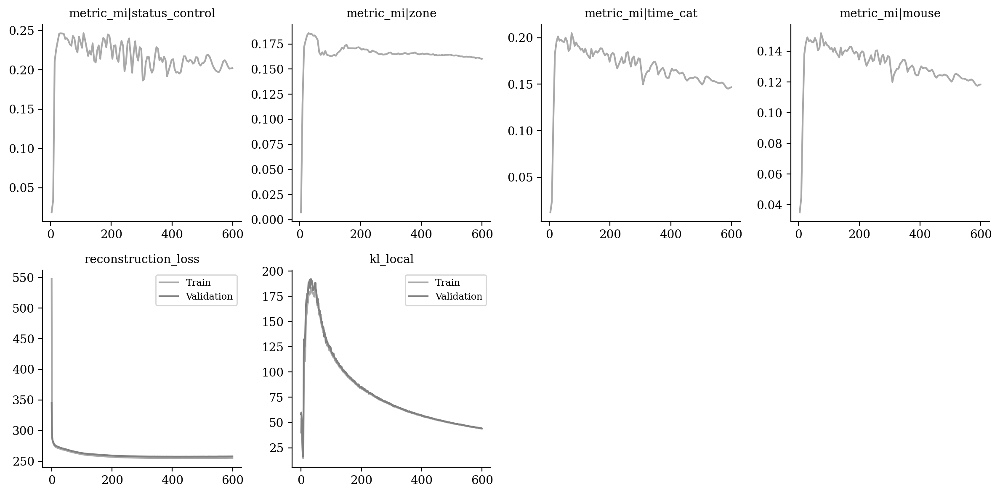

In [15]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [16]:
from tardis._disentanglementmanager import DisentanglementManager as DM

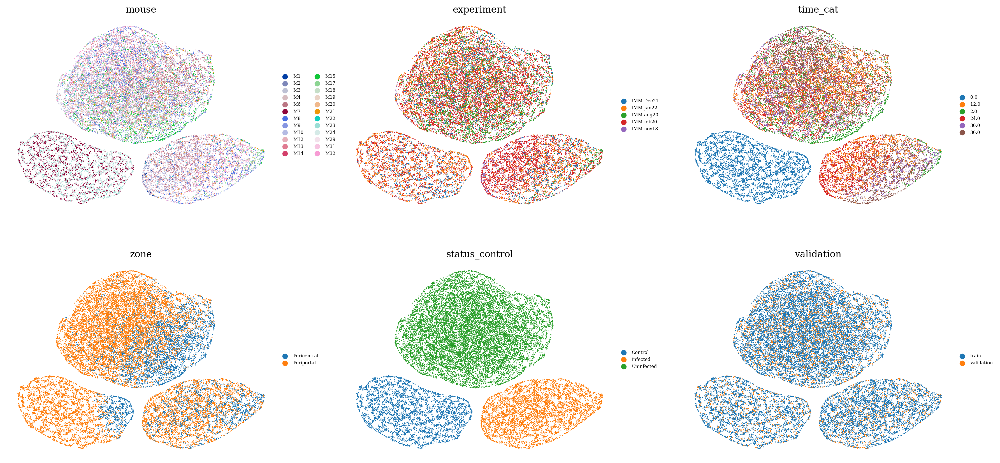

In [17]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

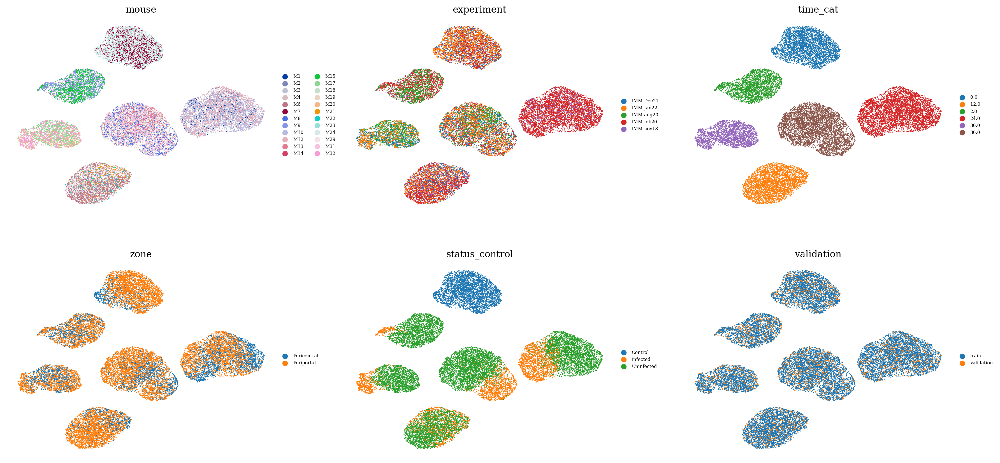

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

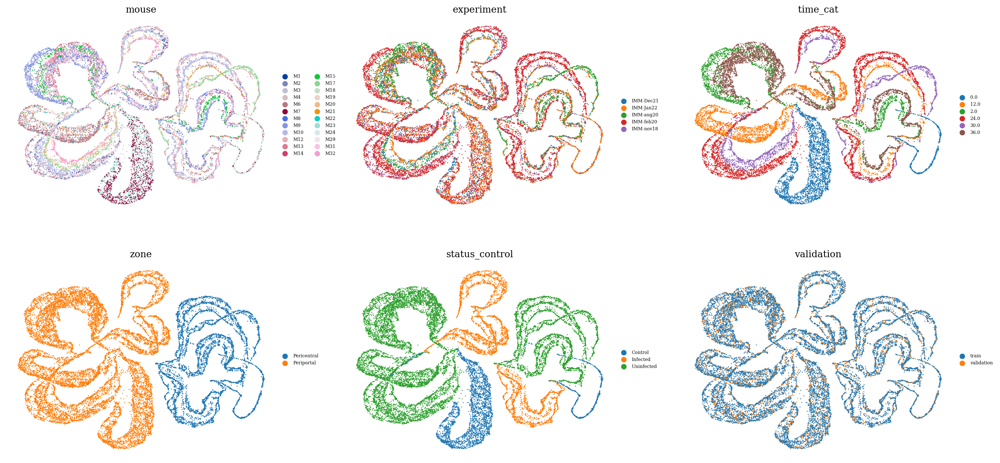

In [19]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

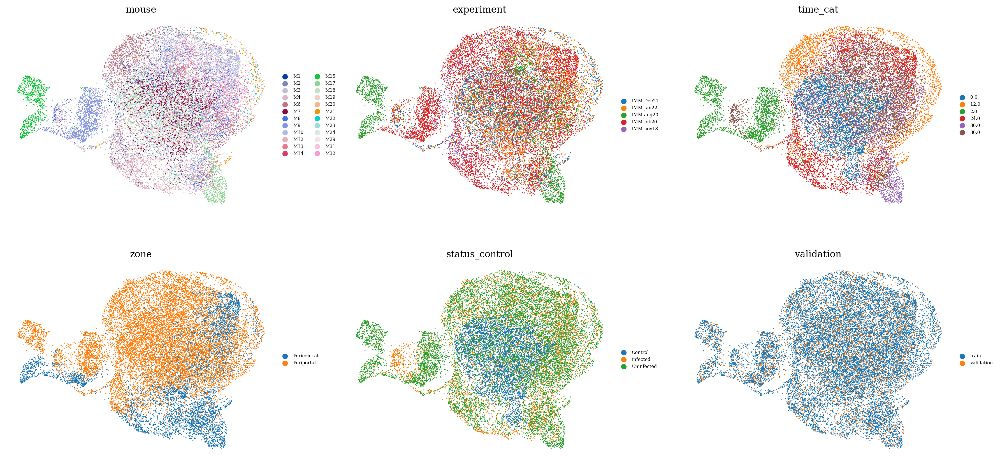

In [20]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

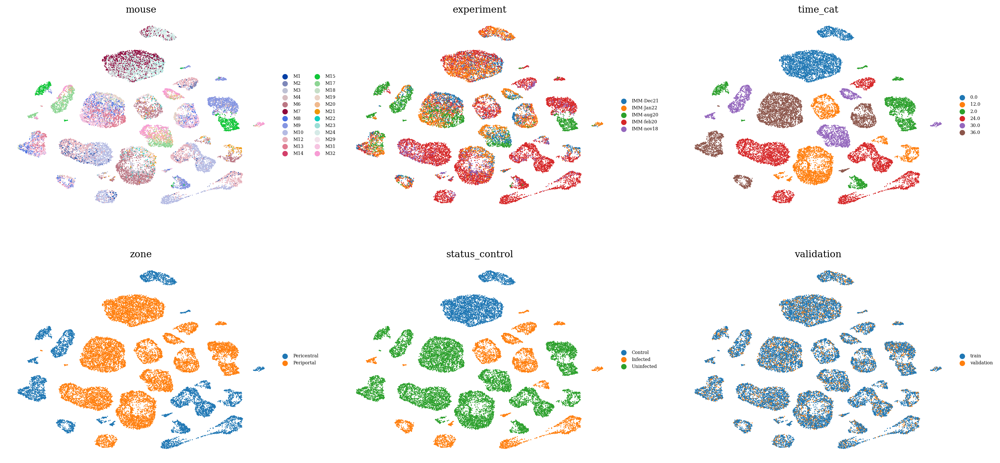

In [21]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8476950712774626

In [23]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.7998259124160683

In [24]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9983878286540249,
 ('validation', 'unreserved'): 0.14347773285301996,
 ('train', 'reserved'): 0.9955775240039211,
 ('train', 'unreserved'): 0.09541384026774925}

In [25]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.9834114456832179,
 ('validation', 'unreserved'): 0.2458762257142503,
 ('train', 'reserved'): 0.9830880109297347,
 ('train', 'unreserved'): 0.1936777775871456}

In [26]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9636015479732967,
 ('validation', 'unreserved'): 0.22487614610428458,
 ('train', 'reserved'): 0.9642645521359131,
 ('train', 'unreserved'): 0.15105995666844044}